In [1]:
import brotli   # EDIT = internet suggested this as an accompying package for Usmap
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from collections import Counter, defaultdict

from datetime import date
import time

##### STATS
import random
import scipy
from scipy import stats

# For heatmap generation
import folium
import json
import Usmap
from Usmap import Usmap
from folium import plugins

# for nlp
import string
import html
import regex as re

import nltk
from nltk.corpus import stopwords
from string import punctuation

In [2]:
mylist = [' aching ', '.coli ', ' cramp', ' cramps', ' cramping ', ' crampy ',
          ' diarrhea ', ' fever ', ' feverish ', ' gastrointestinal ',
          ' heartbeat ', ' ill ', ' illness ', ' nausea ', ' nauseous ', 'N/V ',
          'N/V/D', ' poison', ' poisoning ', ' posing ', ' queasy ',
          ' salmonella ', ' stomach ', ' sick ', ' sickened ', ' stomach ',
          ' stomachache ', ' stomach-ache ', ' stomach ache ', ' the runs ',
          ' throw up ', ' threw up ', ' tummy ', ' vomit ', ' vomiting ', ' vomited ']


sick_words = '|'.join(mylist)
sick_words

business_type = ['Fast Food', 'Burgers', 'Sandwiches', 'Delis', 'Restaurants']
pattern2 = '|'.join(business_type)
pattern2

'Fast Food|Burgers|Sandwiches|Delis|Restaurants'

In [3]:
# Read in the review and business files

business_pickle = pd.read_pickle('C:/Users/drzag/anaconda3/Yelp/dfb.pk1')         #EDIT = new line to read MZ data from pickle

review_pickle = pd.read_pickle('C:/Users/drzag/anaconda3/Yelp/dfr.pk1')       #EDIT = new line to read MZ data from pickle

In [5]:
business = business_pickle
review = review_pickle

In [6]:
business.head(5)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


In [7]:
print(len(review))
review.head(1)

6990280


,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11


In [8]:
labeled_data = pd.read_csv('C:/Users/drzag/anaconda3/Yelp/chipo_ill3.csv')
print(labeled_data[0:1])
old_index = labeled_data['old_index'].to_list()
actually_sick = labeled_data['actually_sick'].to_list()
old_index
actually_sick
dictionary = dict(zip(old_index, actually_sick))
print(dictionary)
review['actually_sick'] = review.index.map(dictionary)
review

   old_index  mention_keyword  actually_sick
0         93                0              0
{93: 0, 993: 0, 1230: 0, 1629: 0, 2757: 0, 3195: 0, 3859: 0, 4996: 0, 7820: 0, 8098: 0, 8595: 0, 9827: 0, 10063: 0, 10453: 1, 10886: 0, 11633: 0, 12468: 0, 12597: 0, 12791: 0, 13311: 0, 13693: 0, 13931: 0, 16060: 0, 16105: 0, 16654: 0, 17140: 0, 17214: 0, 17446: 0, 17951: 0, 18514: 0, 19326: 0, 19559: 0, 19687: 0, 19783: 1, 20240: 0, 20756: 1, 20925: 0, 20972: 0, 21689: 0, 22226: 0, 22706: 0, 22732: 0, 23995: 0, 24388: 0, 25695: 0, 26168: 0, 29149: 0, 29833: 0, 30107: 0, 30297: 0, 30701: 0, 30849: 0, 31984: 0, 31995: 0, 32636: 0, 33125: 0, 33150: 0, 33282: 0, 33475: 0, 33620: 0, 33630: 0, 33948: 0, 34122: 0, 36783: 0, 37159: 0, 37763: 0, 38178: 0, 38993: 0, 39352: 0, 41068: 0, 41725: 0, 41812: 0, 42193: 0, 43215: 0, 43492: 0, 43902: 0, 46813: 0, 48260: 0, 48811: 0, 48943: 0, 49029: 0, 49370: 0, 49479: 0, 50427: 0, 50572: 0, 50799: 0, 51729: 0, 52791: 0, 52925: 0, 52934: 0, 52993: 0, 53442: 0, 5357

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,actually_sick
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,NaN
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,NaN
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,NaN
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,NaN
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,NaN
...,...,...,...,...,...,...,...,...,...,...
6990275,H0RIamZu0B0Ei0P4aeh3sQ,qskILQ3k0I_qcCMI-k6_QQ,jals67o91gcrD4DC81Vk6w,5,1,2,1,Latest addition to services from ICCU is Apple...,2014-12-17 21:45:20,NaN
6990276,shTPgbgdwTHSuU67mGCmZQ,Zo0th2m8Ez4gLSbHftiQvg,2vLksaMmSEcGbjI5gywpZA,5,2,1,2,"This spot offers a great, affordable east week...",2021-03-31 16:55:10,NaN
6990277,YNfNhgZlaaCO5Q_YJR4rEw,mm6E4FbCMwJmb7kPDZ5v2Q,R1khUUxidqfaJmcpmGd4aw,4,1,0,0,This Home Depot won me over when I needed to g...,2019-12-30 03:56:30,NaN
6990278,i-I4ZOhoX70Nw5H0FwrQUA,YwAMC-jvZ1fvEUum6QkEkw,Rr9kKArrMhSLVE9a53q-aA,5,1,0,0,For when I'm feeling like ignoring my calorie-...,2022-01-19 18:59:27,NaN


In [9]:
# user.head(4)

match latitude and longitude "points" to and array of income

In [10]:
US_Income_Kaggle = pd.read_csv(r'C:/Users/drzag/anaconda3/Yelp/US_Income_Kaggle.csv', encoding = "ISO-8859-1")
US_Income_Kaggle

,id,State_Code,State_Name,State_ab,County,City,Place,Type,Primary,Zip_Code,Area_Code,ALand,AWater,Lat,Lon,Mean,Median,Stdev,Households
0,101901,1,Alabama,AL,Chambers County,Wadley,Abanda,CDP,place,36276,256,7764034,34284,33.091627,-85.527029,14596.666483,11326,10911.1105596114+0i,52
1,101903,1,Alabama,AL,Jefferson County,Adamsville,Adamsville city,City,place,35005,205,65064935,29719,33.605750,-86.974650,95877.022049,85644,101255.628258487+0i,1704
2,101905,1,Alabama,AL,Hale County,Akron,Akron,Town,place,35541,205,1776164,13849,32.879495,-87.741679,25388.782786,20009,24839.9829145421+0i,126
3,101907,1,Alabama,AL,Marshall County,Albertville,Albertville city,City,place,35950,256,68731806,258708,34.263130,-86.210660,100168.627948,85168,113147.596969836+0i,7307
4,101909,1,Alabama,AL,Calhoun County,Alexandria,Alexandria,CDP,place,36250,256,28834974,33099,33.760819,-85.872008,93216.541355,92686,92828.3528811165+0i,1464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15458,5601427,56,Wyoming,WY,Platte County,Wheatland,Westview Circle,CDP,place,82201,307,5957495,95771,42.061641,-105.067580,5374.842521,5278,9547.98844190869+0i,45
15459,5601429,56,Wyoming,WY,Platte County,Wheatland,Whiting,CDP,place,82201,307,3001056,0,42.008880,-104.971051,80534.288551,250000,0+100128.088463825i,77
15460,5601431,56,Wyoming,WY,Albany County,Laramie,Woods Landing-Jelm,CDP,place,82070,307,43264735,0,41.101461,-106.028802,44717.529876,300000,47205.3491820729+0i,28
15461,5601433,56,Wyoming,WY,Campbell County,Wright,Wright,Town,place,82732,307,7388298,0,43.748514,-105.496241,121016.826443,98262,124733.656407997+0i,791


In [11]:
points_Kaggle_array = US_Income_Kaggle.iloc[:,[13,14]].to_numpy()
print(type(points_Kaggle_array))
print(len(points_Kaggle_array))
points_Kaggle_array

<class 'numpy.ndarray'>
15463


array([[  33.091627,  -85.527029],
       [  33.60575 ,  -86.97465 ],
       [  32.879495,  -87.741679],
       ...,
       [  41.101461, -106.028802],
       [  43.748514, -105.496241],
       [  42.035162, -104.922969]])

In [12]:
income_Kaggle_array = US_Income_Kaggle.iloc[:,[16]].to_numpy()
print(type(income_Kaggle_array))
print(len(income_Kaggle_array))
print(income_Kaggle_array)

income_Kaggle_df = US_Income_Kaggle[['Median']]
print(type(income_Kaggle_df))
print(len(income_Kaggle_df))
income_Kaggle_df

<class 'numpy.ndarray'>
15463
[[ 11326]
 [ 85644]
 [ 20009]
 ...
 [300000]
 [ 98262]
 [300000]]
<class 'pandas.core.frame.DataFrame'>
15463


,Median
0,11326
1,85644
2,20009
3,85168
4,92686
...,...
15458,5278
15459,250000
15460,300000
15461,98262


In [13]:
points_Yelp_array = business.iloc[:,[6,7]].to_numpy()
points_Yelp_list = points_Yelp_array.tolist()
print(type(points_Yelp_list))
print(len(points_Yelp_list))
points_Yelp_list

<class 'list'>
150346


[[34.4266787, -119.7111968],
 [38.551126, -90.335695],
 [32.223236, -110.880452],
 [39.9555052, -75.1555641],
 [40.3381827, -75.4716585],
 [36.269593, -87.058943],
 [38.627695, -90.340465],
 [27.76659, -82.732983],
 [38.5651648, -90.3210868],
 [36.2081024, -86.7681696],
 [28.1904587953, -82.4573802199],
 [27.9552692, -82.4563199],
 [39.6371332838, -86.127217412],
 [27.966235, -82.787412],
 [27.9161159, -82.7604608],
 [39.953949, -75.1432262],
 [32.2298719, -110.9723419],
 [29.9414679565, -90.129952757],
 [29.981183, -90.2540123],
 [39.943223, -75.162568],
 [53.5460453, -113.4991693],
 [39.91382, -86.105739],
 [39.9043203184, -86.0530799],
 [39.4761165, -119.7893392],
 [36.2485696, -86.7199857],
 [40.2734926, -74.987496],
 [34.4202089255, -119.7004597389],
 [36.1598858, -86.7731974],
 [39.9398245705, -75.1574465632],
 [36.4647467622, -86.6591868908],
 [43.6167635, -116.2853821],
 [40.0224662, -75.218314],
 [40.0415845065, -75.4849526577],
 [40.0067071, -75.289671],
 [29.951359, -90.0646

In [14]:
def do_kdtree(points_Kaggle_array,points_Yelp_list):
    mytree = scipy.spatial.cKDTree(points_Kaggle_array)
    dist, indexes = mytree.query(points_Yelp_list)
    print(type(indexes))
    print(indexes)
    return indexes

start = time.time()
results2 = do_kdtree(points_Kaggle_array,points_Yelp_list)
print(len(results2))
index_list = results2.tolist()
print(index_list)
end = time.time()
print('Completed in: ',end-start)

<class 'numpy.ndarray'>
[1674 7209  978 ... 4586 3869 2132]
150346
[1674, 7209, 978, 11833, 12104, 12845, 6991, 2512, 7469, 12695, 2347, 2526, 4713, 2273, 2348, 11833, 842, 5425, 5399, 11833, 7757, 4646, 4586, 9356, 12761, 11779, 1674, 12695, 11833, 12908, 3583, 11752, 11815, 11244, 5619, 11833, 11470, 2086, 3869, 9356, 4714, 3676, 8872, 11752, 11995, 959, 7757, 12695, 3717, 11752, 2489, 4646, 7757, 7757, 2526, 12013, 978, 11846, 2190, 2526, 5497, 4586, 4646, 2526, 11470, 5619, 3613, 978, 4646, 2146, 9340, 12753, 2116, 9071, 2143, 11522, 11377, 7757, 978, 2445, 4586, 4646, 11377, 11394, 11890, 1674, 4093, 5497, 8814, 12695, 4430, 1674, 4434, 2526, 11394, 6991, 5619, 9356, 3613, 3867, 8826, 4646, 4326, 5619, 2116, 805, 2512, 11359, 11315, 12092, 7300, 8825, 3862, 3613, 2295, 8964, 2489, 11846, 5508, 12702, 1674, 978, 12702, 11833, 4714, 978, 842, 5508, 2526, 8823, 11833, 5497, 978, 4470, 4447, 11846, 2347, 842, 12695, 4646, 2526, 1674, 11833, 8826, 4713, 9356, 2489, 9356, 4713, 11833, 4

In [15]:
#get index_list rows from income_Kaggle_df

business_income = income_Kaggle_df.iloc[index_list]
len(business_income)
business_income

,Median
1674,300000
7209,96468
978,80780
11833,94488
12104,204132
...,...
7757,250000
12695,87820
4586,94228
3869,142662


In [16]:
business = pd.concat([business.reset_index(drop=True), business_income.reset_index(drop=True)], axis=1)
business

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Median
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None,300000
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ...",96468
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ...",80780
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ...",94488
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2...",204132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150341,IUQopTMmYQG-qRtBk-8QnA,Binh's Nails,3388 Gateway Blvd,Edmonton,AB,T6J 5H2,53.468419,-113.492054,3.0,13,1,"{'ByAppointmentOnly': 'False', 'RestaurantsPri...","Nail Salons, Beauty & Spas","{'Monday': '10:0-19:30', 'Tuesday': '10:0-19:3...",250000
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,TN,37204,36.115118,-86.766925,4.0,5,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Monday': '9:30-17:30', 'Tuesday': '9:30-17:3...",87820
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,IN,46250,39.908707,-86.065088,3.5,8,1,"{'RestaurantsPriceRange2': '1', 'BusinessAccep...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None,94228
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,IL,62025,38.782351,-89.950558,4.0,24,1,"{'BusinessParking': '{'garage': False, 'street...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Monday': '9:0-20:0', 'Tuesday': '9:0-20:0', ...",142662


In [17]:
business_sawmill = business[business['address'].str.contains("sawmill")]
#business_sawmill_chip = business_sawmill[business_sawmill['name'].str.contains("Chipotle")]

In [18]:
business_sawmill_chip = business_sawmill[business_sawmill['name'].isin(['Chipotle Mexican Grill'])]

In [19]:
business_sawmill_chip

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Median


In [20]:
# Drop unnecessary columns
business = business.drop(columns=['postal_code', 'attributes', 'hours'])  # 'address'

## Filter df on at least 30 stores

In [21]:
pd.options.display.max_rows
pd.set_option("display.max_rows", None)

Starbucks                              724
McDonald's                             703
Dunkin'                                510
Subway                                 459
Taco Bell                              365
Burger King                            338
Wendy's                                331
Domino's Pizza                         295
Pizza Hut                              272
Papa John's Pizza                      196
Jimmy John's                           175
KFC                                    171
Chick-fil-A                            162
Popeyes Louisiana Kitchen              159
Chipotle Mexican Grill                 156
Panera Bread                           117
Panda Express                          115
Sonic Drive-In                         113
IHOP                                   112
Applebee's Grill + Bar                 112
Waffle House                           107
Five Guys                               92
Jersey Mike's Subs                      92
Steak ’n Sh

<AxesSubplot:>

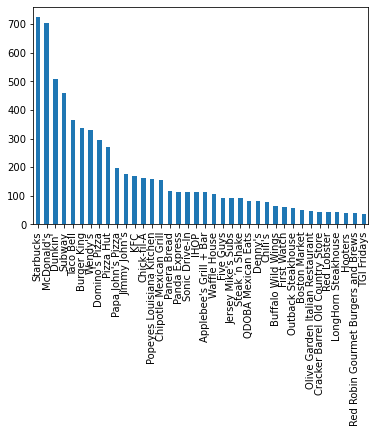

In [22]:
threshold = 30
rthreshold = 2500
added_chain = ["Panda Express", "Boston Market", "Golden Corral"]
#for col in df:
#counts = business[['name', 'review_count']].value_counts().reset_index()
#counts = counts.to_frame()
counts = business['name'].value_counts()
rcounts = business.groupby(['name'])['review_count'].sum().sort_values(ascending=False)

#business = business.loc[(business['name'].isin(counts[counts > threshold].index)) &
#                        (business['name'].isin(rcounts[rcounts > rthreshold].index)), :]

business = business.loc[(  (  (business['name'].isin(counts[counts > threshold].index)) &
                        (business['name'].isin(rcounts[rcounts > rthreshold].index))  ) |
                        (business['name'].isin(added_chain)  )   ), :]

chain_name_list = ["Starbucks", "McDonald's", "Dunkin'", "Subway", "Taco Bell", "Burger King",
                   "Wendy's", "Domino's Pizza", "Pizza Hut", "Papa John's Pizza", 
                   "Jimmy John's", "KFC", "Chick-fil-A", "Popeyes Louisiana Kitchen", 
                   "Chipotle Mexican Grill", "Panera Bread", "Panda Express",
                   "Sonic Drive-In", "IHOP", "Applebee's Grill + Bar", "Waffle House", 
                   "Five Guys", "Jersey Mike's Subs", "Steak ’n Shake", "Denny's", 
                   "QDOBA Mexican Eats", "Chili's", "Buffalo Wild Wings", "First Watch",
                   "Outback Steakhouse", "Olive Garden Italian Restaurant",
                   "Cracker Barrel Old Country Store", "Red Lobster", 
                   "LongHorn Steakhouse", "Hooters", "Red Robin Gourmet Burgers and Brews",
                   "Panda Express", "Boston Market", "TGI Fridays"]

business = business.loc[business['name'].isin(chain_name_list), :]
#business = business[business['name'].isin(chain_name_list)]

print(business['name'].value_counts())
business['name'].value_counts().plot(kind = 'bar')

In [23]:
business.groupby(['name'])['review_count'].sum().sort_values(ascending=False)

name
Starbucks                              20692
McDonald's                             17359
Dunkin'                                 9864
Chipotle Mexican Grill                  9383
First Watch                             8921
Taco Bell                               8325
Chick-fil-A                             8004
Panera Bread                            7246
Buffalo Wild Wings                      7088
Domino's Pizza                          6291
Chili's                                 6285
IHOP                                    6269
Steak ’n Shake                          6207
Wendy's                                 6164
Applebee's Grill + Bar                  5940
Outback Steakhouse                      5847
Burger King                             5255
Olive Garden Italian Restaurant         5080
Popeyes Louisiana Kitchen               4976
Pizza Hut                               4588
Red Robin Gourmet Burgers and Brews     4586
Jimmy John's                            4433
Five 

In [24]:
pd.set_option("display.max_rows", 60)

## Filter df for one chain and prepare

In [25]:
def chain_EDA(chain_name):
    chain_locs = business[business['name'].isin([chain_name])]
    #chain_locs = business[business['name'].str.contains(chain_name)]  # changed to the line above
    chain_locs_list = chain_locs['business_id'].tolist()
    #print("Number of outlets = + len(chain_locs_list)"  )
    chain_reviews = review[review['business_id'].isin(chain_locs_list)]
    
    #MODIFY DATAFRAME: KEEP ONLY REVIEWS WITH A SPECIFIC WORD SUCH AS "LOCATION"
    no_loc_reviews = len(chain_reviews)
    #chain_reviews = chain_reviews[chain_reviews['text'].str.contains("location")]
    loc_reviews = len(chain_reviews)
    proportion_with_string = loc_reviews/no_loc_reviews
    print("The proportion with selected string:\n{}\n".format(proportion_with_string))
    
    
    chain_mention_keyword = chain_reviews.text.str.contains(sick_words)
    
    chain_reviews['text'].str.lower()
    chain_reviews = chain_reviews.assign(mention_keyword = chain_mention_keyword)
    chain_reviews = chain_reviews.astype({"mention_keyword" : int})
    chain_reviews = chain_reviews.merge(chain_locs[["state", "latitude", "longitude", "business_id", "name", "Median"]],
                                            how='left',
                                            on='business_id')
    chain_reviews['date'] = pd.to_datetime(chain_reviews["date"])
    chain_reviews['day_date'] = pd.to_datetime(chain_reviews["date"]).dt.date
    chain_reviews['year'] = chain_reviews['date'].dt.year
    chain_reviews['quarter'] = chain_reviews['date'].dt.quarter
    chain_reviews['month'] = chain_reviews['date'].dt.month
    
    # CALCULATE AND PRINT CORRELATION BETWEEN STAR RATINGS AND MENTIONING ILLNESS
    # KENDALL TAU IS FOR ORDINAL DATA

    #corr_stars_sick = scipy.stats.kendalltau(chain_reviews['stars'], chain_reviews['mention_keyword'])

    corr_median_sick = scipy.stats.pointbiserialr(chain_reviews['mention_keyword'], chain_reviews['Median'])
    # the binary comes first in the list for this test
    print("The correlation between stars and illness is:\n{}".format(corr_median_sick))   
    
    print(chain_reviews)
    print(chain_reviews['actually_sick'].sum())
    print(chain_reviews['mention_keyword'].sum())
    return chain_reviews #, loc_percent

def plot_illness_series(chain_reviews):
    chain_crosstab_sick = pd.crosstab(chain_reviews.day_date, chain_reviews.mention_keyword)
    #lineplot = chain_crosstab_sick.plot.line(figsize=(50, 10))
    return chain_crosstab_sick.plot.line(figsize=(50, 10))

def percent_ill(chain_reviews):
    print(chain_reviews['mention_keyword'].sum()/len(chain_reviews['mention_keyword'])   )
    
def illness_grouped(chain_reviews):
    chain_grouped = chain_reviews.groupby(['business_id'])['mention_keyword'].sum().reset_index()
    chain_grouped = chain_grouped.sort_values(by = ['mention_keyword'], ascending=False)
    import seaborn as sns
    import matplotlib.pyplot as plt
    sns.barplot(x = 'business_id',y = 'mention_keyword',data = chain_grouped)
    return plt.show()

def illness_random(chain_reviews):
    chain_reviews = chain_reviews.astype({"mention_keyword" : str})
    message = chain_reviews["mention_keyword"]
    message1 = message.str.cat(sep='')
    print(message1.count("00"))
    print(message1.count("11"))
    print(message1.count("01"))
    print(message1.count("10"))
    from statsmodels.sandbox.stats.runs import runstest_1samp 
    data = chain_reviews['mention_keyword'].tolist()
    print(runstest_1samp(data, correction=False)   )


Chipotle Mexican Grill
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.01266711927735485, pvalue=0.21075162840475112)
                   review_id                 user_id             business_id  \
0     onlgwy5qGDEzddsrnIvtWg  pYXeL0RCqus2IfhthYCOyA  W7NxQw8UYFR0HLPrI08tvw   
1     V8dVnEHMdDNxCX6yFFam2Q  HjMKmLryj5emWPXcpBvt6Q  L7i_5DydYEKwPLfcDBRYDA   
2     -xvk0ycCuDVq4qEalW2yCQ  9C48_ifO4fXBiHsfXebb1w  C3Nc7EUqo64jRPWPn6vY9w   
3     Ws1qBFGyxa-vnkUUnTd7uw  yJRFIA3-JOjOxLloejG1Jg  iAP8eZ847uCHLS-r81jUFg   
4     batVbBszzQuw3LNR10pETw  BrhwZCoV-kd5JbV8G6gHLw  AmnnsJq4Pz1jJUFzHwtsOA   
...                      ...                     ...                     ...   
9758  C9JZlLiLTdL5XIPlFgBofA  BPAvbCjrf7xkGlYyuOd0sA  9X_Sh8wiS1oiXq1klrJmxw   
9759  ETiOMt5X2DcasfiJVe60_w  2C8wxBF5uwcSYnV5LURDcA  Un6UO11mgLC6oRgozaJAKw   
9760  d15JKLZ4lh5UnZ63kLzs3A  Y-fPeP9dmciMYg83esNSWw  IZuborFfCX6E6CVDWorHnw   
9761  

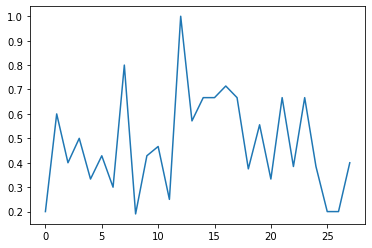

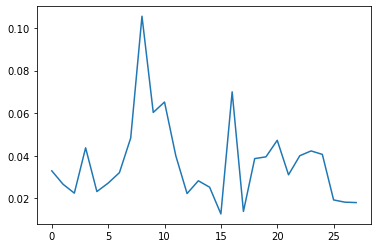

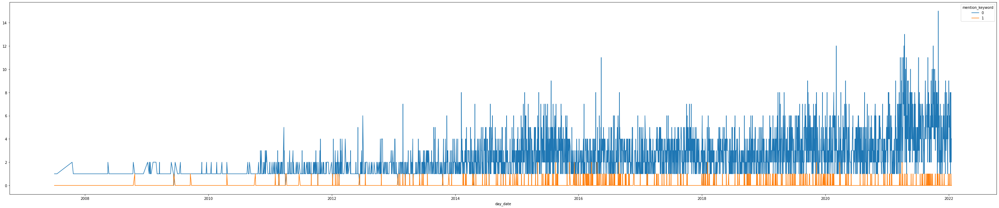

0.032776810406637304


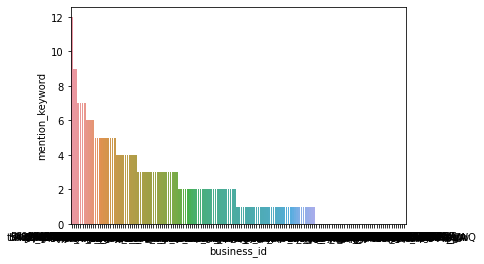

4636
15
305
305
(-1.4413090778599862, 0.14949738381957037)
mention_keyword     0    1
stars                     
1                3923  203
2                1464   38
3                1063   35
4                1380   26
5                1613   18


In [26]:
chain_name_list_short = ["Chipotle Mexican Grill"]
for name in chain_name_list_short:
    print(name)
    name_reviews = chain_EDA(name)
    
    #########################################
    
    df_2014 = name_reviews.loc[name_reviews['year'] == 2014, :]
    df_2014_calc =  pd.DataFrame(  df_2014.groupby('quarter')['text'].count()  )
    df_2014_calc['mention_keyword'] = df_2014.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2014_calc['actually_sick'] = df_2014.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2015 = name_reviews.loc[name_reviews['year'] == 2015, :]
    df_2015_calc =  pd.DataFrame(  df_2015.groupby('quarter')['text'].count()  )
    df_2015_calc['mention_keyword'] = df_2015.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2015_calc['actually_sick'] = df_2015.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2016 = name_reviews.loc[name_reviews['year'] == 2016, :]
    df_2016_calc =  pd.DataFrame(  df_2016.groupby('quarter')['text'].count()  )
    df_2016_calc['mention_keyword'] = df_2016.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2016_calc['actually_sick'] = df_2016.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2017 = name_reviews.loc[name_reviews['year'] == 2017, :]
    df_2017_calc =  pd.DataFrame(  df_2017.groupby('quarter')['text'].count()  )
    df_2017_calc['mention_keyword'] = df_2017.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2017_calc['actually_sick'] = df_2017.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2018 = name_reviews.loc[name_reviews['year'] == 2018, :]
    df_2018_calc =  pd.DataFrame(  df_2018.groupby('quarter')['text'].count()  )
    df_2018_calc['mention_keyword'] = df_2018.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2018_calc['actually_sick'] = df_2018.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2019 = name_reviews.loc[name_reviews['year'] == 2019, :]
    df_2019_calc =  pd.DataFrame(  df_2019.groupby('quarter')['text'].count()  )
    df_2019_calc['mention_keyword'] = df_2019.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2019_calc['actually_sick'] = df_2019.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2020 = name_reviews.loc[name_reviews['year'] == 2020, :]
    df_2020_calc =  pd.DataFrame(  df_2020.groupby('quarter')['text'].count()  )
    df_2020_calc['mention_keyword'] = df_2020.groupby('quarter')['mention_keyword'].sum()[0:]
    df_2020_calc['actually_sick'] = df_2020.groupby('quarter')['actually_sick'].sum()[0:]
    
    df_2014_2020_calc = pd.concat([df_2014_calc, df_2015_calc,
                                  df_2016_calc, df_2017_calc,
                                  df_2018_calc, df_2019_calc,
                                  df_2020_calc], axis=0, ignore_index = True)

    print("Dataframe")
    df_2014_2020_calc['sick_ratio'] = df_2014_2020_calc['actually_sick']/df_2014_2020_calc['mention_keyword']
    df_2014_2020_calc['mention_ratio'] = df_2014_2020_calc['mention_keyword']/df_2014_2020_calc['text']
    print(  df_2014_2020_calc  )
    
    s = pd.Series(df_2014_2020_calc['sick_ratio'])
    plt.show(s.plot.line())
    
    m = pd.Series(df_2014_2020_calc['mention_ratio'])
    plt.show(m.plot.line())
    
    ##########################################
    
    plt.show(plot_illness_series(name_reviews))
    percent_ill(name_reviews)
    illness_grouped(name_reviews)
    illness_random(name_reviews)
    
    print( pd.crosstab(name_reviews['stars'], name_reviews['mention_keyword']) )

<AxesSubplot:xlabel='stars'>

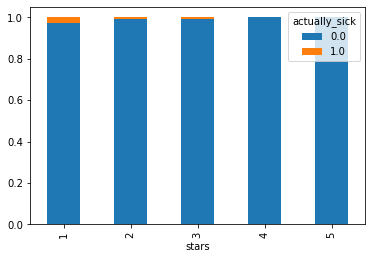

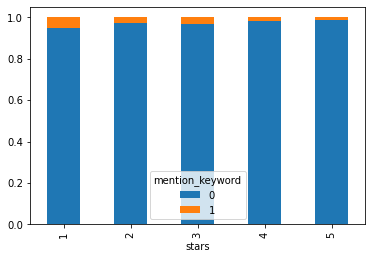

In [33]:
crosstab_02 = pd.crosstab(name_reviews['stars'], name_reviews['actually_sick'])
crosstab_norm2 = crosstab_02.div(crosstab_02.sum(1), axis = 0)
crosstab_norm2.plot(kind = 'bar', stacked = "True")

crosstab_01 = pd.crosstab(name_reviews['stars'], name_reviews['mention_keyword'])
crosstab_norm = crosstab_01.div(crosstab_01.sum(1), axis = 0)
crosstab_norm.plot(kind = 'bar', stacked = "True")

In [34]:
############## REMOVES ALL REVIEWS EXCEPT THOSE WITH "TYPICAL" KEYWORDS

name_reviews_nlp = pd.DataFrame(name_reviews, columns = ['text', 'mention_keyword'])
name_reviews_nlp = name_reviews_nlp.values.tolist()

### Apply Basic Tokenization and Cleaning using Pythonic list Comprehension

name_reviews_nlp = [[t.translate(str.maketrans('', '', string.punctuation)),p] for t, p in name_reviews_nlp]
name_reviews_nlp = [[t.lower(),p] for t, p in name_reviews_nlp]
name_reviews_nlp[0:5]

[['dont know what it is but if my tummys feeling icky i can count on chipotles stake to fix me up i just have to remember not to go during full on lunch time i usually go between 2  4 when its peaceful and calm busy or not the service is always friendly and fast',
  0],
 ['this chipotle location was great i wanted to thank chipotle for recognizing teachers for teacher appreciation week \nthe line was very small and they served quickly as a pose to another location that had the line wrapped around the store \ntheir food is always fresh tasteful and fulfilling \nmy go to is always the bowl with white cilantro lime riceblack beans steak and all the toppings \nmust eat with a bag of fresh tortilla chips',
  0],
 ['well i did visit here a year ago long before the ecoli  colliform scare so i have not been back out of concern for my health and safety darn shame too as i really did like this place but i must admit that i still am not confident they have their act in order my suggestion is they

In [35]:
word_cutoff = 5

tokens = [w for t, p in name_reviews_nlp for w in t.split()]
print(tokens[0:5])

word_dist = nltk.FreqDist(tokens)

#for w, c in word_dist.items():
#    print(w, c)

feature_words = set()

for word, count in word_dist.items() :
    if count > word_cutoff :
        feature_words.add(word)
        
print(f"With a word cutoff of {word_cutoff}, we have {len(feature_words)} features in the model.")

['dont', 'know', 'what', 'it', 'is']
With a word cutoff of 5, we have 4683 features in the model.


In [36]:
sw = stopwords.words(["english"])
def review_features(text,fw):
    #ret_list = []
    ret_dict = dict()
    #text = text.translate(str.maketrans('', '', string.punctuation))
    #text = text.lower()
    text = [text for text in text.split() if text not in (set(sw))]
    
    for token in fw:
        if token in text:
            ret_dict.update({token: 1})
        else:
            ret_dict.update({token: 0})

    return(ret_dict)

In [37]:
featuresets = [(review_features(text,feature_words), mention_keyword) for (text, mention_keyword) in name_reviews_nlp]

In [38]:
len(featuresets)

9763

In [39]:
random.seed(84)
random.shuffle(featuresets)

test_size = 2000

In [40]:
test_set, train_set = featuresets[:test_size], featuresets[test_size:]
classifier = nltk.NaiveBayesClassifier.train(train_set)
print(sorted(classifier.labels()))
#print(classifier.labels())
print(nltk.classify.accuracy(classifier, test_set))

[0, 1]
0.9205


In [41]:
print(classifier.labels())

[0, 1]


In [42]:
classifier.show_most_informative_features(100)

Most Informative Features
                 stomach = 1                   1 : 0      =    173.6 : 1.0
                    sick = 1                   1 : 0      =    125.2 : 1.0
                    woke = 1                   1 : 0      =    118.4 : 1.0
                   ecoli = 1                   1 : 0      =    100.7 : 1.0
                    ache = 1                   1 : 0      =     84.6 : 1.0
                carrying = 1                   1 : 0      =     84.6 : 1.0
                   tummy = 1                   1 : 0      =     84.6 : 1.0
               explosive = 1                   1 : 0      =     65.8 : 1.0
              screeching = 1                   1 : 0      =     65.8 : 1.0
                    coli = 1                   1 : 0      =     62.9 : 1.0
                 illness = 1                   1 : 0      =     62.0 : 1.0
                outbreak = 1                   1 : 0      =     60.4 : 1.0
                reported = 1                   1 : 0      =     60.4 : 1.0

Starbucks
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0015725135725873625, pvalue=0.817342514594039)
                    review_id                 user_id             business_id  \
0      ULzbgT5SPThiMOoo4a_Adw  veBX5roHQLNnQ1rTtNh_gg  aJvxWyQIG5OLfBw3qAe8xA   
1      RXqhxbAuPPSNs-oyJJyOgw  zZygOZLNyJX5nDqKrwa4HQ  MjZQqZAmJeMco_Vq-Y9h-g   
2      LuMkMBAUV1B-2dm2pqSBWw  0SpK7eVn5TrpyQKPaohVBw  u7MJKcNdZXYyTeb67vD5jw   
3      Z0Jt8xf0XqFD_xjPPm_d0g  IVnrNZ8npRx04jkNp6-ERA  saJFbz12EnzanelpD8_xXQ   
4      NoPOfj7gC1l48dC0XH7Spw  tgP2gKsf3O9MyuLuolv2oQ  KiE0h68HGOO7ZXAqkMBdiw   
...                       ...                     ...                     ...   
21570  Vt4zgo9wDRlNbUNds0Ttbg  QPDFn3SQqZeBu7OBI78g9w  -85kJMtb9wqNWDT8yLbitw   
21571  OrYpmKDqmc3X7g7STa3jww  F3ELBqGgDCX9YEhz_oS0xQ  Ddg-J_j0YFErk7wpMtH_0A   
21572  kB85EOTWW2Gw5-DpsyMa-g  TZJzzQsE4R7RmqkVRaLEKw  2rmpfdyV2POqpXtmPHO_IQ   
21573  fe

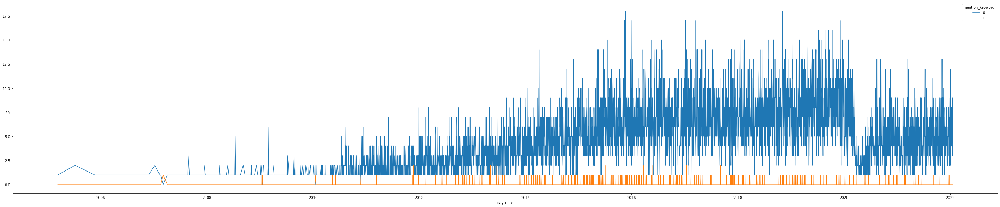

0.010753186558516802


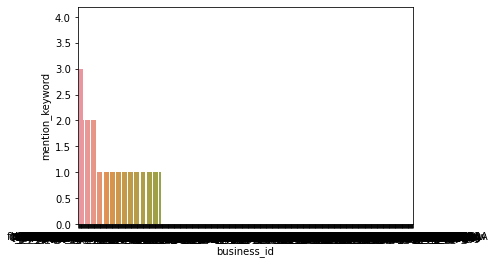

10612
4
228
228
(-0.9644018028167439, 0.3348445187343809)
mention_keyword     0   1
stars                    
1                5690  55
2                2872  41
3                2764  54
4                4170  52
5                5847  30
McDonald's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0011369271905993135, pvalue=0.8780737663669351)
                    review_id                 user_id             business_id  \
0      12WmsX0EwwDlQyGXAgtkww  xUhG4eI0M1KRvucUn0t19w  QSA-x2bb3kum9QLFpy7vUg   
1      E-yGr1OhsUBxNeUVLDVouA  MfDqmwzf1WxvJFtiRKi4Sg  kgMEBZG6rjkGeFzPaIM4MQ   
2      xRAw5A0eI-e-39c11uy4Zw  ljmDAIBee0SyVh9KtuBFdw  y0pfoNQOyrb98aEIdH6cnA   
3      lgfa_q4jisy7l7H3RwIYzw  c8XvSrb7Rj1WUMtUhf82yw  7YiLEuHuUONZrMPT0OxXUQ   
4      IEvZ_PRx5JQJ8SQ2gYskag  _Y9XioW2o0T_UBAX7hG14g  3_kZ2pDiKJLZ9kGKKOWqdA   
...                       ...                     ...                     ...   
18205  Nic

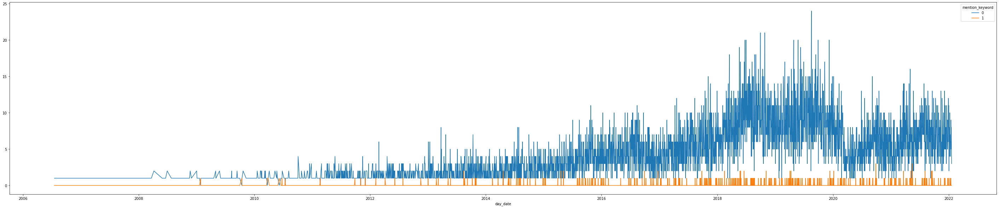

0.018451400329489293


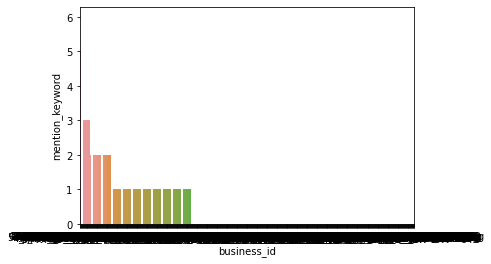

8846
5
331
331
(0.4912283309868355, 0.6232649631815816)
mention_keyword      0    1
stars                      
1                12040  280
2                 1832   21
3                 1289   11
4                 1126   15
5                 1587    9
Dunkin'
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.004493674172819939, pvalue=0.648195336236556)
                    review_id                 user_id             business_id  \
0      FER3y2U9ghI_xXU-PoN7fQ  DmDM9jxpvYRDVtXst9l2fw  H1bbYNKgk6JF9pKcBXyDXw   
1      -Pf2OfKJKBewQDU1yGuAdA  ocSmiCHL5R9bBZTBmk_ryQ  vMp55ea__Pk0fYbBDCn6jg   
2      4ubnkX74NnLUk4JRjDA5VQ  r_HYtkSGTgCOgSR-DJoPrw  -3dkEoYgH8AlUtBMZvzUfg   
3      ah0CVAemJaVLyMemei3bMg  -fNcj-eP-ztfX55vSnmX5A  nXJ1dAI-UGbXfeaI_b1abA   
4      y-eeYEo-in7RTfEmZf3PBQ  4ZoLduHgq6Q4DQLnG5X7Kw  qVVz1sRZVNH2xt865M64Dg   
...                       ...                     ...                     ...   
103

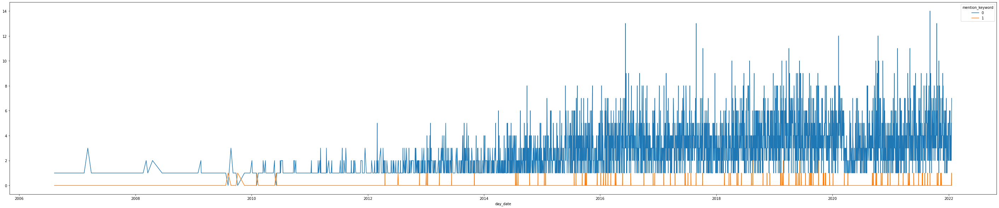

0.011442979053529869


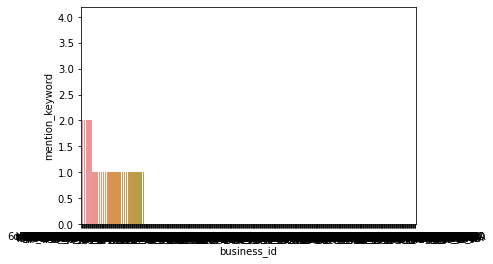

5069
2
116
116
(-0.5668019376508648, 0.5708487539918857)
mention_keyword     0   1
stars                    
1                5224  76
2                1362  18
3                 985  13
4                1084   8
5                1539   3
Subway
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009761167909264096, pvalue=0.5232968335732184)
                   review_id                 user_id             business_id  \
0     Z_tQ-hruQRU45Rg3XglyJQ  9wymgENHBBOm9Tlx7xHy7A  HZtkTPfSshfRjpQR7x1Raw   
1     40lILqNR2Wz67EC5PMW8Ug  6iNK1hUkEljpdUp8S85bwg  WaP_umj3dFLzYicrOanRBA   
2     eSF-_iS63kRrlQ8Qul_9cA  qT2W8QV0YuuUy8tUXZ8jeg  swKXtO22QjVIZTBU8UP7Pg   
3     4wNMdKSqUUzfoXv6-Q1DWQ  WisRT3bV_ed2BuabSPKyjw  EwblShAzTJ4Op6aJZYYuVA   
4     MdsSdcnMLU89IEkHxkNofg  Ug6Djz3endu6XHg7aSh9yw  BQdg19sukvw90QJ4tbY-BA   
...                      ...                     ...                     ...   
4273  i3yHahuXRxPhXI9G8

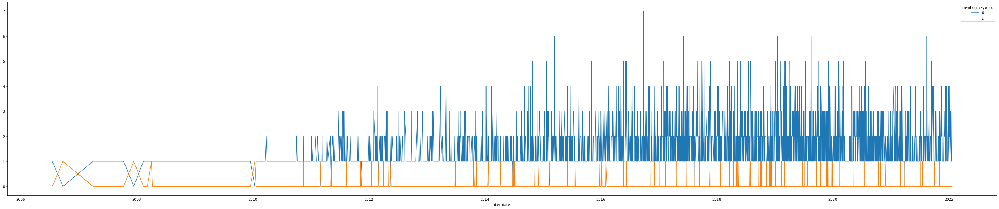

0.019869097709209912


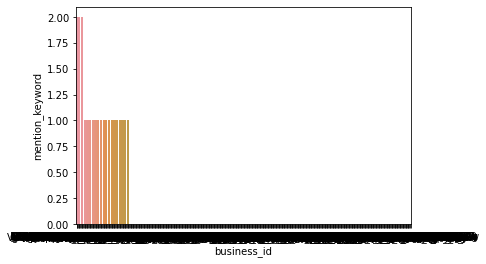

2072
1
84
84
(0.5423918186022922, 0.587548614545746)
mention_keyword     0   1
stars                    
1                1838  55
2                 487   6
3                 442   7
4                 529   9
5                 897   8
Taco Bell
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0003336598030490639, pvalue=0.9752675099232205)
                   review_id                 user_id             business_id  \
0     Ax8lbP7yYV_Ag2JwK-LorQ  EJqV61HlYmFEmzcIaRVVOw  tpSeNezanZDvsXWR7Hhi1w   
1     Um59sqw4ulhSmAfAuYwpeA  7ajfMmBJGkFU1kTur3DkkA  K_WZrMHAjqZ5DThAw4ZKMQ   
2     9O5TrnTl7OftHl2a7bQGOg  BGqAuyW767YnAQU1qOeV3g  X8k7N03buo2bBbUUfcAltQ   
3     -Xm4_Mwi3P5vfXYlOJA5tA  Zsdee1KEpMwjg5cqx-VWrQ  FZCj995CEL2G-JTiLC3Azw   
4     R3AtZ63S87-sAzAFpcia8A  1EJYgQ-ja_UbTWR_FDj4_A  fXsdsGnTntaRWbfUxP3wXw   
...                      ...                     ...                     ...   
8631  gEYRMDv_Jg0XgUUEw

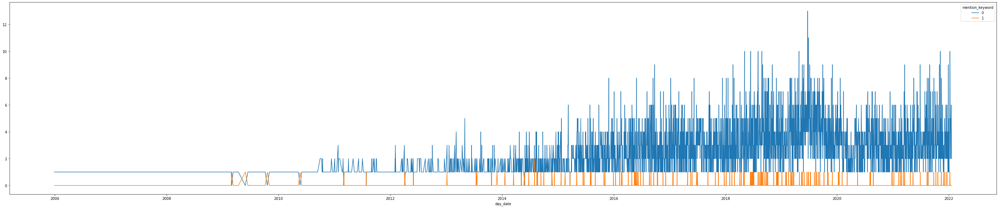

0.02014821676702177


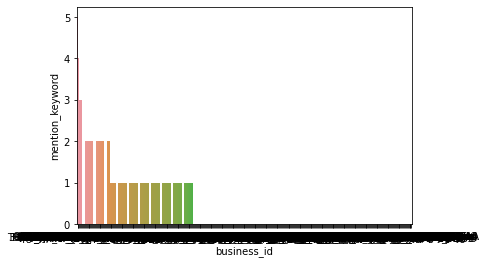

4185
7
167
167
(-1.9072530821497085, 0.05648782262025015)
mention_keyword     0    1
stars                     
1                5000  126
2                 849   19
3                 699   15
4                 717    8
5                1197    6
Burger King
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.004028397965982934, pvalue=0.7649714593814494)
                   review_id                 user_id             business_id  \
0     UZwKv27kcfZTBBiYZIKWnQ  6s5whJLSvZFIF0Am4RyjUg  baHb5T01_MnnhQFHRCR0fg   
1     HHy9yIjW07VHUE6nXVbsVA  UOV7iMHErlPc59XyJQpXuQ  LACylKxImNI29DKUQpWuHw   
2     9tb2DMVP155G2bG3YsF-1w  8474DneUCzxx_YWmJvGxTQ  bKiZJTI0-zrH7n4xM5kHcA   
3     04aDeyVDbw7TcnLnNiCoHQ  5Nyj9RARZbQuSkLOzu3HGQ  baHb5T01_MnnhQFHRCR0fg   
4     w7naLHJBrpxQYcoG-0quIQ  WcQ01IBbW0ID01EE7bdH4g  bKiZJTI0-zrH7n4xM5kHcA   
...                      ...                     ...                     ...   
5505  w8jZN

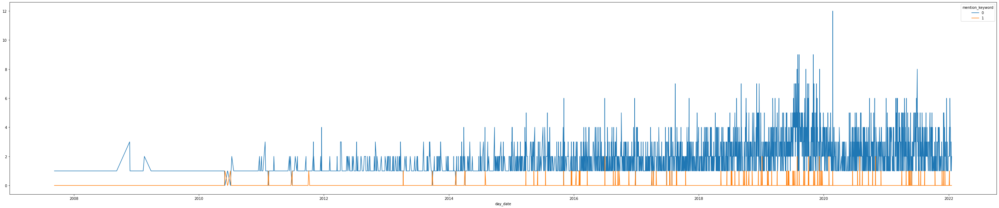

0.020508166969147007


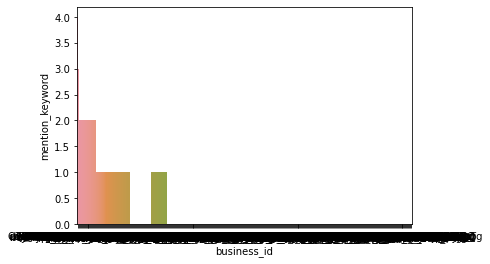

2669
3
110
110
(-0.4587668474876717, 0.6464016042977156)
mention_keyword     0   1
stars                    
1                3346  91
2                 555  12
3                 468   3
4                 443   5
5                 585   2
Wendy's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.022463932011440948, pvalue=0.07240408756260372)
                   review_id                 user_id             business_id  \
0     a32cWIjFXAuKHz1hP_kkFA  dMrmnopCJ0xxEuG7WMCtWw  _TANOcxwIOmQhk1mnXaj7w   
1     wXcsMgO27jDlr_8xuhn-pQ  CqRAt1eogaHCBBtF_shemg  ruFtZKwlJASx5BTk1dh5AQ   
2     S-uET6w58-JoA-W39G-ohA  NsMx7FwsMmylYqHcLWbU3A  qyOUMa4Ol1lFnoZZ8lN_hA   
3     FW9eB5tk1gRSzFLl_aUJcA  3Hn5PexeY0tir0uFWk4jJg  ruFtZKwlJASx5BTk1dh5AQ   
4     BThO72XIzj6tf2hRkavttw  DVaXl3U52I92HuQsw0eCqw  L5LW_wN6Z0JV_vKe2jnsBw   
...                      ...                     ...                     ...   
6392  lBorz_e4sfW90At

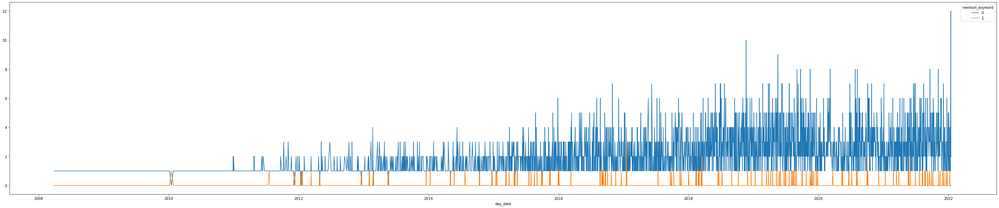

0.022041581991558545


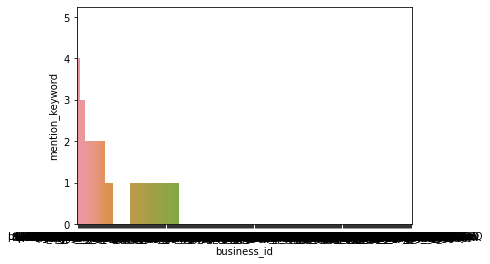

3093
3
138
138
(0.06267239297242676, 0.9500273813802215)
mention_keyword     0    1
stars                     
1                3783  115
2                 771   11
3                 550    6
4                 502    2
5                 650    7
Domino's Pizza
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.012965002243829881, pvalue=0.2945249844394991)
                   review_id                 user_id             business_id  \
0     _1rme3go3F96nwAexBZEGw  ZEpBNNP_btQrZ5qaByoZkg  LGqiubTmpJ-A1L5n7dmc6g   
1     bg3TAimbMppppLUTfN46nA  R9VOYcIWbNA3Q3qiWF2SsQ  EIlFs8kybcG-l60GJjNUIA   
2     3HCYKdFJ_PYkxFOXp8KTFw  pKEkGqMBa70fc_CM_UNySQ  QEOauqqX1vsGcJeN0FwyNw   
3     ZPABFFlF6tjTRCSKx368WQ  iSDCWxF-7UDLThmJxVZCyQ  7biQIoyOEMcBGUw106UeOQ   
4     Qprk_b5tAJ_d1nVFtxlRpA  fOU3GfTHAR0imz2huFSbvg  cwSlDlrmK1qlOWH9zDuNKQ   
...                      ...                     ...                     ...   
6534  vI

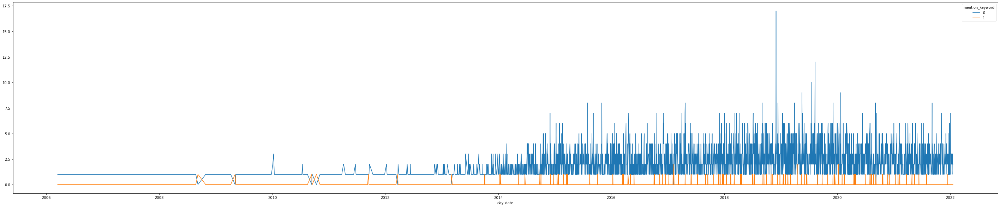

0.017128001223428658


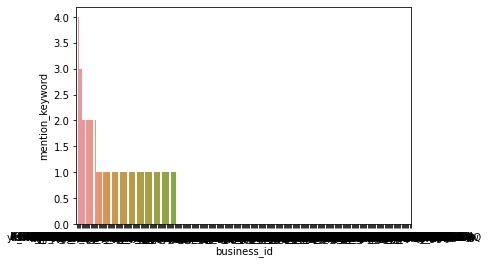

3183
3
109
109
(-0.7963213158700886, 0.4258452991143036)
mention_keyword     0   1
stars                    
1                3791  94
2                 552  11
3                 403   1
4                 588   4
5                1093   2
Pizza Hut
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.011911330325084273, pvalue=0.4103181129030674)
                   review_id                 user_id             business_id  \
0     VmVf4S6FBwOYGSzAZF_1gg  dcukhUKHv54TYJgC-B_6_A  RsTF2skxLcp6qo9FdnA5PA   
1     EZnhTxftFP8HJ-Tva_3T6A  5rVH3p45evCxca5JRNUUFg  JuiFuyPw2yjWiPpi3HXJ0Q   
2     xYULOAQKDzT8xF3RkIeu_w  xkU3TzMOVK1nnHN2sL9O-A  2kWw4GEEZdSPuTc6KV_aRA   
3     ycw5nyYS8BWAddUFS8EZFg  -dN3ww2WYLkwAbZtJHcLHQ  ttevmSPHu3dHUHFXBpVX9A   
4     XIIct3XhC6Br00CxPXteyQ  ey5tvSRod9Hsor_fw_jCEg  T8lxi3V2avTVXCanVkAFNg   
...                      ...                     ...                     ...   
4775  7mYjWlS-4xEzkca

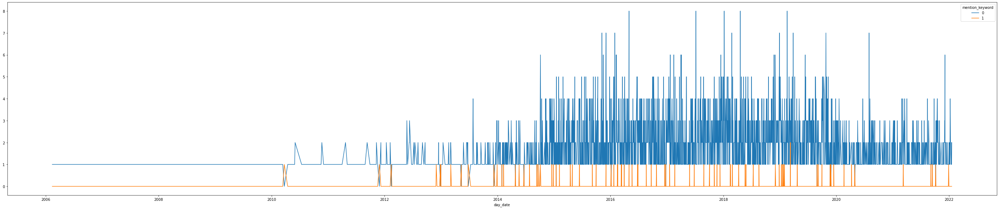

0.018200836820083683


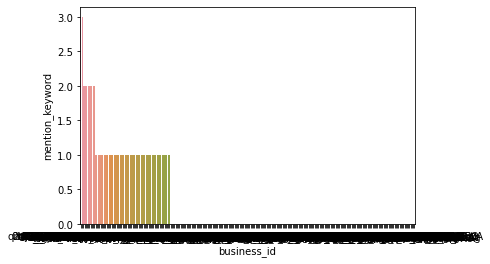

2325
2
85
85
(-0.3380997201055867, 0.7352880414599854)
mention_keyword     0   1
stars                    
1                2911  66
2                 514  14
3                 290   3
4                 416   3
5                 562   1
Papa John's Pizza
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.019226137327774093, pvalue=0.2838607524960493)
                   review_id                 user_id             business_id  \
0     6PN2cvx6cCrEXGibVmdhnw  -OCbPl8jDXA-RzGjaQdEQA  p7C2l6MyJLq9lKMmUhjqMg   
1     BwGjjLjT45OydGK2g0u4sA  MbyhVYGv2YHV5b92kzuIFg  p7C2l6MyJLq9lKMmUhjqMg   
2     Dl64LJ6faNzp_hL098-68w  P3WoQfRpKDjxoNspG-7ypw  n88rreifvghMYJVUaWMUXg   
3     WKFeVf4ssE53T4HayrADEQ  ab_ENpYvkFIEENV9jEosqQ  -e25gkrazUCBqcSdgsmHGQ   
4     8VRvqLQ15-8MACYfBlX4aQ  cRtrGYeq2aQBvkMTCUt29A  -e25gkrazUCBqcSdgsmHGQ   
...                      ...                     ...                     ...   
3104  49u1xEOd

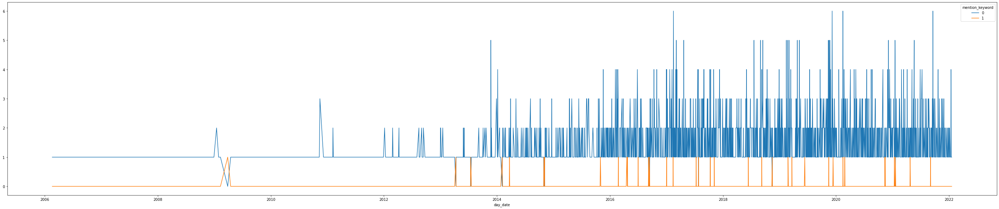

0.011579285944033452


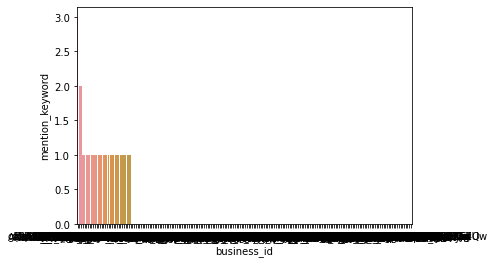

1527
0
36
36
(0.6577386331774839, 0.5107060931099427)
mention_keyword     0   1
stars                    
1                1627  22
2                 312   5
3                 225   1
4                 301   3
5                 608   5
Jimmy John's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.012724128135132379, pvalue=0.3890782810669762)
                   review_id                 user_id             business_id  \
0     Y-FxkPJQiAkgC5-WummstA  vx0Hkm2dPnawQBGCso3__w  pk7E-3G7Ij39h9HifNz0TA   
1     P2VthEuorFQa3KQmtZtTwQ  vQpf5yZJl44SCwrZmtTEqA  0wHR5cCTKdCmimhp02cQFA   
2     L4WvY8zRCnuZqG6Hx3wA7A  3VQgahanz35nWEfDDTVrUg  1wC41D8PLqOldFPUVAZ3tA   
3     WXRlzD3j0jD5aPDZJ7H1Ow  uRFHwwNyJmgkWsUdApfUkw  J3sbnmR2lgGccg8rjYPzzA   
4     ci0yPDPMU-Ca0MMK3pnZ7g  FfqnMS16PhYcXucWnIscgA  sNDXKUS14_xXdD0fJdw23g   
...                      ...                     ...                     ...   
4579  RUJv1lXPMu6Jl3F

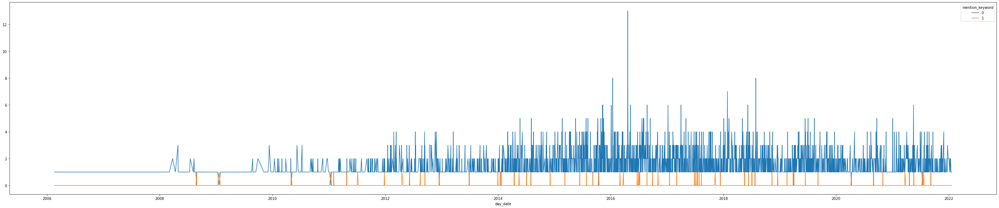

0.014397905759162303


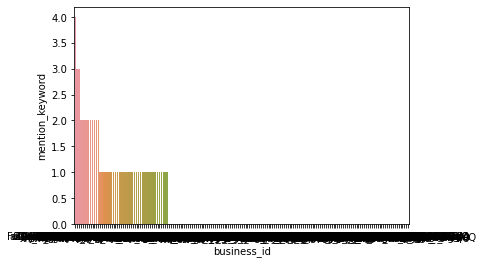

2243
1
65
65
(-0.05196311139317521, 0.9585580865271539)
mention_keyword     0   1
stars                    
1                1406  27
2                 616  10
3                 507  14
4                 851  12
5                1138   3
KFC
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.009589098172542599, pvalue=0.5955863650361845)
                   review_id                 user_id             business_id  \
0     wWD0cnmUjqFUfs6BEiDwXg  sDWEBT3IcBAqIqb6Ttlp3Q  1ol8rghO_5m0M5WFMv-C8Q   
1     22ktCUgPcosvH2RYbmQUlQ  0hYyNTbz7qxfSvuAQ_Tesg  0xe81EigRw_b5W8tg0Ca6Q   
2     7hg7Q6yvDmSKKz1JoJL9DQ  VG-toQE2YcjDlmgvLni2ew  1ol8rghO_5m0M5WFMv-C8Q   
3     YGeKk1hEAu87_jvYdoCSSQ  5YunAjG2P9GA6XTJPosbBw  cLY7TxgdJCiGrD2C8DMEew   
4     D2VvAZN1GdqLYBjQZF_ndA  fURMmxIzYHGOtvP2-7huCg  i2yCrMQx5soH0jMFG32vxQ   
...                      ...                     ...                     ...   
3061  QXILCmRORFIoY19Jz3Mpww

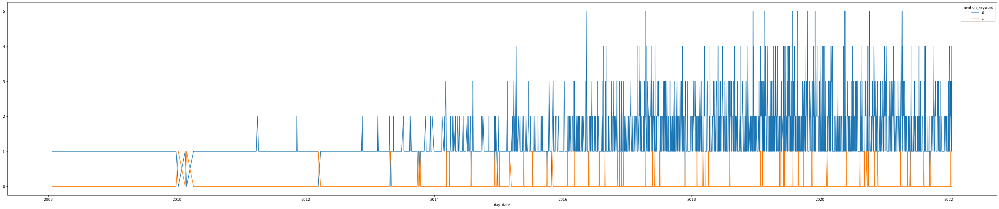

0.0228310502283105


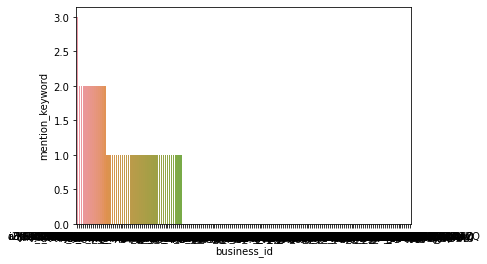

1481
2
68
68
(-0.3264218480545746, 0.7441052096496841)
mention_keyword     0   1
stars                    
1                1969  58
2                 327   5
3                 218   6
4                 208   0
5                 274   1
Chick-fil-A
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.014364159373417465, pvalue=0.18862975097001866)
                   review_id                 user_id             business_id  \
0     9IG9eB3K-RdIonPBuZ0psw  t2IL-HIXQKd6iZ6cIY8kcg  jOOOrH5n2ijnsZKxzPSAiw   
1     VE11x_UNVxri3ZHTzcG2jw  R1GU5Q3aw7Vkw5HvqnGSfQ  ugNplY4SZqIfP417oUxahQ   
2     N_Wx1OLMrj219D5nUMqtQQ  dEvFqqQImRAaE1dT5wYMJg  h3aPn7WjxYMu_DJqXCUAjQ   
3     2__UfAStiRsCS1rebI-fVQ  wXEDeyiuB5sXl12ci7oStQ  ugNplY4SZqIfP417oUxahQ   
4     1QLYrShH5sCsB3f_OenAcg  SH1dIv_U2OMnqRIjBUB0SA  jOOOrH5n2ijnsZKxzPSAiw   
...                      ...                     ...                     ...   
8373  9eZ_mpSDnenVQ

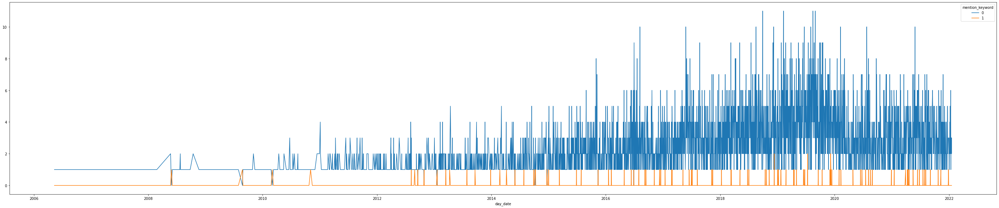

0.012532824063022202


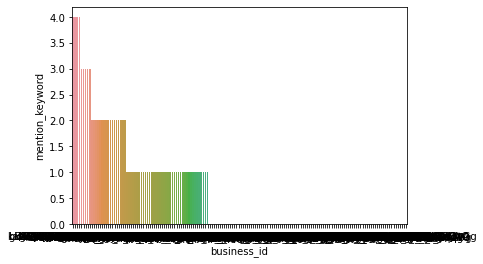

4117
2
103
103
(-0.6053018958238883, 0.5449784219851186)
mention_keyword     0   1
stars                    
1                1915  52
2                 857  15
3                 766  10
4                1273  17
5                3462  11
Popeyes Louisiana Kitchen
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0014141859000585642, pvalue=0.9187932432055407)
                   review_id                 user_id             business_id  \
0     YoLTbiYBOmSUgFCpJ_oHyw  N1UDQ8bQPAmhx5LpPTDcrw  mcwiecpP3n5ED-8xKF5_1A   
1     w6z62PHpT1-xz2pSWYWjEA  zU4gMQzFAB-Iil62f3R75A  mcwiecpP3n5ED-8xKF5_1A   
2     eSQATTmmx1j09oMdTjLB5A  6Rd-Oz0Iqns4_9NIhG9blw  MTjS4g__WMgA-PPMjCL4fQ   
3     RXPfhiAjcfW-jncNfwbtxA  1GQvA_ADZ1USPpHaVU1DWw  Kpw-RroI7wg54SFxRJXnsw   
4     2sPjt8eG3mCAPd6nw4XXtg  xDaTe_eLG8Q2KTS75zvxIw  NsbA31abl8CvYFs6P6kpyw   
...                      ...                     ...                     ...   
519

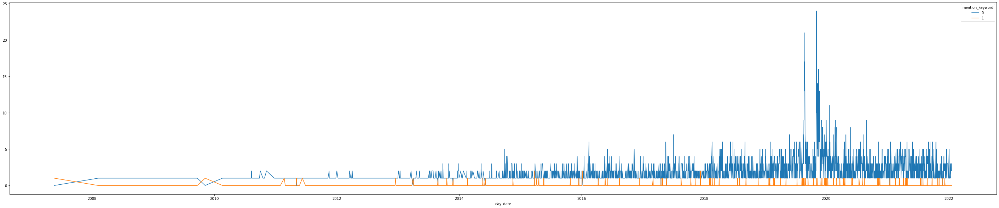

0.02076923076923077


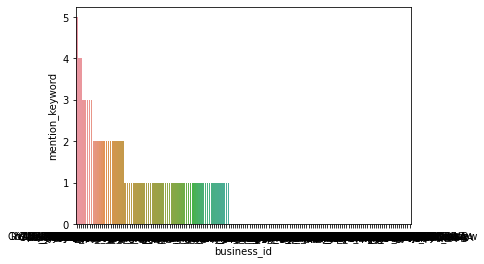

2518
3
105
105
(-0.5172874192747505, 0.6049555349512623)
mention_keyword     0   1
stars                    
1                2905  81
2                 629  10
3                 468   3
4                 497   7
5                 593   7
Chipotle Mexican Grill
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.01266711927735485, pvalue=0.21075162840475112)
                   review_id                 user_id             business_id  \
0     onlgwy5qGDEzddsrnIvtWg  pYXeL0RCqus2IfhthYCOyA  W7NxQw8UYFR0HLPrI08tvw   
1     V8dVnEHMdDNxCX6yFFam2Q  HjMKmLryj5emWPXcpBvt6Q  L7i_5DydYEKwPLfcDBRYDA   
2     -xvk0ycCuDVq4qEalW2yCQ  9C48_ifO4fXBiHsfXebb1w  C3Nc7EUqo64jRPWPn6vY9w   
3     Ws1qBFGyxa-vnkUUnTd7uw  yJRFIA3-JOjOxLloejG1Jg  iAP8eZ847uCHLS-r81jUFg   
4     batVbBszzQuw3LNR10pETw  BrhwZCoV-kd5JbV8G6gHLw  AmnnsJq4Pz1jJUFzHwtsOA   
...                      ...                     ...                     ...   
9758  C

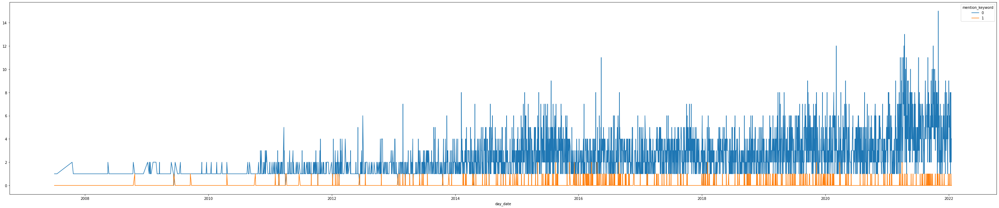

0.032776810406637304


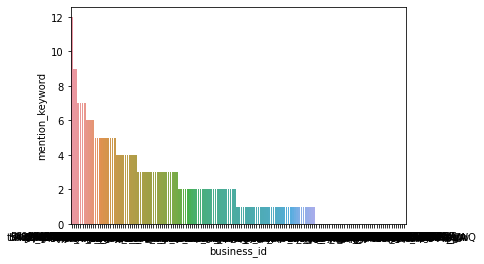

4636
15
305
305
(-1.4413090778599862, 0.14949738381957037)
mention_keyword     0    1
stars                     
1                3923  203
2                1464   38
3                1063   35
4                1380   26
5                1613   18
Panera Bread
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.01606292202941649, pvalue=0.16242435030644503)
                   review_id                 user_id             business_id  \
0     BiETNEHMCcmUWQDJMHQQqA  GNPPfbW6VzB3wjo5vPO5ug  kgeiJzWSiXPnf-3wx7LHIQ   
1     4DFXlyM4wJWzHYwjxLVv7g  tKSpEnWk9DARfElXZe8kbw  kgeiJzWSiXPnf-3wx7LHIQ   
2     BJBCO_KP4o0jTBCl84nuhQ  x5hVkd7eiXCeMI8VqmEPQw  K51bVqlGcpTMDK3-SDkBeQ   
3     iFRIf-_U8cIW0rC5tMBmMA  Ys_kEuS_EBAJB_NGlSA0fg  tP8wd-9CrI_RkHK424oifQ   
4     aoth7teo9RWecwGp1wlSvw  ERh66eWeg5pQkA-vWpmx0Q  0l_njS4wGMadAk1b4nZRUA   
...                      ...                     ...                     ...   
7560  1t

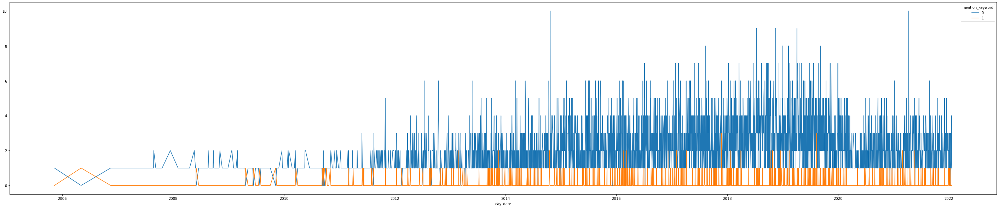

0.05208195637805684


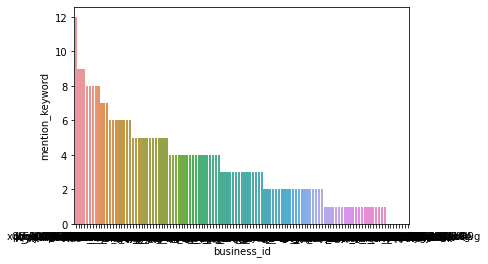

3500
25
368
368
(-1.276900808092994, 0.20163726882263822)
mention_keyword     0    1
stars                     
1                2330  100
2                1303   46
3                1079   62
4                1348  110
5                1111   76
Panda Express
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0025695898344005944, pvalue=0.8711802461238898)
                   review_id                 user_id             business_id  \
0     T_cL6Nk_W-H5bH0BwL57wQ  XOrq3ZorrmuakaWKQAKJ8w  q2cgYLHKRaujrQgSnqJPTA   
1     BzSmRmQTQhLkZrOStalnqw  XAlgPQYihaK-r3ZsKNYVcg  UKA2eeAZmO4ACB2J0kFISw   
2     rpeY-YMv4yfcAfM71f1N5w  4A1DHbi0g7agi53yzGUoYw  UKA2eeAZmO4ACB2J0kFISw   
3     WhB-_yrPorZl_wtYa5xY5w  yXynaFrGECLMJ9eOtBvojQ  q2cgYLHKRaujrQgSnqJPTA   
4     Koqp4Z9lNfcgrrHoKFjv0A  V2__oIIoNuhoPQZcbeoO9Q  UKA2eeAZmO4ACB2J0kFISw   
...                      ...                     ...                     ...   
3980  Y

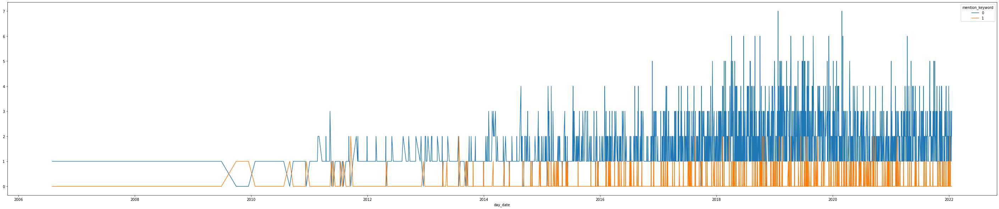

0.07352572145545797


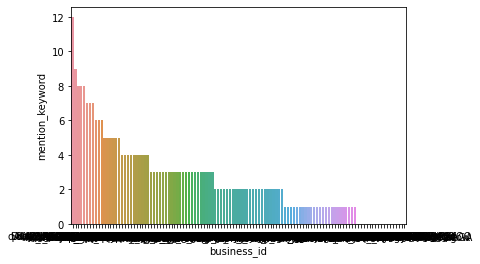

1779
21
271
271
(-0.10635076862362318, 0.9153040524149062)
mention_keyword     0    1
stars                     
1                1524  159
2                 597   43
3                 455   32
4                 525   40
5                 591   19
Sonic Drive-In
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.017115952173569524, pvalue=0.3503716226423541)
                   review_id                 user_id             business_id  \
0     4bG4ZrLsspDKV06DxoCX4A  t7ZTe8DkxQNpvvLTjmtUpg  O8RzM_uLVEnDWEhX3whqtQ   
1     aOe4_H3JLUvzI_0rLobw8g  c7uJo0ABJN-aAq9yZ9-amA  HlSve6o5TAXbl4UDwCfcFw   
2     5Bzkgd5ppjvreFPIW-BXTQ  T6cTV5Z7Z3QKX5ijV3IhQg  HlSve6o5TAXbl4UDwCfcFw   
3     BNRsZm24wmecKYjMjvHxrg  wB8X7GJVQtNQs9ofuG2vlA  pMX5P_cDFqoo_-ZBUP-UOQ   
4     H-djqzIn7K63a88yUkWQZA  dMRWPe2wfR3qJGO1okP2uA  HlSve6o5TAXbl4UDwCfcFw   
...                      ...                     ...                     ...   
2974  X

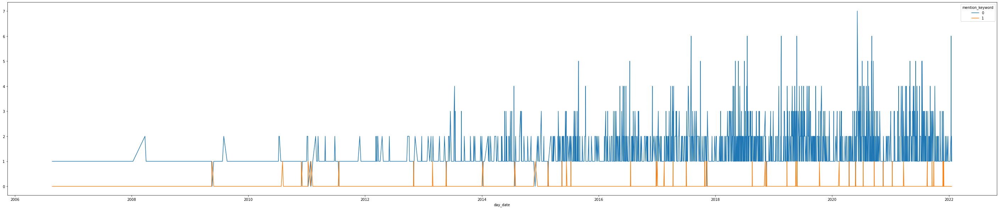

0.01544142329640819


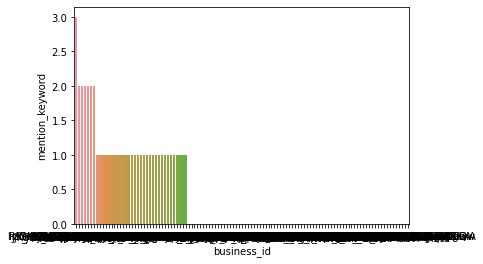

1456
0
46
46
(0.8606345185258081, 0.38943936817420277)
mention_keyword     0   1
stars                    
1                1481  30
2                 384   5
3                 330   8
4                 355   2
5                 383   1
IHOP
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009616045116684305, pvalue=0.44027336676894124)
                   review_id                 user_id             business_id  \
0     b7-Wi55KPnDFiDbQ3nUgFQ  q5g3dj7DJAPks8p4vZUsHA  3SHw4aZW_muE1kRSLQQjjA   
1     JXIrnBiSMI1weGNB7X3rYA  yhFJ56iFAmpPbT-6mHI2mQ  jx08bYW9trXnfdw9hAEoRw   
2     8xbioBTOEnYDDA86dNwDQQ  ZdODEy4O0-nPdPKwkdQkdw  g79jYJz3FEvgvglXqOUWxw   
3     XqKj9-Wdvu0IgfoYx291Og  hUGdWR7fLECh5aNg6pJOzw  zie_uvy3ln9rdTvA2e3gUg   
4     VYG48wer27lsbOE51Tr93g  xnfIF5cMnSJVVcMRff0DcQ  BJBSwMKADtYjqFDCL3-zkw   
...                      ...                     ...                     ...   
6438  09COU8ktqaPpDetCtEi9

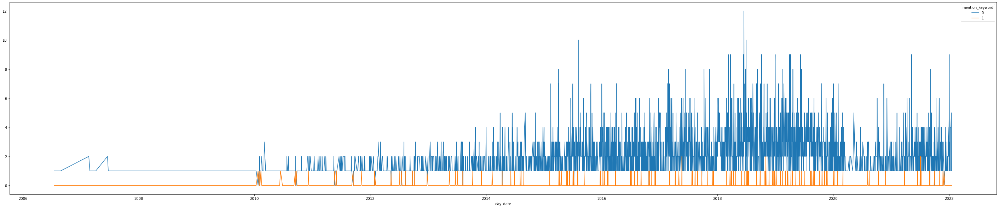

0.022349837032438306


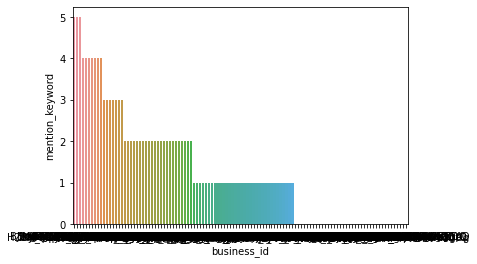

3112
4
139
139
(-1.0175433223900212, 0.3088950340828752)
mention_keyword     0   1
stars                    
1                2707  87
2                 848  22
3                 832  17
4                 921  14
5                 991   4
Applebee's Grill + Bar
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.005879618236907589, pvalue=0.6449052959717029)
                   review_id                 user_id             business_id  \
0     WcCEk3Q7bgIynzgq0dgTNA  n6rI5T6klu0KCz0q2tS9Ng  c5QMFe_yhgksThaR2a6rtg   
1     y6WdYTSR78VEgFvju_7CYQ  ej4kPMsfm3sEktEekcPW2Q  qOdsOVOM98hHj1SCRscjHg   
2     _RY_d-PAKawrga-_hha5UQ  gbg_h4hkvANBKhPWCz6ZnA  haTwYzufFqFb2sq6CHwOEQ   
3     K_J3aKPiNQ2onKCblbOFtw  anSyQUX30dCv5B3bVLUkzg  haTwYzufFqFb2sq6CHwOEQ   
4     uGyYy81ZvBuct63BxSzVEw  _h-2HhgEN7i327njrJvBuQ  c5QMFe_yhgksThaR2a6rtg   
...                      ...                     ...                     ...   
6141  LR

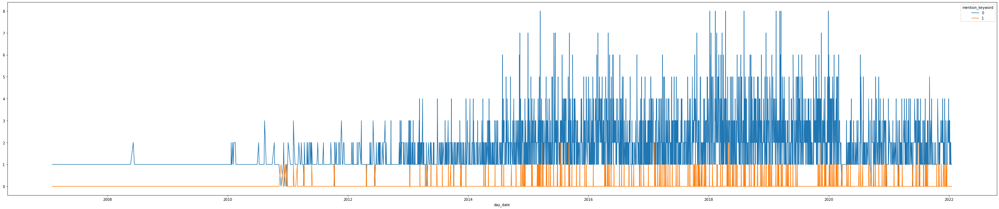

0.04116498535632932


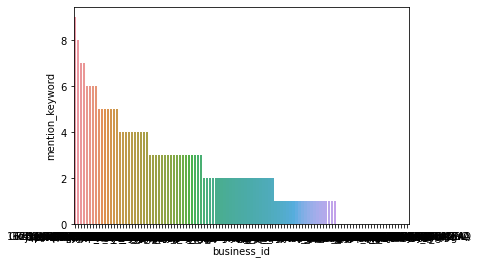

2878
8
245
245
(0.7811153587091676, 0.4347346494442542)
mention_keyword     0    1
stars                     
1                2365  132
2                 927   51
3                 819   37
4                 853   20
5                 929   13
Waffle House
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.011303462490254029, pvalue=0.5154419654333823)
                   review_id                 user_id             business_id  \
0     v5tuBGThz31Qywa50jL2Tg  fm1oHv32DvYmpzFekmDZIQ  xDqifhzRrOOYMOgOtWvyWQ   
1     p2va_14SWyWMm-9PPv-aOg  SmaAK6il7pyldoqZrH7iTA  uWc9h19N2G8cR7Vo5blL8Q   
2     nx6UliIGgx0bYAMU12X9yw  YO93KKYAKxnM9ypngw2-5A  DUn-V3XYMeSTxwEELMn7Tg   
3     DwuG-PV0EA2wvB7dH-plrg  mBQMR2FmJNA-x916xQjHjg  4LuzS6VevvwSmB71KbGyVQ   
4     7IgLhV_yaryvcqkiDVPQwg  BWZfZSRjNqoUNA96ddb0ig  xDqifhzRrOOYMOgOtWvyWQ   
...                      ...                     ...                     ...   
3308  tL7kT

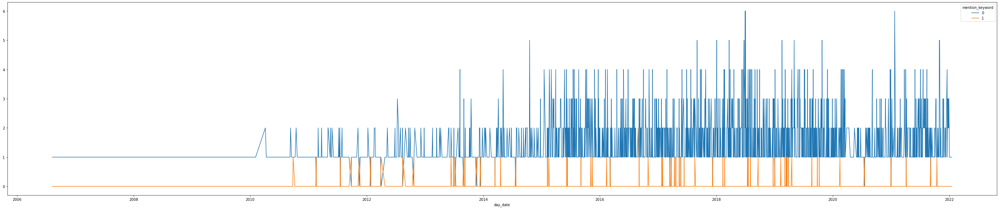

0.01992152127980682


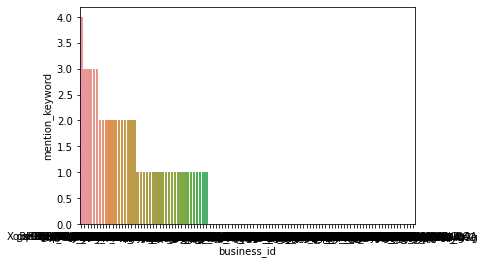

1609
1
65
65
(0.28118248326807455, 0.7785704392266923)
mention_keyword     0   1
stars                    
1                 748  29
2                 275   8
3                 366   8
4                 713  12
5                1145   9
Five Guys
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0025300160653310335, pvalue=0.8647205350042818)
                   review_id                 user_id             business_id  \
0     6X6GqoEw1MzYuUFw0vcrlw  qqPpgrtXxKOuRi15wa76Og  MYMLQfzRv8x7aO-bv9vpFg   
1     Z8QK2IxsNt3Q6VX7ex4QXA  DDjHoGITEKKgZZAbN-F_iQ  Q_4XtUDxWDasRhORDaC-jw   
2     520SOYBUwvwYwCq6DHCAMQ  0sAUF_yzU7nlac8Hg-FUvg  Q_4XtUDxWDasRhORDaC-jw   
3     48IJsrTbwAMSAV3ZB0WVrw  0bnzoCEmFnyrQQrygI3FKQ  4puDEkq0E27Nrq5nQiVqzg   
4     nt9Y8LfkDpojmPZ-w98NtA  jcgl3ygD81CP-runH1UYRg  Q_4XtUDxWDasRhORDaC-jw   
...                      ...                     ...                     ...   
4532  YVb96R4RWkbX1dJ1

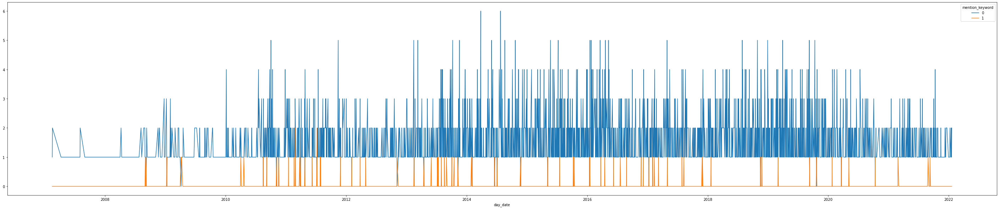

0.017853206964954817


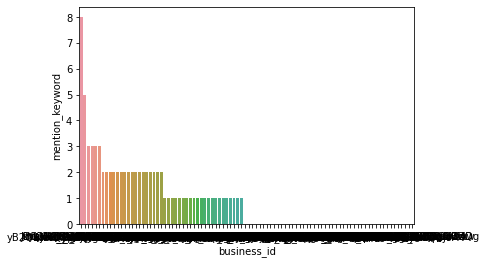

2207
2
79
79
(-0.47040063376036023, 0.6380688114689305)
mention_keyword     0   1
stars                    
1                 554  27
2                 496  13
3                 700  14
4                1243  14
5                1463  13
Jersey Mike's Subs
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0015400552884799624, pvalue=0.9323362358779996)
                   review_id                 user_id             business_id  \
0     Y3g47AccWwfOKRZ9Jshv7w  Izg15b1XjidpIiNJIThuEw  FjGAm10tARIypt5fYGpfqQ   
1     JwUqbBpGq-oJkKHQ1KXelg  tIsRPulDUNFQjR8Z_Id_lg  FjGAm10tARIypt5fYGpfqQ   
2     fSPKb4uySWxG8DTny_fQgA  RQWQTxfhGGJ7bGgJ1EnExQ  FjGAm10tARIypt5fYGpfqQ   
3     0rRTM8DNs0V9sodOJMZgDA  o5ZkBrR5iPKE5G7BBwlyGw  FjGAm10tARIypt5fYGpfqQ   
4     emhuQ6A8XSlIEMEoYeiNvw  1cIiG5velmJimoAfZx-Jig  FjGAm10tARIypt5fYGpfqQ   
...                      ...                     ...                     ...   
3037  XSuN5c

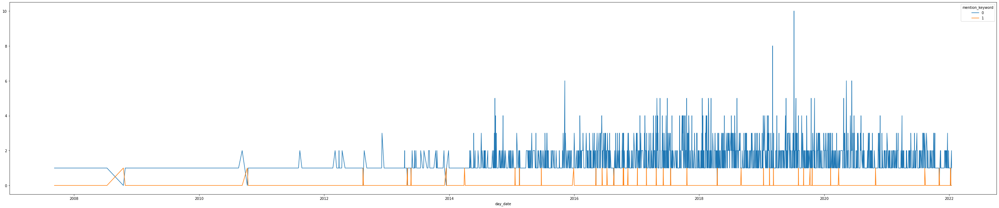

0.013477975016436555


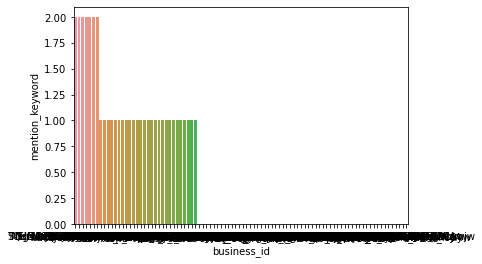

1491
0
41
41
(0.7581010829163106, 0.44839047147268996)
mention_keyword     0   1
stars                    
1                 661  20
2                 354   7
3                 304   5
4                 535   5
5                1147   4
Steak ’n Shake
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.017398149201129285, pvalue=0.16221674679642753)
                   review_id                 user_id             business_id  \
0     2V_v_iC7P6hJDFjbVZy5Tw  mRNk6znErwDpTzDOM5T3ig  R4eAWOt6Kz_rmo8B9FyG8g   
1     o_g_jRoHG-xgyr92-HNdXQ  KNVIA54o4xlzaKiqhJk50Q  4s4KAGJgtpZn9cgtdWcOmw   
2     BNMpYZrom5SQ-g7xUMso4g  cGu3izcZOqsBOsO0D9yZAw  R4eAWOt6Kz_rmo8B9FyG8g   
3     wrflc6maDTa0k35VkkM1Zg  eLW9gqABcAQZjo3Xg6SEAQ  sVWUxesVKseXGq78UwwajA   
4     HN4Ur4gq_1G_bCGrAvIuFg  0V9kMR2AGljsoMQR_JgpZQ  R4eAWOt6Kz_rmo8B9FyG8g   
...                      ...                     ...                     ...   
6450  Xjt057aOCl

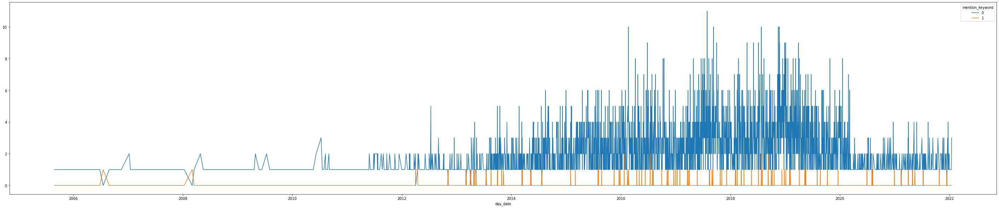

0.015491866769945779


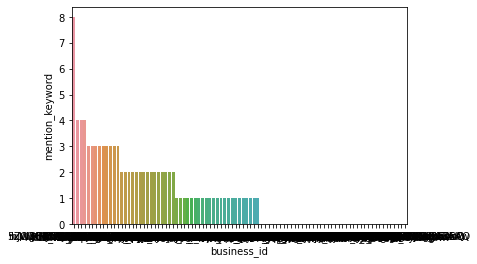

3153
2
98
98
(-0.3688056328808859, 0.7122726057766777)
mention_keyword     0   1
stars                    
1                3512  74
2                 861  11
3                 606   7
4                 712   6
5                 664   2
Denny's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.012602337432976169, pvalue=0.4447085829671779)
                   review_id                 user_id             business_id  \
0     Jg5We7zEV5N1ZlInmLL4fw  5Me93QYZKCP7mp51kxnOmA  Ax5taPtXMnxhUJjFUQHF4A   
1     lYOMJ7lPmB_9wjOjXq1lIA  1izddLfPCE_H5wsUqiEm6g  iD1j5TGvCznNI3YoeTa_4w   
2     QSEMXPGvmxfMcZYHcvdfCQ  bXClhGn35ESt57lAsAjCaQ  IxP1AjJo8yqQM7SeMLeR7g   
3     9fMvQs916OimLpBkBU-w9A  8EaQ8E2ZawuP-Sn4oYyTDg  IxP1AjJo8yqQM7SeMLeR7g   
4     eldXW0rKb1NLA3HiCsKahw  a4S_uNT1IGaJpbspCqv-oQ  IxP1AjJo8yqQM7SeMLeR7g   
...                      ...                     ...                     ...   
3675  A9KZ2EenK6Zu6lCRW3

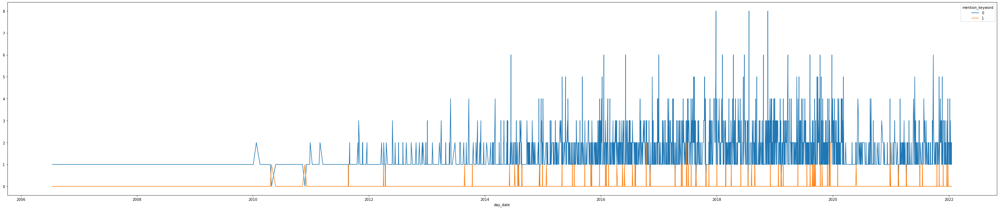

0.023641304347826086


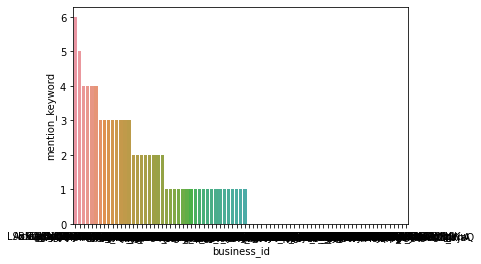

1774
2
85
85
(0.04067398064910868, 0.9675558048586987)
mention_keyword     0   1
stars                    
1                1513  58
2                 459  15
3                 412   2
4                 484   9
5                 725   3
QDOBA Mexican Eats
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0014649501691527383, pvalue=0.932938244493657)
                   review_id                 user_id             business_id  \
0     MSZuaItS46OO_47XmktjcQ  BO1xi6vjg46qcwIfJDGIAg  kGNzqiYKDns-IU80uHF4sw   
1     9SDRSG-MY3z2xtef9YR6pw  T__CyGS2hC3fq51vGXv9YA  Gf1EboxqdJ9SPsVJur93Cw   
2     FNrWnJK7-IiuRawYTMcKlg  SLvhVIW8IunggMhLX_evDg  tBnPLFSvHuyNgurZGN8dYg   
3     PovjR7aLjjunI_63Oz7juw  wxJk4ke4_e6pN5k08LvN0g  jf8AZyiMXd9CFxOg_fTb0g   
4     4ORvxd7JX6dtnlFP2mkfEQ  UVQiONN9JotrRzAZri001A  jf8AZyiMXd9CFxOg_fTb0g   
...                      ...                     ...                     ...   
3297  lw_PnPz

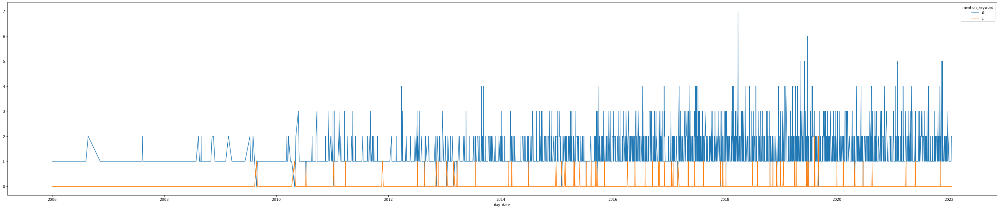

0.022410660205935795


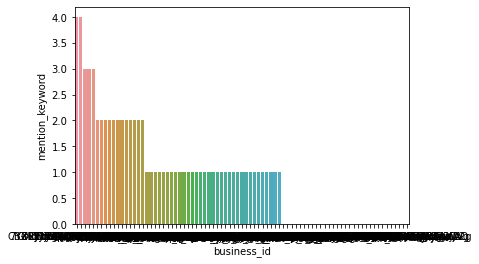

1596
0
74
74
(1.3216821131862282, 0.1862740272926543)
mention_keyword     0   1
stars                    
1                1001  45
2                 525  11
3                 435   3
4                 644   8
5                 623   7
Chili's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0016723987569837676, pvalue=0.8922324721894348)
                   review_id                 user_id             business_id  \
0     Y30wSqsq-gF0fEiEVDvTtQ  lnohBN_e2qklLESYih9Mvw  a2ITIJRAY4Eo-xTH0vN95A   
1     TsBbR2VuQo2kbOlHVkfu7w  tEtWHKgCezKRmRPfDe1i-A  a2ITIJRAY4Eo-xTH0vN95A   
2     yJwgnIn8XGlUxQjqOJvM6g  h0bLK2d0yRKTOnWYHirmzw  jfIWqMrdWnPNORcDnQ7VNg   
3     _3b2n0mgxe5PLNbN5RZPtQ  4AKl82vqfyZR-SBK1EfsTw  qzCT_X5aTj8SkGpKdBYYdg   
4     fQbAGJDA1NcY0eV5tVvyZA  Aa1cdgFJYWe37RE4dnrh0w  sKQ0KYon7eT6xEnCpb18aw   
...                      ...                     ...                     ...   
6560  TVLuZuqElQo6blVFHwT

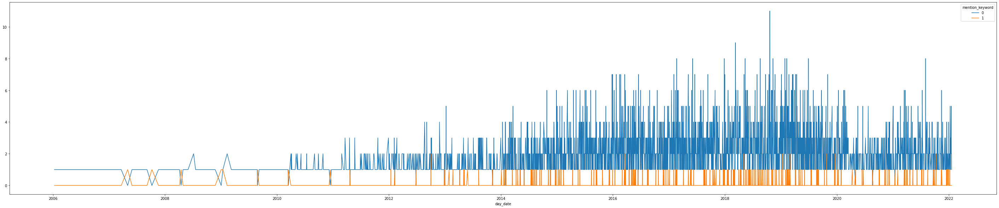

0.03472962680883473


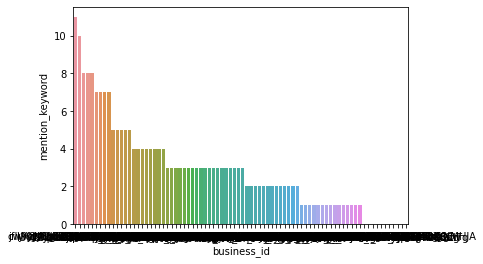

3116
7
221
221
(0.33845809877839916, 0.7350179981090856)
mention_keyword     0    1
stars                     
1                2561  106
2                 960   46
3                 851   34
4                 955   28
5                1010   14
Buffalo Wild Wings
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0020928077991429674, pvalue=0.8576597898842278)
                   review_id                 user_id             business_id  \
0     ilbEXGq_s0Cn8cMMUpxuMA  Jhdk8OjarHCjISYhRvJvTg  ZGErYinCaYR5UjTzovAZbw   
1     DF1juQCUsEjVHLB0WliotA  poOyZqXhbMoWyLN_jyynhA  yNlR9wTzd6Hg7It9fQrhdg   
2     LBzRWwm5OVNHeA8oduWLlQ  lrtGPAmDqCFnbfAKiB4NmA  ZGErYinCaYR5UjTzovAZbw   
3     LF6qW3Zf8cxZIgBK1bqbYg  hk6B1ZdzI62jMGo6e2IuuA  ZGErYinCaYR5UjTzovAZbw   
4     -kJqw8ptJ5ieoTVuHGdCLg  61nr50PqgF4WUWx4r-OcsQ  citzbW-2MVEZRNBqpVO-Jw   
...                      ...                     ...                     ...   
7342

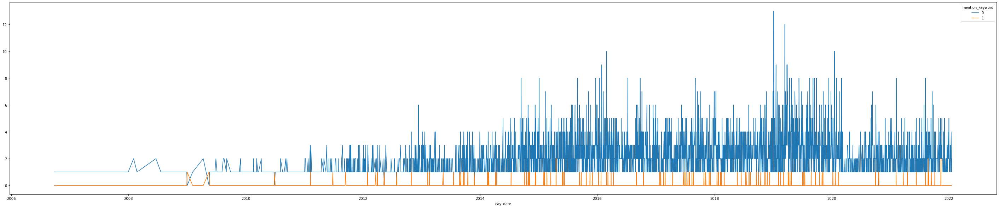

0.017558187015108206


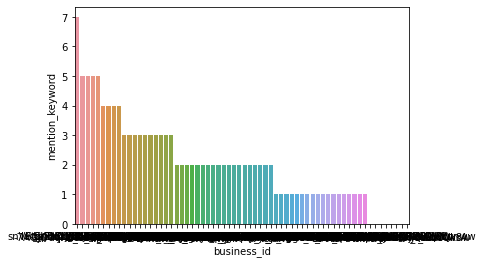

3580
3
126
126
(-0.4980478002141868, 0.6184503513828175)
mention_keyword     0   1
stars                    
1                3076  91
2                1285  20
3                1007   9
4                 940   5
5                 910   4
First Watch
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.015930230582250543, pvalue=0.12415855571020147)
                   review_id                 user_id             business_id  \
0     WM2KflQ6b-ySVeMXQsTKhA  17fHDTdkKk-tcfvUp1LzlA  2brttsiFBlW8070dsPzQDA   
1     vi1XPASJucai9lvyTJeObA  WF-sXnGO0W1gG_iSMXYX2w  2brttsiFBlW8070dsPzQDA   
2     dOMaIw4HlWtmryjOmJNsFg  JUQriibXaA8Wi6UDcAnUuw  2brttsiFBlW8070dsPzQDA   
3     SwsT4cISmKKUgiNe9qh53w  njJjEOLRTo03Fwp4jg_Jpg  2brttsiFBlW8070dsPzQDA   
4     1B2eKekPyJ4NwMXifbo9Xg  lyBWYViVlQGGXT0TjcwE_w  2brttsiFBlW8070dsPzQDA   
...                      ...                     ...                     ...   
9312  LvYz8DDvtpKj

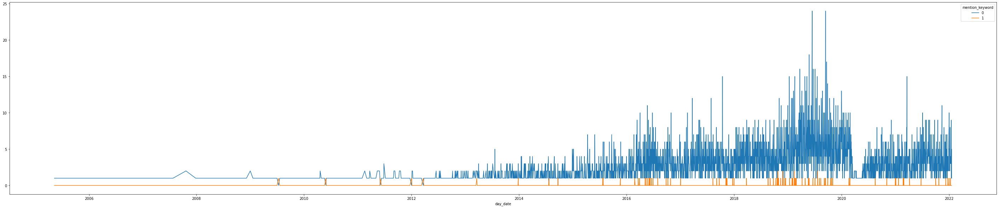

0.010411076526779006


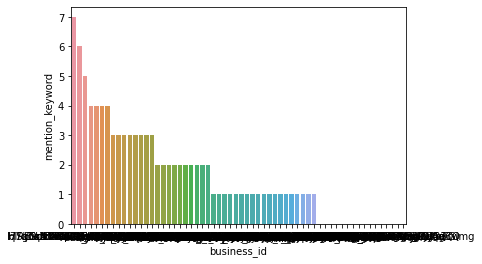

4583
2
95
95
(-0.9981883736181417, 0.3181880231043659)
mention_keyword     0   1
stars                    
1                 782  24
2                 759  17
3                 939  12
4                2216  18
5                4524  26
Outback Steakhouse
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.017941601282957756, pvalue=0.15755300366298522)
                   review_id                 user_id             business_id  \
0     jpThMSnG2zJrhmSnn_PADQ  x5DJdEvWFh1cKBkPO9jNsw  U0ICWpbd1C0GD9SpIv3bSA   
1     QYFIqpXRgpWom4NU0BCLDQ  tOQPJUFMu3kLWZooSsZULQ  z22hSRptt_DS0nWjsIka2A   
2     B556O6ZFS59huvp4Jra0iQ  1A0zd56jS9AFuXFPS5JmUg  m7uGAvkjyI9iQaLJAmvCNQ   
3     Iz36hSAvtdPdnPQQFJtAkQ  JVM3YG_8Ns6dGHalHgP-Dw  U0ICWpbd1C0GD9SpIv3bSA   
4     LFjBP5cFaeVo1bBMlpYaeA  ocSmiCHL5R9bBZTBmk_ryQ  U0ICWpbd1C0GD9SpIv3bSA   
...                      ...                     ...                     ...   
6202  Csg9wo

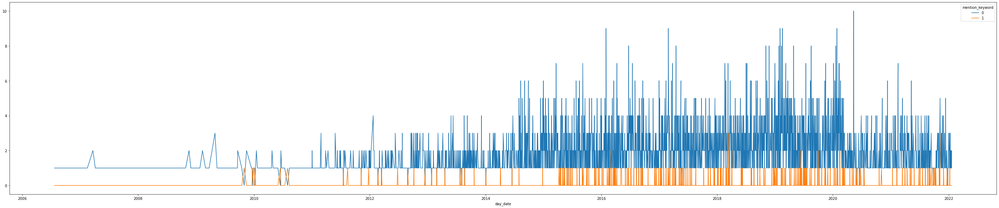

0.03898823908490414


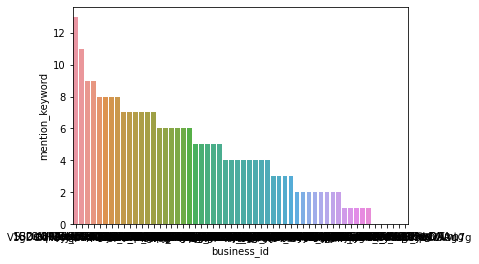

2920
12
230
230
(-0.8697420960791136, 0.3844413616391644)
mention_keyword     0   1
stars                    
1                1585  90
2                 949  36
3                 788  40
4                1131  43
5                1512  33
Olive Garden Italian Restaurant
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.03759212118026896, pvalue=0.006083200587880542)
                   review_id                 user_id             business_id  \
0     WTTZtAEG0NgxswzwS-5Skw  HcGQr1GiPnKavo57waY6jw  4fUok5d5vgdQEb1Bzzg0rA   
1     HhsCn0Zv1my4yC7ooNNmOQ  EVyq9IBVgdJqCJdEpKJt4w  4fUok5d5vgdQEb1Bzzg0rA   
2     8bZmzYSB_nRPepV5xZtOfg  FR6IAJg1Dx7RE1BbEHB69Q  DszOO6k_s2wuGhTw2AsUdA   
3     4pJrpU-V1BiR2gXPiC1Jvw  jQLap57r591aW8xZ8yapmg  4fUok5d5vgdQEb1Bzzg0rA   
4     Q4xtLAUuuL1t-tacaftZQA  lAMh24SC6G9ayTfOwSn5yg  DszOO6k_s2wuGhTw2AsUdA   
...                      ...                     ...                     ... 

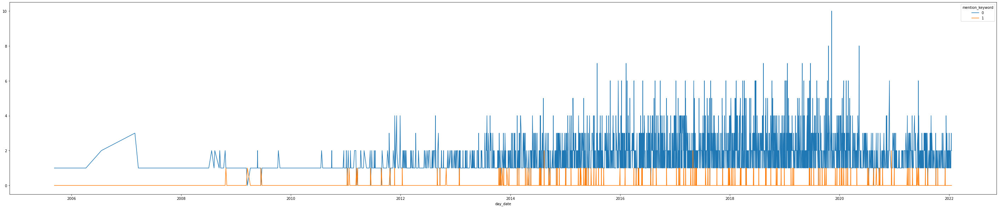

0.030240420736288506


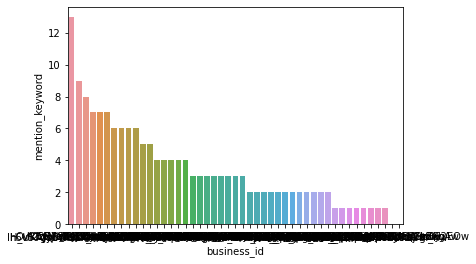

2541
4
157
157
(0.4065916771170985, 0.684307911098766)
mention_keyword     0   1
stars                    
1                1195  81
2                 786  35
3                 835  16
4                1028  16
5                1319  13
Cracker Barrel Old Country Store
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0034409587967914445, pvalue=0.8172200436681968)
                   review_id                 user_id             business_id  \
0     PPgbLBvi34A6m7bKJfTwhw  3TL6HZ1JrKcNTvGDWKlrow  GyC36Pn0Q1-qHnqXys6yFg   
1     Is_4BTKGJTHxLGKRxLD_DQ  V8P2-U2IINNHzALqjaN3gQ  GyC36Pn0Q1-qHnqXys6yFg   
2     r7mKyEcShrHjgPfGNZ52Bg  s_C3YVr2PQ0G9VJjP4cdqQ  -cE9GrThz6HHn2zdpoqY_w   
3     mkgHTEAqcbDht-SGmx00qA  Ex_YPuZengm0H8oteLtjqA  -cE9GrThz6HHn2zdpoqY_w   
4     l8ZgxAuV6bb3Cis7PX2Dxg  -cZBjaI5ShjZfLM9cQQOMA  GyC36Pn0Q1-qHnqXys6yFg   
...                      ...                     ...                     ...  

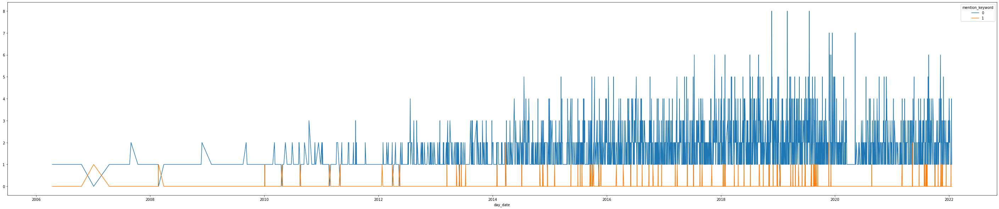

0.023704031900753212


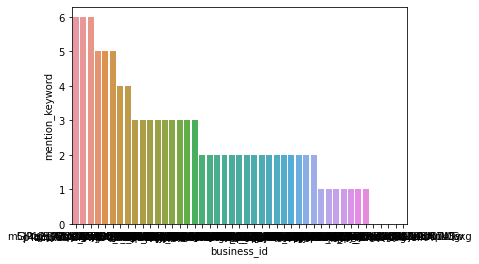

2174
2
105
105
(0.34573429920967724, 0.7295424049901764)
mention_keyword     0   1
stars                    
1                 977  43
2                 610  18
3                 637   9
4                1062  21
5                1121  16
Red Lobster
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.022172001105184802, pvalue=0.17859483215637617)
                   review_id                 user_id             business_id  \
0     f-IU2WuzMRkYGp01webwyw  R-W0T3bemRPqWcm2V9oY-w  OyHbS1sJ4CguExlWa-XWDg   
1     n1o-LQ8Truw3Ld2jSocSbQ  PvsM5t79m6qI-hQuyFAvkQ  i7LerGjkoxNPrlJ1oJpbXw   
2     sBW2sQV9IJh24wPKWxR65Q  g2Q22rvdjTJk5OdlDPq6iQ  OyHbS1sJ4CguExlWa-XWDg   
3     _ZpPcnQbwVwP6F1kHuRHvA  7QmlFgJAHoLfFa0sFCqemA  BDYL4lMlT6fpKgiNlJRclA   
4     5x3DEEWAFGTwOfDoX7xGWA  K7xZwcyw8l3swKOe7KVa9A  G6qbByoO3QE-rft_1J94eQ   
...                      ...                     ...                     ...   
3677  TmULV0aLxEaW

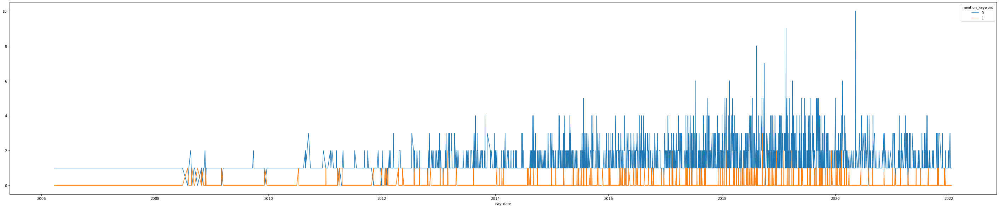

0.057034220532319393


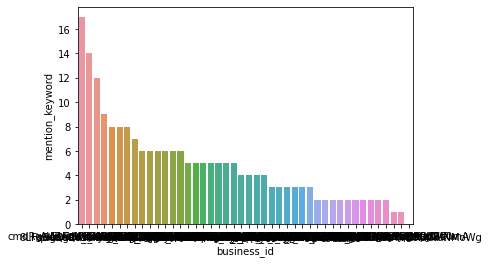

1687
8
202
202
(1.2200920561711583, 0.2224299796204674)
mention_keyword     0   1
stars                    
1                1014  88
2                 551  45
3                 509  27
4                 656  31
5                 742  19
LongHorn Steakhouse
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0042183886391450875, pvalue=0.7935309204730492)
                   review_id                 user_id             business_id  \
0     A3fdb3XAaSB1EKobAjLfWw  W_VNrooLU3h_r-Iw5HLo_w  CS_GzUYlEPa6QHTRY224wQ   
1     6ka6yLrIDvIP5NWeli89Yg  HumkUpRp8WWzrZ57wLcDVA  CS_GzUYlEPa6QHTRY224wQ   
2     b63fKVpSmWoJDRpRQb8hcA  r6GXrPswAqNuPf6u4hkWwg  WKF4p8kLDng4EECYC3RoeQ   
3     n-Oi_9zwM7f6GACmA5g78g  i8-EUsEUdN6vqTPbxv_FCw  CS_GzUYlEPa6QHTRY224wQ   
4     S07QJGQdqcpQ1ZF2QwSCww  vOeDq0HEnIu0c7HQzJsVig  CS_GzUYlEPa6QHTRY224wQ   
...                      ...                     ...                     ...   
3847  hKCGl

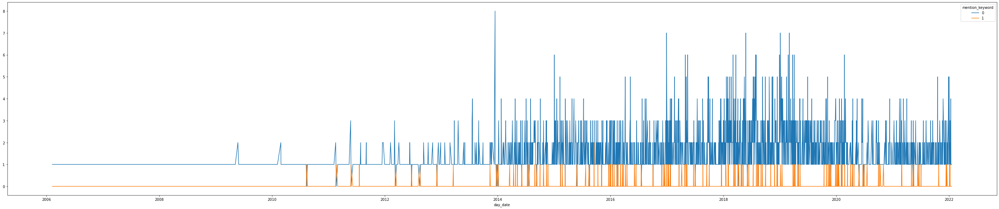

0.04023883696780893


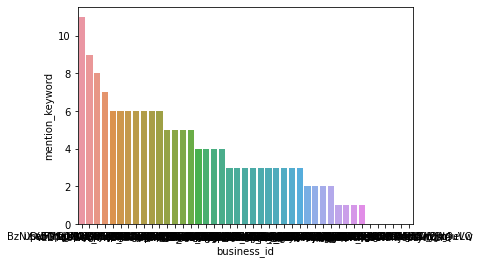

1807
3
152
152
(1.352596650996681, 0.17618452294044895)
mention_keyword     0   1
stars                    
1                 738  39
2                 514  23
3                 551  28
4                 786  41
5                1108  24
Hooters
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.03380851009869215, pvalue=0.055608539648883425)
                   review_id                 user_id             business_id  \
0     UShAuTCPziEpnOqaXNQQLQ  oO63NIB8sLJyC7gjeTvj7A  aq26RY75PlTNsviW6wUC9A   
1     PHHPkcoNVehIR3116FteoA  4P8qDuDy3C8s6Rkm5wEI4Q  dv4tx5H0-aPiIXSM2hJNhA   
2     hfBxst0hK8aeGI3d41N9Gg  -gjIjEvEA2rlypikYsEA5A  aq26RY75PlTNsviW6wUC9A   
3     kQ5EKGY7lH-8HHpHXeOADg  sB3u-7MEaEz8zAI54vVjpA  aq26RY75PlTNsviW6wUC9A   
4     pzCtl9S2oyZMcEaWs6bBkw  _1XBAPI7ayFFVDm06WLWqw  aq26RY75PlTNsviW6wUC9A   
...                      ...                     ...                     ...   
3201  S2hrwJmbYS7s4i4c9

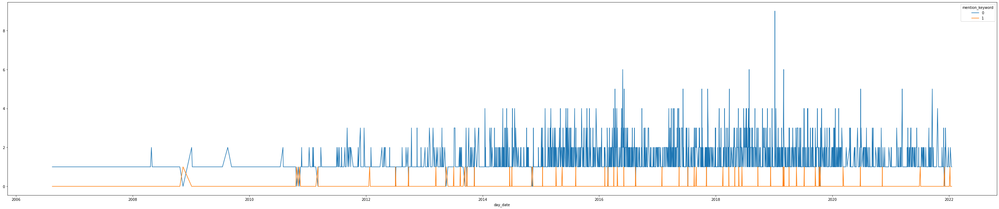

0.017467248908296942


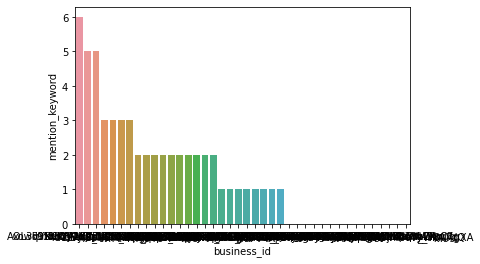

1559
1
55
55
(-0.02256814062027804, 0.9819947574539609)
mention_keyword     0   1
stars                    
1                1151  39
2                 506  11
3                 485   3
4                 510   3
5                 498   0
Red Robin Gourmet Burgers and Brews
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.008095430789918954, pvalue=0.5739467943128838)
                   review_id                 user_id             business_id  \
0     50_IPMsBuclmeMme2r69Rw  NMOxipsnXc6olWdHYzXiYA  MZW_eTFYFBvHYg5OFqDRCA   
1     mtZ0LqbTdkKyjNwPgybtXw  mjDsDnoSghhIiht5cSjF4g  radib3GHt_Up9-zhUjM1ew   
2     2vh3m4lABtYB_krPxweAlg  0qb8xlUlMyvjNjxD6B8NDg  radib3GHt_Up9-zhUjM1ew   
3     QZr0dkTX0k0X6YpQCOgaPQ  B4cnr5d2S_7McR3XBfrscA  MZW_eTFYFBvHYg5OFqDRCA   
4     P26SYtGQXEs1a4xru_PH6g  g2hQWa0anF0R9PIJa524bg  radib3GHt_Up9-zhUjM1ew   
...                      ...                     ...                     ..

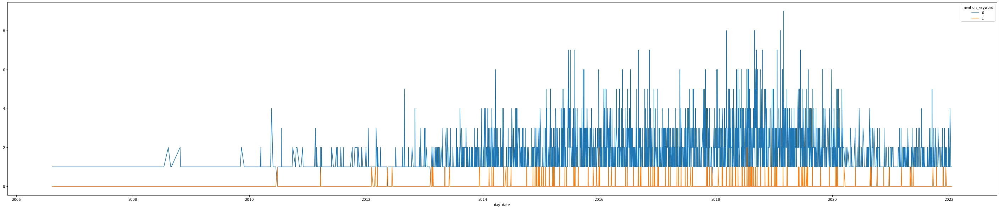

0.031496062992125984


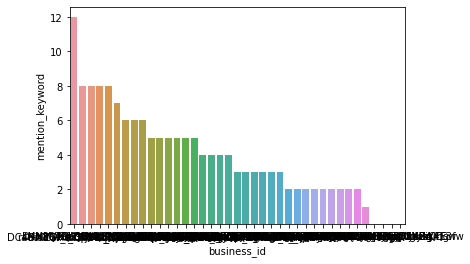

2297
4
148
148
(0.37216775628196913, 0.7097679513175448)
mention_keyword     0   1
stars                    
1                1201  56
2                 792  28
3                 779  23
4                 968  25
5                 934  20
Panda Express
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0025695898344005944, pvalue=0.8711802461238898)
                   review_id                 user_id             business_id  \
0     T_cL6Nk_W-H5bH0BwL57wQ  XOrq3ZorrmuakaWKQAKJ8w  q2cgYLHKRaujrQgSnqJPTA   
1     BzSmRmQTQhLkZrOStalnqw  XAlgPQYihaK-r3ZsKNYVcg  UKA2eeAZmO4ACB2J0kFISw   
2     rpeY-YMv4yfcAfM71f1N5w  4A1DHbi0g7agi53yzGUoYw  UKA2eeAZmO4ACB2J0kFISw   
3     WhB-_yrPorZl_wtYa5xY5w  yXynaFrGECLMJ9eOtBvojQ  q2cgYLHKRaujrQgSnqJPTA   
4     Koqp4Z9lNfcgrrHoKFjv0A  V2__oIIoNuhoPQZcbeoO9Q  UKA2eeAZmO4ACB2J0kFISw   
...                      ...                     ...                     ...   
3980  YPk_JudKP

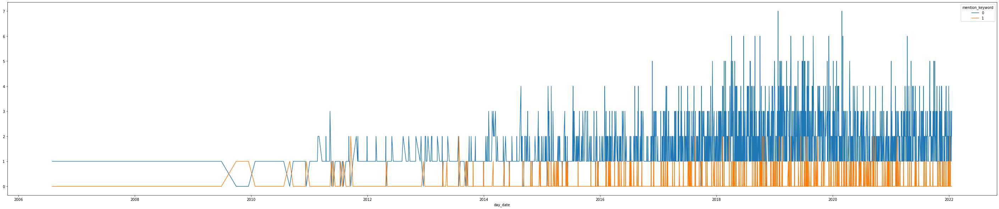

0.07352572145545797


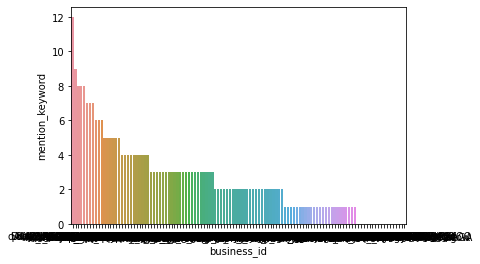

1779
21
271
271
(-0.10635076862362318, 0.9153040524149062)
mention_keyword     0    1
stars                     
1                1524  159
2                 597   43
3                 455   32
4                 525   40
5                 591   19
Boston Market
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.014014789430391224, pvalue=0.6307063089956991)
                   review_id                 user_id             business_id  \
0     xMCBJ_Z8dhmh14WI7ALHaQ  RJ8SKcctWjfQ36ZVs9QsPg  rW69-eTXD8zAC-DeI9qAcA   
1     k4SBEvpXNSv4YM7_vmqvNQ  flfHwNuaNHtGsD-eqF5I0w  rW69-eTXD8zAC-DeI9qAcA   
2     7JDQEUjYIPWX6sRMrcfpPw  XznTWp7IHLfeXGJ5aFNX4A  vm-t-lpS9rez56oVJqARRw   
3     17hNVIzyu3RfgDHXgjCYBQ  k87j8UOzbWxorBiMVoPM2w  vm-t-lpS9rez56oVJqARRw   
4     vEaS77WIWYoyl8rEMQGLKw  EfG0nInFMbiO9Hy7A6B2cQ  VravcZnsQskdqMp9dWS3pg   
...                      ...                     ...                     ...   
1174  Uv

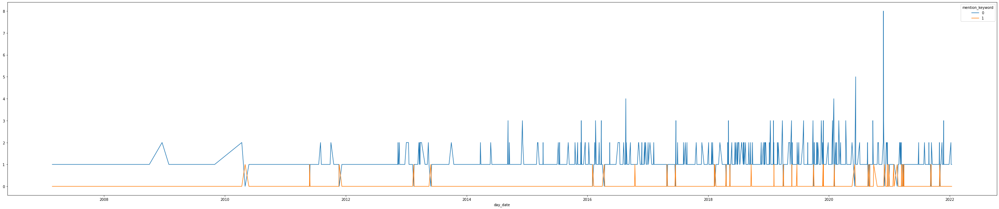

0.032230703986429174


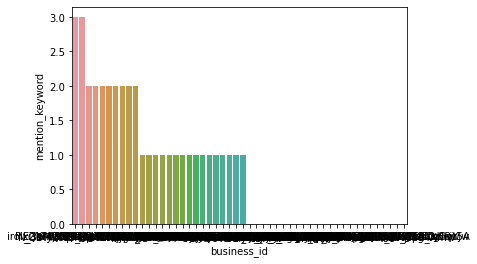

562
2
35
36
(-1.1983383215117651, 0.23078533357253073)
mention_keyword    0   1
stars                   
1                359  28
2                151   4
3                173   2
4                222   3
5                236   1
TGI Fridays
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009703971102060187, pvalue=0.5529492589012758)
                   review_id                 user_id             business_id  \
0     5X50uni7TraQBetwrP36cA  w3SeGBY2fos2_7sLjSlAgQ  -kVGt2QRNtBoZMvKeIjVug   
1     hsutOHG9vAIqqNHZulQeDA  78ZImmzW07qqlelRfdvOkw  kB0jhYe17R7zobBUXfsP3g   
2     S89t2ExwlSGHnIIBXiuldg  vUiebV27kFKne70hRP-L4A  kB0jhYe17R7zobBUXfsP3g   
3     4mh0fW0TPnYuYQmhn1n55A  zKpzlDuCHawN2lMJkj8iyA  kB0jhYe17R7zobBUXfsP3g   
4     KZ8V7PcfhczsXIjd-IWmWQ  HDzZYxw0FxaINVVWEcQ1TA  _ci2Bsw_5go_-2cavIlbOQ   
...                      ...                     ...                     ...   
3736  h3-cVkcwliDnukN5YmGuL

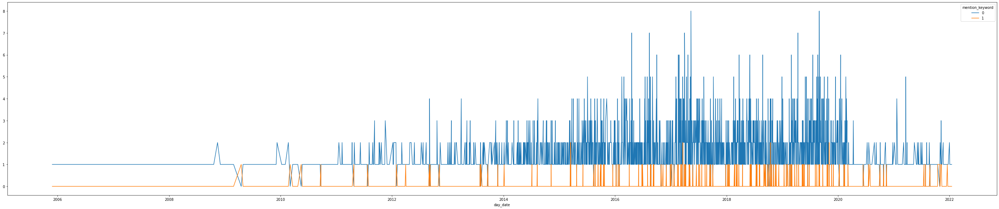

0.043036621224271585


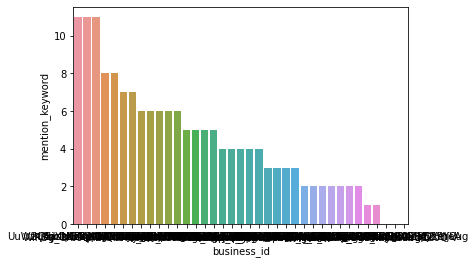

1751
6
155
154
(0.1705188770482296, 0.8646020900219722)
mention_keyword     0   1
stars                    
1                1710  89
2                 563  35
3                 435  22
4                 460  10
5                 412   5


In [43]:
df_2014_2020_sum = pd.DataFrame()

for name in chain_name_list:
    print(name)
    name_reviews = chain_EDA(name)
    
        #########################################
    
    df_2014 = name_reviews.loc[name_reviews['year'] == 2014, :]
    df_2014_calc =  pd.DataFrame(  df_2014.groupby('quarter')['text'].count()  )
    df_2014_calc['mention_keyword'] = df_2014.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2015 = name_reviews.loc[name_reviews['year'] == 2015, :]
    df_2015_calc =  pd.DataFrame(  df_2015.groupby('quarter')['text'].count()  )
    df_2015_calc['mention_keyword'] = df_2015.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2016 = name_reviews.loc[name_reviews['year'] == 2016, :]
    df_2016_calc =  pd.DataFrame(  df_2016.groupby('quarter')['text'].count()  )
    df_2016_calc['mention_keyword'] = df_2016.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2017 = name_reviews.loc[name_reviews['year'] == 2017, :]
    df_2017_calc =  pd.DataFrame(  df_2017.groupby('quarter')['text'].count()  )
    df_2017_calc['mention_keyword'] = df_2017.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2018 = name_reviews.loc[name_reviews['year'] == 2018, :]
    df_2018_calc =  pd.DataFrame(  df_2018.groupby('quarter')['text'].count()  )
    df_2018_calc['mention_keyword'] = df_2018.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2019 = name_reviews.loc[name_reviews['year'] == 2019, :]
    df_2019_calc =  pd.DataFrame(  df_2019.groupby('quarter')['text'].count()  )
    df_2019_calc['mention_keyword'] = df_2019.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2020 = name_reviews.loc[name_reviews['year'] == 2020, :]
    df_2020_calc =  pd.DataFrame(  df_2020.groupby('quarter')['text'].count()  )
    df_2020_calc['mention_keyword'] = df_2020.groupby('quarter')['mention_keyword'].sum()[0:]
    
    df_2014_2020_calc = pd.concat([df_2014_calc, df_2015_calc,
                                  df_2016_calc, df_2017_calc,
                                  df_2018_calc, df_2019_calc,
                                  df_2020_calc], axis=0, ignore_index = True)

    print("Dataframe")
    df_2014_2020_calc['mention_ratio'] = df_2014_2020_calc['mention_keyword']/df_2014_2020_calc['text']
    
    s = df_2014_2020_calc['mention_keyword']/df_2014_2020_calc['text']
    
    df_2014_2020_sum = pd.concat([df_2014_2020_sum, s.rename(name)], axis=1)
    
    print(  df_2014_2020_sum  )
    
    
    ##########################################
    
    
    plt.show(plot_illness_series(name_reviews))
    percent_ill(name_reviews)
    illness_grouped(name_reviews)
    illness_random(name_reviews)
    
    print( pd.crosstab(name_reviews['stars'], name_reviews['mention_keyword']) )

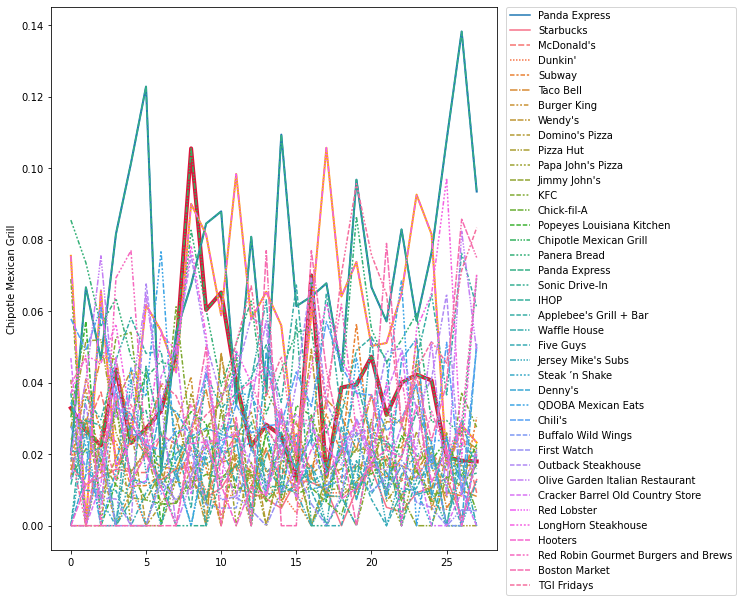

In [44]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(8, 10))

df_2014_2020_sum_chip = df_2014_2020_sum['Chipotle Mexican Grill']
df_2014_2020_sum_pan = df_2014_2020_sum['Panda Express']
df_2014_2020_sum_red = df_2014_2020_sum['Red Lobster']

sns.lineplot(data=df_2014_2020_sum_chip, color="crimson", estimator=None, linewidth=4)
sns.lineplot(data=df_2014_2020_sum_pan, color="g", estimator=None, linewidth=2)
sns.lineplot(data=df_2014_2020_sum_red, color="orange", estimator=None, linewidth=2)
sns.lineplot(data = df_2014_2020_sum, ax = ax)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

plt.show()

Starbucks
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0015725135725873625, pvalue=0.817342514594039)
                    review_id                 user_id             business_id  \
0      ULzbgT5SPThiMOoo4a_Adw  veBX5roHQLNnQ1rTtNh_gg  aJvxWyQIG5OLfBw3qAe8xA   
1      RXqhxbAuPPSNs-oyJJyOgw  zZygOZLNyJX5nDqKrwa4HQ  MjZQqZAmJeMco_Vq-Y9h-g   
2      LuMkMBAUV1B-2dm2pqSBWw  0SpK7eVn5TrpyQKPaohVBw  u7MJKcNdZXYyTeb67vD5jw   
3      Z0Jt8xf0XqFD_xjPPm_d0g  IVnrNZ8npRx04jkNp6-ERA  saJFbz12EnzanelpD8_xXQ   
4      NoPOfj7gC1l48dC0XH7Spw  tgP2gKsf3O9MyuLuolv2oQ  KiE0h68HGOO7ZXAqkMBdiw   
...                       ...                     ...                     ...   
21570  Vt4zgo9wDRlNbUNds0Ttbg  QPDFn3SQqZeBu7OBI78g9w  -85kJMtb9wqNWDT8yLbitw   
21571  OrYpmKDqmc3X7g7STa3jww  F3ELBqGgDCX9YEhz_oS0xQ  Ddg-J_j0YFErk7wpMtH_0A   
21572  kB85EOTWW2Gw5-DpsyMa-g  TZJzzQsE4R7RmqkVRaLEKw  2rmpfdyV2POqpXtmPHO_IQ   
21573  fe

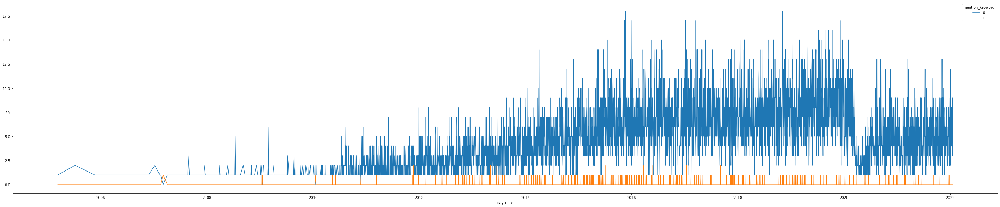

0.010753186558516802


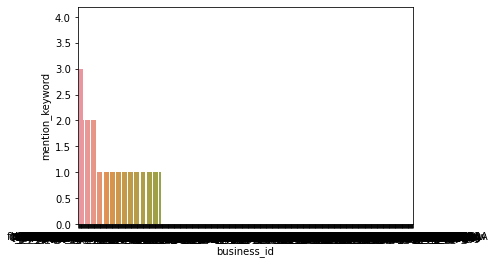

10612
4
228
228
(-0.9644018028167439, 0.3348445187343809)
mention_keyword     0   1
stars                    
1                5690  55
2                2872  41
3                2764  54
4                4170  52
5                5847  30
McDonald's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0011369271905993135, pvalue=0.8780737663669351)
                    review_id                 user_id             business_id  \
0      12WmsX0EwwDlQyGXAgtkww  xUhG4eI0M1KRvucUn0t19w  QSA-x2bb3kum9QLFpy7vUg   
1      E-yGr1OhsUBxNeUVLDVouA  MfDqmwzf1WxvJFtiRKi4Sg  kgMEBZG6rjkGeFzPaIM4MQ   
2      xRAw5A0eI-e-39c11uy4Zw  ljmDAIBee0SyVh9KtuBFdw  y0pfoNQOyrb98aEIdH6cnA   
3      lgfa_q4jisy7l7H3RwIYzw  c8XvSrb7Rj1WUMtUhf82yw  7YiLEuHuUONZrMPT0OxXUQ   
4      IEvZ_PRx5JQJ8SQ2gYskag  _Y9XioW2o0T_UBAX7hG14g  3_kZ2pDiKJLZ9kGKKOWqdA   
...                       ...                     ...                     ...   
18205  Nic

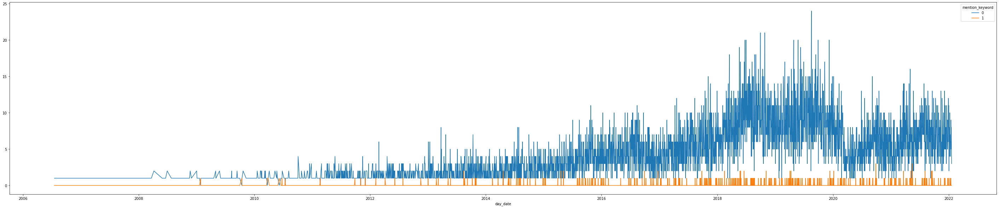

0.018451400329489293


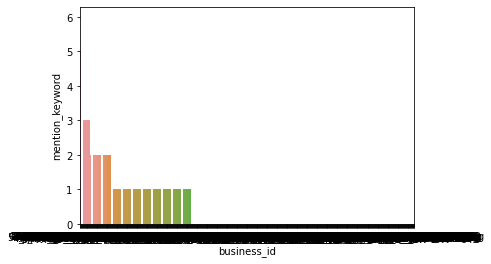

8846
5
331
331
(0.4912283309868355, 0.6232649631815816)
mention_keyword      0    1
stars                      
1                12040  280
2                 1832   21
3                 1289   11
4                 1126   15
5                 1587    9
Dunkin'
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.004493674172819939, pvalue=0.648195336236556)
                    review_id                 user_id             business_id  \
0      FER3y2U9ghI_xXU-PoN7fQ  DmDM9jxpvYRDVtXst9l2fw  H1bbYNKgk6JF9pKcBXyDXw   
1      -Pf2OfKJKBewQDU1yGuAdA  ocSmiCHL5R9bBZTBmk_ryQ  vMp55ea__Pk0fYbBDCn6jg   
2      4ubnkX74NnLUk4JRjDA5VQ  r_HYtkSGTgCOgSR-DJoPrw  -3dkEoYgH8AlUtBMZvzUfg   
3      ah0CVAemJaVLyMemei3bMg  -fNcj-eP-ztfX55vSnmX5A  nXJ1dAI-UGbXfeaI_b1abA   
4      y-eeYEo-in7RTfEmZf3PBQ  4ZoLduHgq6Q4DQLnG5X7Kw  qVVz1sRZVNH2xt865M64Dg   
...                       ...                     ...                     ...   
103

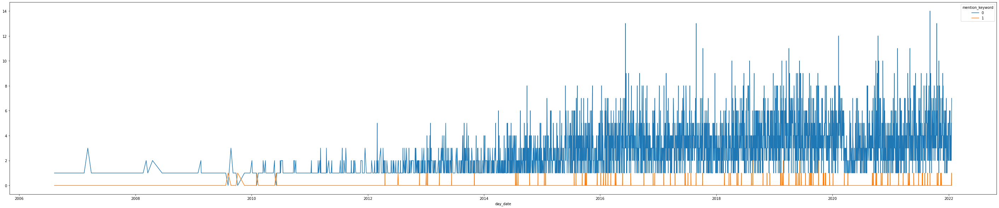

0.011442979053529869


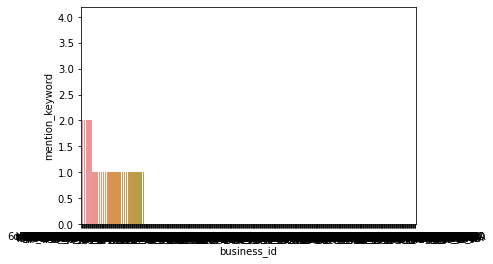

5069
2
116
116
(-0.5668019376508648, 0.5708487539918857)
mention_keyword     0   1
stars                    
1                5224  76
2                1362  18
3                 985  13
4                1084   8
5                1539   3
Subway
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009761167909264096, pvalue=0.5232968335732184)
                   review_id                 user_id             business_id  \
0     Z_tQ-hruQRU45Rg3XglyJQ  9wymgENHBBOm9Tlx7xHy7A  HZtkTPfSshfRjpQR7x1Raw   
1     40lILqNR2Wz67EC5PMW8Ug  6iNK1hUkEljpdUp8S85bwg  WaP_umj3dFLzYicrOanRBA   
2     eSF-_iS63kRrlQ8Qul_9cA  qT2W8QV0YuuUy8tUXZ8jeg  swKXtO22QjVIZTBU8UP7Pg   
3     4wNMdKSqUUzfoXv6-Q1DWQ  WisRT3bV_ed2BuabSPKyjw  EwblShAzTJ4Op6aJZYYuVA   
4     MdsSdcnMLU89IEkHxkNofg  Ug6Djz3endu6XHg7aSh9yw  BQdg19sukvw90QJ4tbY-BA   
...                      ...                     ...                     ...   
4273  i3yHahuXRxPhXI9G8

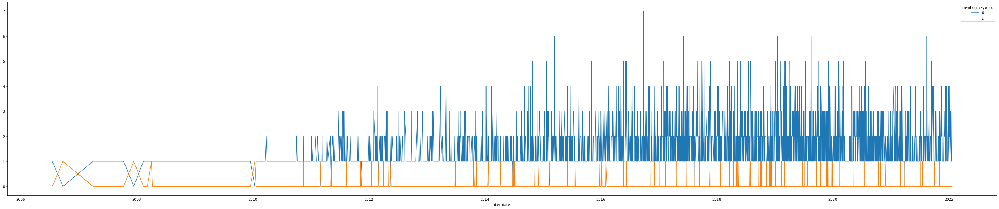

0.019869097709209912


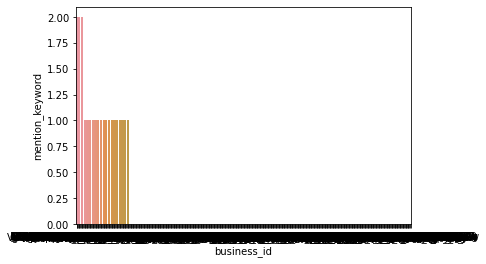

2072
1
84
84
(0.5423918186022922, 0.587548614545746)
mention_keyword     0   1
stars                    
1                1838  55
2                 487   6
3                 442   7
4                 529   9
5                 897   8
Taco Bell
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0003336598030490639, pvalue=0.9752675099232205)
                   review_id                 user_id             business_id  \
0     Ax8lbP7yYV_Ag2JwK-LorQ  EJqV61HlYmFEmzcIaRVVOw  tpSeNezanZDvsXWR7Hhi1w   
1     Um59sqw4ulhSmAfAuYwpeA  7ajfMmBJGkFU1kTur3DkkA  K_WZrMHAjqZ5DThAw4ZKMQ   
2     9O5TrnTl7OftHl2a7bQGOg  BGqAuyW767YnAQU1qOeV3g  X8k7N03buo2bBbUUfcAltQ   
3     -Xm4_Mwi3P5vfXYlOJA5tA  Zsdee1KEpMwjg5cqx-VWrQ  FZCj995CEL2G-JTiLC3Azw   
4     R3AtZ63S87-sAzAFpcia8A  1EJYgQ-ja_UbTWR_FDj4_A  fXsdsGnTntaRWbfUxP3wXw   
...                      ...                     ...                     ...   
8631  gEYRMDv_Jg0XgUUEw

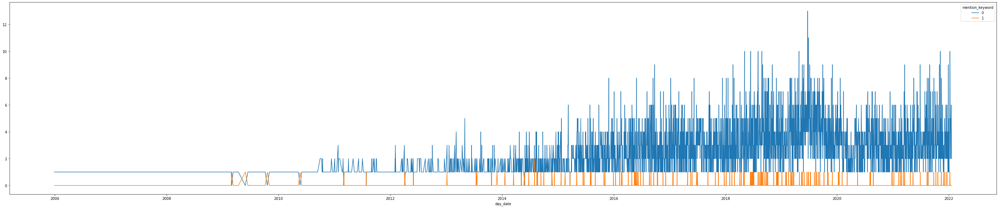

0.02014821676702177


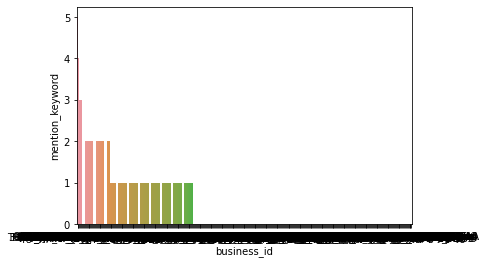

4185
7
167
167
(-1.9072530821497085, 0.05648782262025015)
mention_keyword     0    1
stars                     
1                5000  126
2                 849   19
3                 699   15
4                 717    8
5                1197    6
Burger King
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.004028397965982934, pvalue=0.7649714593814494)
                   review_id                 user_id             business_id  \
0     UZwKv27kcfZTBBiYZIKWnQ  6s5whJLSvZFIF0Am4RyjUg  baHb5T01_MnnhQFHRCR0fg   
1     HHy9yIjW07VHUE6nXVbsVA  UOV7iMHErlPc59XyJQpXuQ  LACylKxImNI29DKUQpWuHw   
2     9tb2DMVP155G2bG3YsF-1w  8474DneUCzxx_YWmJvGxTQ  bKiZJTI0-zrH7n4xM5kHcA   
3     04aDeyVDbw7TcnLnNiCoHQ  5Nyj9RARZbQuSkLOzu3HGQ  baHb5T01_MnnhQFHRCR0fg   
4     w7naLHJBrpxQYcoG-0quIQ  WcQ01IBbW0ID01EE7bdH4g  bKiZJTI0-zrH7n4xM5kHcA   
...                      ...                     ...                     ...   
5505  w8jZN

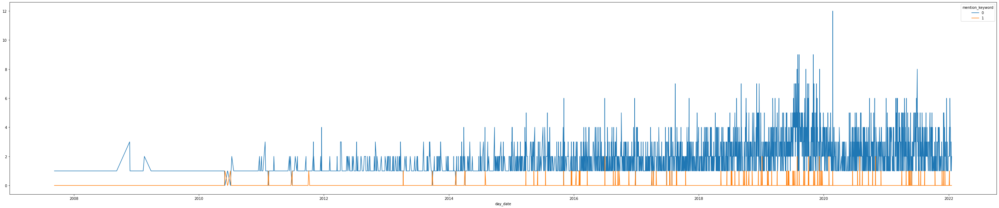

0.020508166969147007


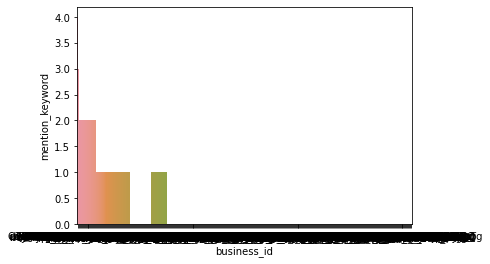

2669
3
110
110
(-0.4587668474876717, 0.6464016042977156)
mention_keyword     0   1
stars                    
1                3346  91
2                 555  12
3                 468   3
4                 443   5
5                 585   2
Wendy's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.022463932011440948, pvalue=0.07240408756260372)
                   review_id                 user_id             business_id  \
0     a32cWIjFXAuKHz1hP_kkFA  dMrmnopCJ0xxEuG7WMCtWw  _TANOcxwIOmQhk1mnXaj7w   
1     wXcsMgO27jDlr_8xuhn-pQ  CqRAt1eogaHCBBtF_shemg  ruFtZKwlJASx5BTk1dh5AQ   
2     S-uET6w58-JoA-W39G-ohA  NsMx7FwsMmylYqHcLWbU3A  qyOUMa4Ol1lFnoZZ8lN_hA   
3     FW9eB5tk1gRSzFLl_aUJcA  3Hn5PexeY0tir0uFWk4jJg  ruFtZKwlJASx5BTk1dh5AQ   
4     BThO72XIzj6tf2hRkavttw  DVaXl3U52I92HuQsw0eCqw  L5LW_wN6Z0JV_vKe2jnsBw   
...                      ...                     ...                     ...   
6392  lBorz_e4sfW90At

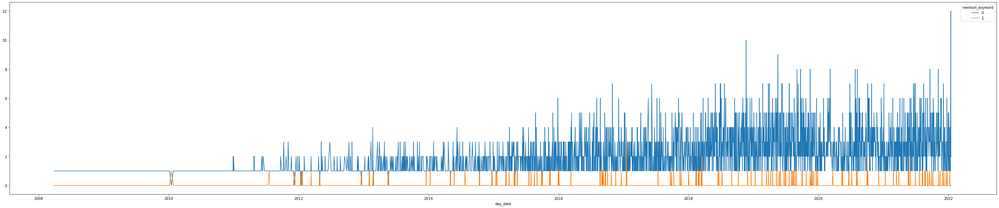

0.022041581991558545


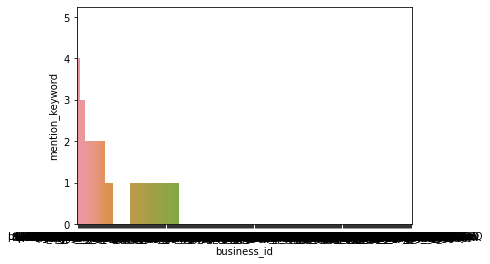

3093
3
138
138
(0.06267239297242676, 0.9500273813802215)
mention_keyword     0    1
stars                     
1                3783  115
2                 771   11
3                 550    6
4                 502    2
5                 650    7
Domino's Pizza
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.012965002243829881, pvalue=0.2945249844394991)
                   review_id                 user_id             business_id  \
0     _1rme3go3F96nwAexBZEGw  ZEpBNNP_btQrZ5qaByoZkg  LGqiubTmpJ-A1L5n7dmc6g   
1     bg3TAimbMppppLUTfN46nA  R9VOYcIWbNA3Q3qiWF2SsQ  EIlFs8kybcG-l60GJjNUIA   
2     3HCYKdFJ_PYkxFOXp8KTFw  pKEkGqMBa70fc_CM_UNySQ  QEOauqqX1vsGcJeN0FwyNw   
3     ZPABFFlF6tjTRCSKx368WQ  iSDCWxF-7UDLThmJxVZCyQ  7biQIoyOEMcBGUw106UeOQ   
4     Qprk_b5tAJ_d1nVFtxlRpA  fOU3GfTHAR0imz2huFSbvg  cwSlDlrmK1qlOWH9zDuNKQ   
...                      ...                     ...                     ...   
6534  vI

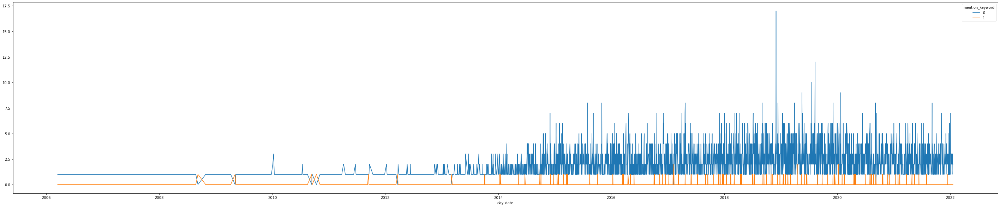

0.017128001223428658


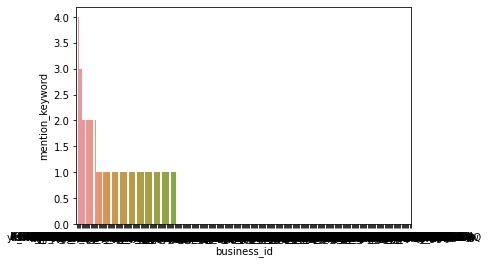

3183
3
109
109
(-0.7963213158700886, 0.4258452991143036)
mention_keyword     0   1
stars                    
1                3791  94
2                 552  11
3                 403   1
4                 588   4
5                1093   2
Pizza Hut
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.011911330325084273, pvalue=0.4103181129030674)
                   review_id                 user_id             business_id  \
0     VmVf4S6FBwOYGSzAZF_1gg  dcukhUKHv54TYJgC-B_6_A  RsTF2skxLcp6qo9FdnA5PA   
1     EZnhTxftFP8HJ-Tva_3T6A  5rVH3p45evCxca5JRNUUFg  JuiFuyPw2yjWiPpi3HXJ0Q   
2     xYULOAQKDzT8xF3RkIeu_w  xkU3TzMOVK1nnHN2sL9O-A  2kWw4GEEZdSPuTc6KV_aRA   
3     ycw5nyYS8BWAddUFS8EZFg  -dN3ww2WYLkwAbZtJHcLHQ  ttevmSPHu3dHUHFXBpVX9A   
4     XIIct3XhC6Br00CxPXteyQ  ey5tvSRod9Hsor_fw_jCEg  T8lxi3V2avTVXCanVkAFNg   
...                      ...                     ...                     ...   
4775  7mYjWlS-4xEzkca

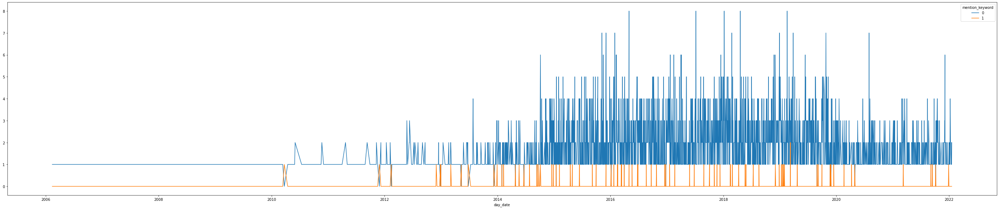

0.018200836820083683


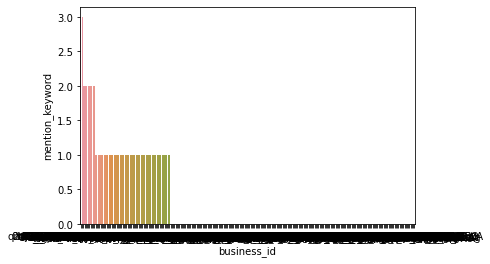

2325
2
85
85
(-0.3380997201055867, 0.7352880414599854)
mention_keyword     0   1
stars                    
1                2911  66
2                 514  14
3                 290   3
4                 416   3
5                 562   1
Papa John's Pizza
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.019226137327774093, pvalue=0.2838607524960493)
                   review_id                 user_id             business_id  \
0     6PN2cvx6cCrEXGibVmdhnw  -OCbPl8jDXA-RzGjaQdEQA  p7C2l6MyJLq9lKMmUhjqMg   
1     BwGjjLjT45OydGK2g0u4sA  MbyhVYGv2YHV5b92kzuIFg  p7C2l6MyJLq9lKMmUhjqMg   
2     Dl64LJ6faNzp_hL098-68w  P3WoQfRpKDjxoNspG-7ypw  n88rreifvghMYJVUaWMUXg   
3     WKFeVf4ssE53T4HayrADEQ  ab_ENpYvkFIEENV9jEosqQ  -e25gkrazUCBqcSdgsmHGQ   
4     8VRvqLQ15-8MACYfBlX4aQ  cRtrGYeq2aQBvkMTCUt29A  -e25gkrazUCBqcSdgsmHGQ   
...                      ...                     ...                     ...   
3104  49u1xEOd

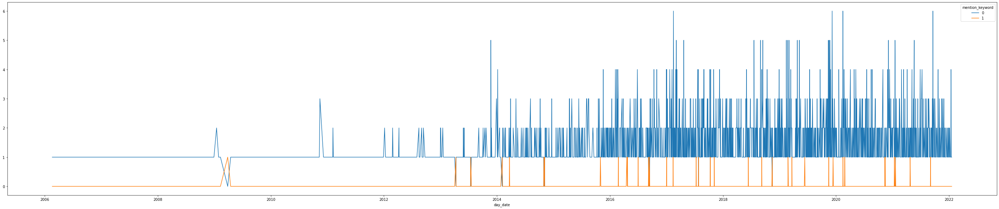

0.011579285944033452


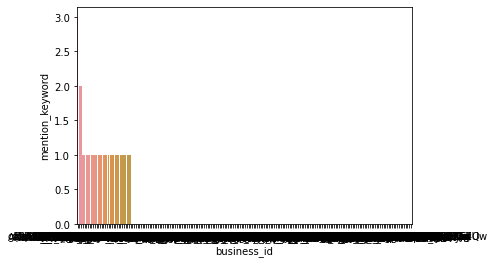

1527
0
36
36
(0.6577386331774839, 0.5107060931099427)
mention_keyword     0   1
stars                    
1                1627  22
2                 312   5
3                 225   1
4                 301   3
5                 608   5
Jimmy John's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.012724128135132379, pvalue=0.3890782810669762)
                   review_id                 user_id             business_id  \
0     Y-FxkPJQiAkgC5-WummstA  vx0Hkm2dPnawQBGCso3__w  pk7E-3G7Ij39h9HifNz0TA   
1     P2VthEuorFQa3KQmtZtTwQ  vQpf5yZJl44SCwrZmtTEqA  0wHR5cCTKdCmimhp02cQFA   
2     L4WvY8zRCnuZqG6Hx3wA7A  3VQgahanz35nWEfDDTVrUg  1wC41D8PLqOldFPUVAZ3tA   
3     WXRlzD3j0jD5aPDZJ7H1Ow  uRFHwwNyJmgkWsUdApfUkw  J3sbnmR2lgGccg8rjYPzzA   
4     ci0yPDPMU-Ca0MMK3pnZ7g  FfqnMS16PhYcXucWnIscgA  sNDXKUS14_xXdD0fJdw23g   
...                      ...                     ...                     ...   
4579  RUJv1lXPMu6Jl3F

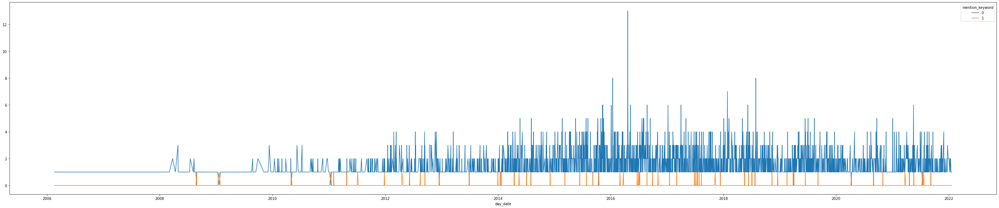

0.014397905759162303


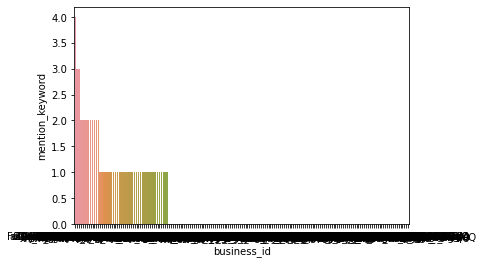

2243
1
65
65
(-0.05196311139317521, 0.9585580865271539)
mention_keyword     0   1
stars                    
1                1406  27
2                 616  10
3                 507  14
4                 851  12
5                1138   3
KFC
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.009589098172542599, pvalue=0.5955863650361845)
                   review_id                 user_id             business_id  \
0     wWD0cnmUjqFUfs6BEiDwXg  sDWEBT3IcBAqIqb6Ttlp3Q  1ol8rghO_5m0M5WFMv-C8Q   
1     22ktCUgPcosvH2RYbmQUlQ  0hYyNTbz7qxfSvuAQ_Tesg  0xe81EigRw_b5W8tg0Ca6Q   
2     7hg7Q6yvDmSKKz1JoJL9DQ  VG-toQE2YcjDlmgvLni2ew  1ol8rghO_5m0M5WFMv-C8Q   
3     YGeKk1hEAu87_jvYdoCSSQ  5YunAjG2P9GA6XTJPosbBw  cLY7TxgdJCiGrD2C8DMEew   
4     D2VvAZN1GdqLYBjQZF_ndA  fURMmxIzYHGOtvP2-7huCg  i2yCrMQx5soH0jMFG32vxQ   
...                      ...                     ...                     ...   
3061  QXILCmRORFIoY19Jz3Mpww

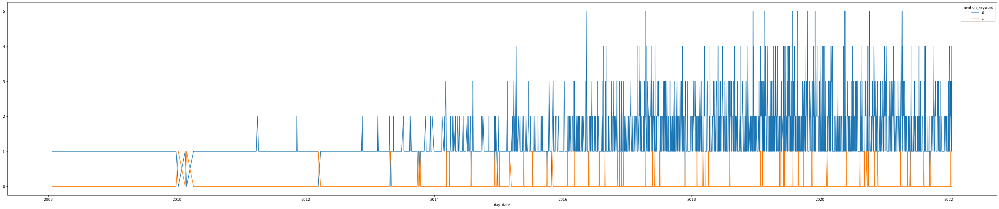

0.0228310502283105


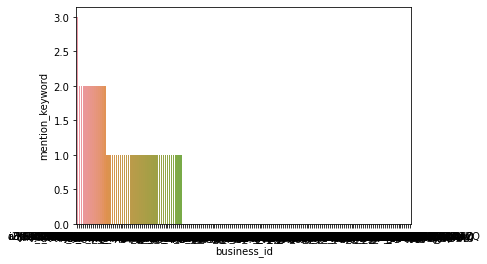

1481
2
68
68
(-0.3264218480545746, 0.7441052096496841)
mention_keyword     0   1
stars                    
1                1969  58
2                 327   5
3                 218   6
4                 208   0
5                 274   1
Chick-fil-A
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.014364159373417465, pvalue=0.18862975097001866)
                   review_id                 user_id             business_id  \
0     9IG9eB3K-RdIonPBuZ0psw  t2IL-HIXQKd6iZ6cIY8kcg  jOOOrH5n2ijnsZKxzPSAiw   
1     VE11x_UNVxri3ZHTzcG2jw  R1GU5Q3aw7Vkw5HvqnGSfQ  ugNplY4SZqIfP417oUxahQ   
2     N_Wx1OLMrj219D5nUMqtQQ  dEvFqqQImRAaE1dT5wYMJg  h3aPn7WjxYMu_DJqXCUAjQ   
3     2__UfAStiRsCS1rebI-fVQ  wXEDeyiuB5sXl12ci7oStQ  ugNplY4SZqIfP417oUxahQ   
4     1QLYrShH5sCsB3f_OenAcg  SH1dIv_U2OMnqRIjBUB0SA  jOOOrH5n2ijnsZKxzPSAiw   
...                      ...                     ...                     ...   
8373  9eZ_mpSDnenVQ

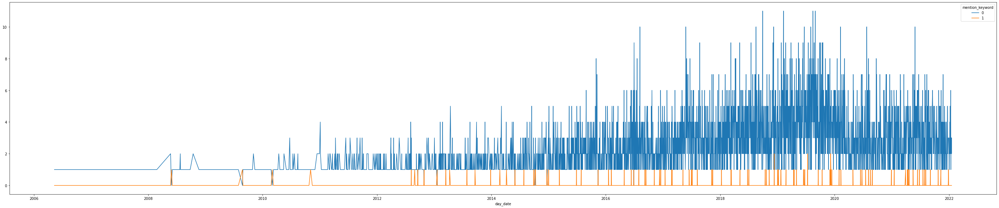

0.012532824063022202


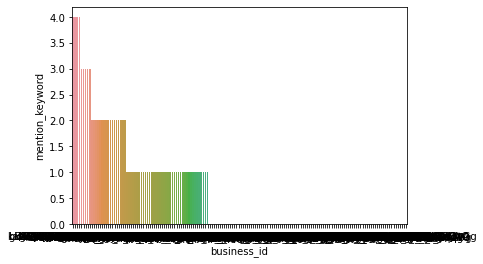

4117
2
103
103
(-0.6053018958238883, 0.5449784219851186)
mention_keyword     0   1
stars                    
1                1915  52
2                 857  15
3                 766  10
4                1273  17
5                3462  11
Popeyes Louisiana Kitchen
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0014141859000585642, pvalue=0.9187932432055407)
                   review_id                 user_id             business_id  \
0     YoLTbiYBOmSUgFCpJ_oHyw  N1UDQ8bQPAmhx5LpPTDcrw  mcwiecpP3n5ED-8xKF5_1A   
1     w6z62PHpT1-xz2pSWYWjEA  zU4gMQzFAB-Iil62f3R75A  mcwiecpP3n5ED-8xKF5_1A   
2     eSQATTmmx1j09oMdTjLB5A  6Rd-Oz0Iqns4_9NIhG9blw  MTjS4g__WMgA-PPMjCL4fQ   
3     RXPfhiAjcfW-jncNfwbtxA  1GQvA_ADZ1USPpHaVU1DWw  Kpw-RroI7wg54SFxRJXnsw   
4     2sPjt8eG3mCAPd6nw4XXtg  xDaTe_eLG8Q2KTS75zvxIw  NsbA31abl8CvYFs6P6kpyw   
...                      ...                     ...                     ...   
519

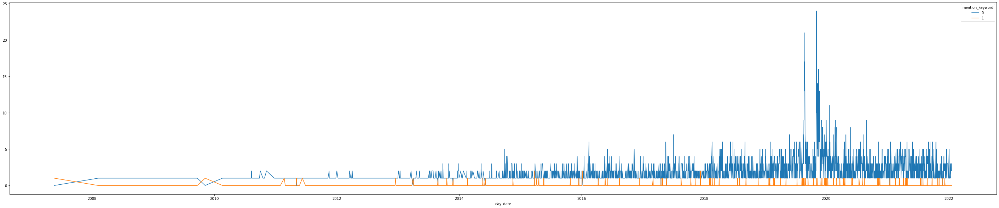

0.02076923076923077


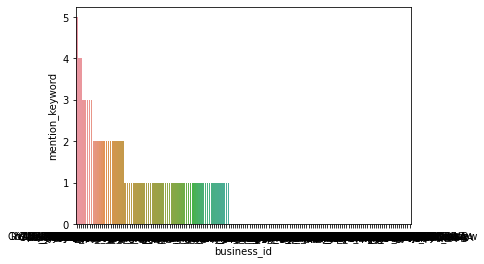

2518
3
105
105
(-0.5172874192747505, 0.6049555349512623)
mention_keyword     0   1
stars                    
1                2905  81
2                 629  10
3                 468   3
4                 497   7
5                 593   7
Chipotle Mexican Grill
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.01266711927735485, pvalue=0.21075162840475112)
                   review_id                 user_id             business_id  \
0     onlgwy5qGDEzddsrnIvtWg  pYXeL0RCqus2IfhthYCOyA  W7NxQw8UYFR0HLPrI08tvw   
1     V8dVnEHMdDNxCX6yFFam2Q  HjMKmLryj5emWPXcpBvt6Q  L7i_5DydYEKwPLfcDBRYDA   
2     -xvk0ycCuDVq4qEalW2yCQ  9C48_ifO4fXBiHsfXebb1w  C3Nc7EUqo64jRPWPn6vY9w   
3     Ws1qBFGyxa-vnkUUnTd7uw  yJRFIA3-JOjOxLloejG1Jg  iAP8eZ847uCHLS-r81jUFg   
4     batVbBszzQuw3LNR10pETw  BrhwZCoV-kd5JbV8G6gHLw  AmnnsJq4Pz1jJUFzHwtsOA   
...                      ...                     ...                     ...   
9758  C

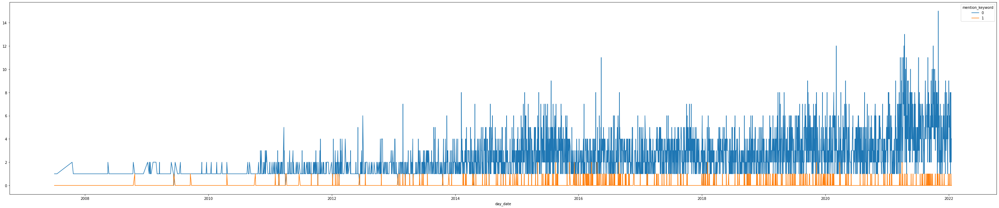

0.032776810406637304


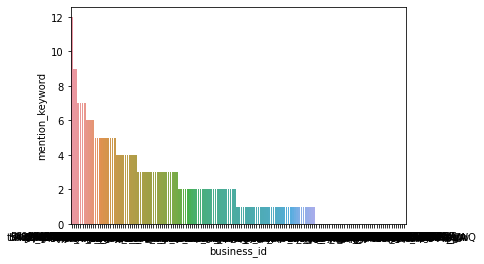

4636
15
305
305
(-1.4413090778599862, 0.14949738381957037)
mention_keyword     0    1
stars                     
1                3923  203
2                1464   38
3                1063   35
4                1380   26
5                1613   18
Panera Bread
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.01606292202941649, pvalue=0.16242435030644503)
                   review_id                 user_id             business_id  \
0     BiETNEHMCcmUWQDJMHQQqA  GNPPfbW6VzB3wjo5vPO5ug  kgeiJzWSiXPnf-3wx7LHIQ   
1     4DFXlyM4wJWzHYwjxLVv7g  tKSpEnWk9DARfElXZe8kbw  kgeiJzWSiXPnf-3wx7LHIQ   
2     BJBCO_KP4o0jTBCl84nuhQ  x5hVkd7eiXCeMI8VqmEPQw  K51bVqlGcpTMDK3-SDkBeQ   
3     iFRIf-_U8cIW0rC5tMBmMA  Ys_kEuS_EBAJB_NGlSA0fg  tP8wd-9CrI_RkHK424oifQ   
4     aoth7teo9RWecwGp1wlSvw  ERh66eWeg5pQkA-vWpmx0Q  0l_njS4wGMadAk1b4nZRUA   
...                      ...                     ...                     ...   
7560  1t

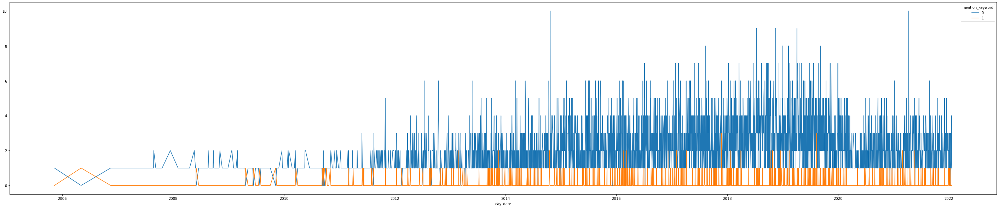

0.05208195637805684


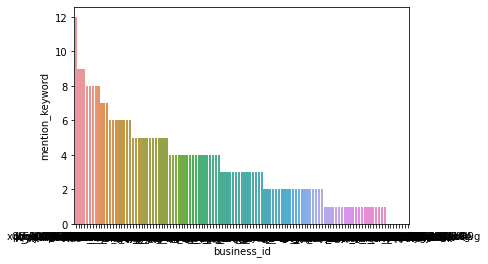

3500
25
368
368
(-1.276900808092994, 0.20163726882263822)
mention_keyword     0    1
stars                     
1                2330  100
2                1303   46
3                1079   62
4                1348  110
5                1111   76
Panda Express
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0025695898344005944, pvalue=0.8711802461238898)
                   review_id                 user_id             business_id  \
0     T_cL6Nk_W-H5bH0BwL57wQ  XOrq3ZorrmuakaWKQAKJ8w  q2cgYLHKRaujrQgSnqJPTA   
1     BzSmRmQTQhLkZrOStalnqw  XAlgPQYihaK-r3ZsKNYVcg  UKA2eeAZmO4ACB2J0kFISw   
2     rpeY-YMv4yfcAfM71f1N5w  4A1DHbi0g7agi53yzGUoYw  UKA2eeAZmO4ACB2J0kFISw   
3     WhB-_yrPorZl_wtYa5xY5w  yXynaFrGECLMJ9eOtBvojQ  q2cgYLHKRaujrQgSnqJPTA   
4     Koqp4Z9lNfcgrrHoKFjv0A  V2__oIIoNuhoPQZcbeoO9Q  UKA2eeAZmO4ACB2J0kFISw   
...                      ...                     ...                     ...   
3980  Y

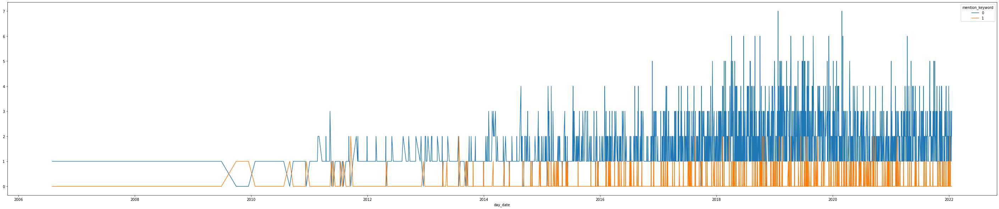

0.07352572145545797


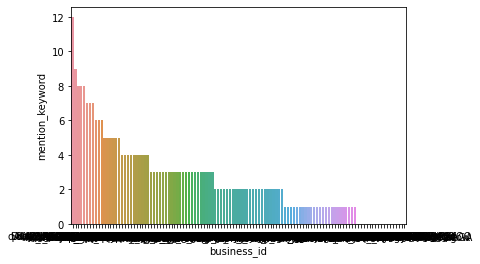

1779
21
271
271
(-0.10635076862362318, 0.9153040524149062)
mention_keyword     0    1
stars                     
1                1524  159
2                 597   43
3                 455   32
4                 525   40
5                 591   19
Sonic Drive-In
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.017115952173569524, pvalue=0.3503716226423541)
                   review_id                 user_id             business_id  \
0     4bG4ZrLsspDKV06DxoCX4A  t7ZTe8DkxQNpvvLTjmtUpg  O8RzM_uLVEnDWEhX3whqtQ   
1     aOe4_H3JLUvzI_0rLobw8g  c7uJo0ABJN-aAq9yZ9-amA  HlSve6o5TAXbl4UDwCfcFw   
2     5Bzkgd5ppjvreFPIW-BXTQ  T6cTV5Z7Z3QKX5ijV3IhQg  HlSve6o5TAXbl4UDwCfcFw   
3     BNRsZm24wmecKYjMjvHxrg  wB8X7GJVQtNQs9ofuG2vlA  pMX5P_cDFqoo_-ZBUP-UOQ   
4     H-djqzIn7K63a88yUkWQZA  dMRWPe2wfR3qJGO1okP2uA  HlSve6o5TAXbl4UDwCfcFw   
...                      ...                     ...                     ...   
2974  X

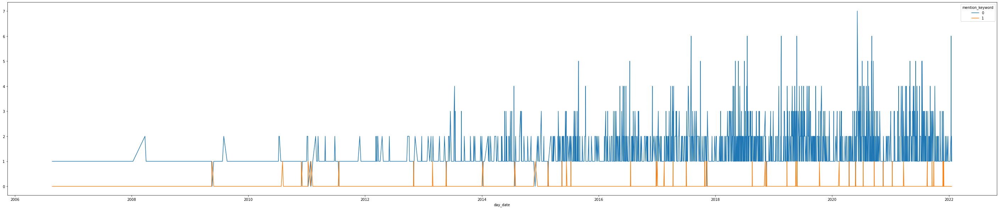

0.01544142329640819


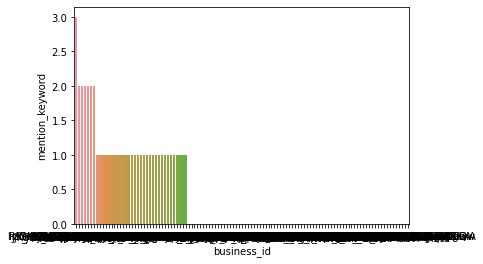

1456
0
46
46
(0.8606345185258081, 0.38943936817420277)
mention_keyword     0   1
stars                    
1                1481  30
2                 384   5
3                 330   8
4                 355   2
5                 383   1
IHOP
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009616045116684305, pvalue=0.44027336676894124)
                   review_id                 user_id             business_id  \
0     b7-Wi55KPnDFiDbQ3nUgFQ  q5g3dj7DJAPks8p4vZUsHA  3SHw4aZW_muE1kRSLQQjjA   
1     JXIrnBiSMI1weGNB7X3rYA  yhFJ56iFAmpPbT-6mHI2mQ  jx08bYW9trXnfdw9hAEoRw   
2     8xbioBTOEnYDDA86dNwDQQ  ZdODEy4O0-nPdPKwkdQkdw  g79jYJz3FEvgvglXqOUWxw   
3     XqKj9-Wdvu0IgfoYx291Og  hUGdWR7fLECh5aNg6pJOzw  zie_uvy3ln9rdTvA2e3gUg   
4     VYG48wer27lsbOE51Tr93g  xnfIF5cMnSJVVcMRff0DcQ  BJBSwMKADtYjqFDCL3-zkw   
...                      ...                     ...                     ...   
6438  09COU8ktqaPpDetCtEi9

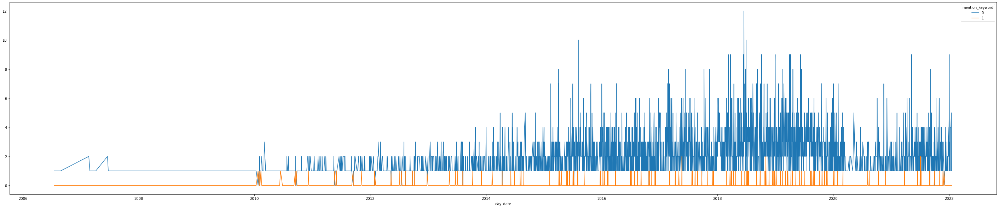

0.022349837032438306


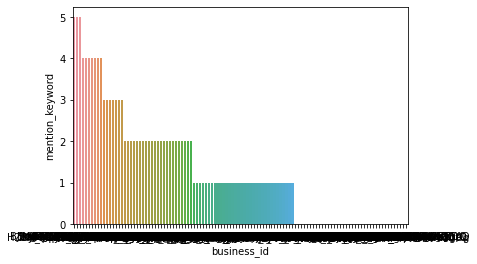

3112
4
139
139
(-1.0175433223900212, 0.3088950340828752)
mention_keyword     0   1
stars                    
1                2707  87
2                 848  22
3                 832  17
4                 921  14
5                 991   4
Applebee's Grill + Bar
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.005879618236907589, pvalue=0.6449052959717029)
                   review_id                 user_id             business_id  \
0     WcCEk3Q7bgIynzgq0dgTNA  n6rI5T6klu0KCz0q2tS9Ng  c5QMFe_yhgksThaR2a6rtg   
1     y6WdYTSR78VEgFvju_7CYQ  ej4kPMsfm3sEktEekcPW2Q  qOdsOVOM98hHj1SCRscjHg   
2     _RY_d-PAKawrga-_hha5UQ  gbg_h4hkvANBKhPWCz6ZnA  haTwYzufFqFb2sq6CHwOEQ   
3     K_J3aKPiNQ2onKCblbOFtw  anSyQUX30dCv5B3bVLUkzg  haTwYzufFqFb2sq6CHwOEQ   
4     uGyYy81ZvBuct63BxSzVEw  _h-2HhgEN7i327njrJvBuQ  c5QMFe_yhgksThaR2a6rtg   
...                      ...                     ...                     ...   
6141  LR

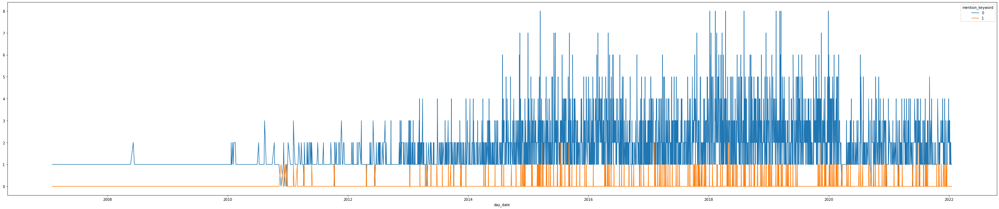

0.04116498535632932


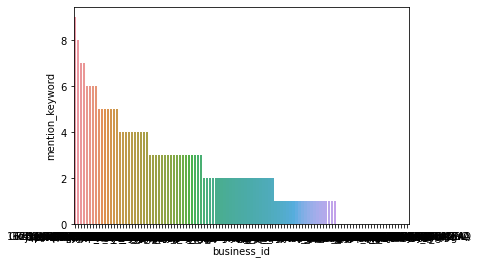

2878
8
245
245
(0.7811153587091676, 0.4347346494442542)
mention_keyword     0    1
stars                     
1                2365  132
2                 927   51
3                 819   37
4                 853   20
5                 929   13
Waffle House
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.011303462490254029, pvalue=0.5154419654333823)
                   review_id                 user_id             business_id  \
0     v5tuBGThz31Qywa50jL2Tg  fm1oHv32DvYmpzFekmDZIQ  xDqifhzRrOOYMOgOtWvyWQ   
1     p2va_14SWyWMm-9PPv-aOg  SmaAK6il7pyldoqZrH7iTA  uWc9h19N2G8cR7Vo5blL8Q   
2     nx6UliIGgx0bYAMU12X9yw  YO93KKYAKxnM9ypngw2-5A  DUn-V3XYMeSTxwEELMn7Tg   
3     DwuG-PV0EA2wvB7dH-plrg  mBQMR2FmJNA-x916xQjHjg  4LuzS6VevvwSmB71KbGyVQ   
4     7IgLhV_yaryvcqkiDVPQwg  BWZfZSRjNqoUNA96ddb0ig  xDqifhzRrOOYMOgOtWvyWQ   
...                      ...                     ...                     ...   
3308  tL7kT

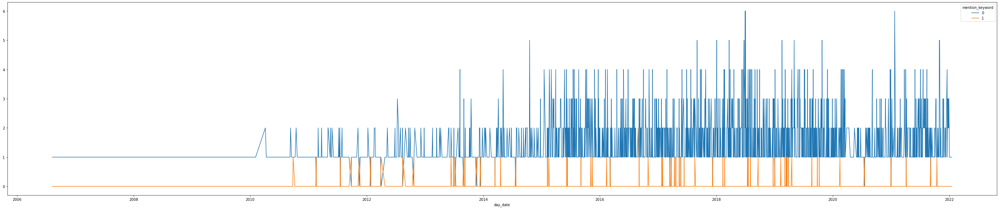

0.01992152127980682


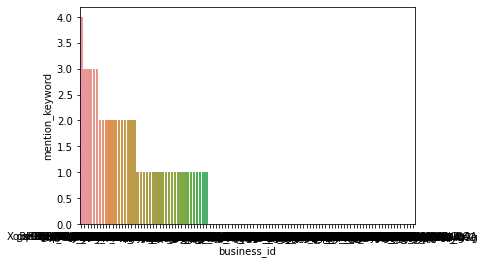

1609
1
65
65
(0.28118248326807455, 0.7785704392266923)
mention_keyword     0   1
stars                    
1                 748  29
2                 275   8
3                 366   8
4                 713  12
5                1145   9
Five Guys
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0025300160653310335, pvalue=0.8647205350042818)
                   review_id                 user_id             business_id  \
0     6X6GqoEw1MzYuUFw0vcrlw  qqPpgrtXxKOuRi15wa76Og  MYMLQfzRv8x7aO-bv9vpFg   
1     Z8QK2IxsNt3Q6VX7ex4QXA  DDjHoGITEKKgZZAbN-F_iQ  Q_4XtUDxWDasRhORDaC-jw   
2     520SOYBUwvwYwCq6DHCAMQ  0sAUF_yzU7nlac8Hg-FUvg  Q_4XtUDxWDasRhORDaC-jw   
3     48IJsrTbwAMSAV3ZB0WVrw  0bnzoCEmFnyrQQrygI3FKQ  4puDEkq0E27Nrq5nQiVqzg   
4     nt9Y8LfkDpojmPZ-w98NtA  jcgl3ygD81CP-runH1UYRg  Q_4XtUDxWDasRhORDaC-jw   
...                      ...                     ...                     ...   
4532  YVb96R4RWkbX1dJ1

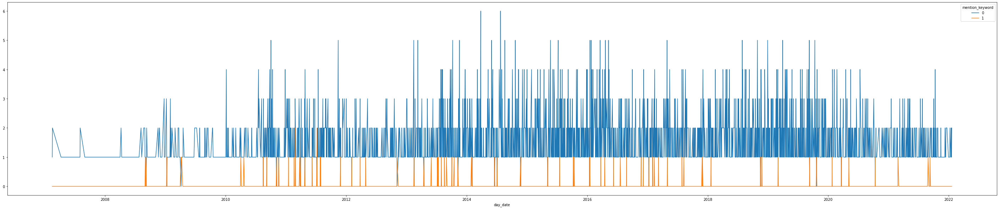

0.017853206964954817


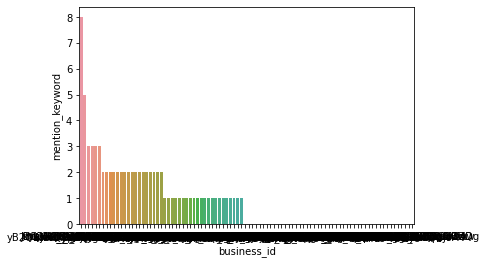

2207
2
79
79
(-0.47040063376036023, 0.6380688114689305)
mention_keyword     0   1
stars                    
1                 554  27
2                 496  13
3                 700  14
4                1243  14
5                1463  13
Jersey Mike's Subs
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0015400552884799624, pvalue=0.9323362358779996)
                   review_id                 user_id             business_id  \
0     Y3g47AccWwfOKRZ9Jshv7w  Izg15b1XjidpIiNJIThuEw  FjGAm10tARIypt5fYGpfqQ   
1     JwUqbBpGq-oJkKHQ1KXelg  tIsRPulDUNFQjR8Z_Id_lg  FjGAm10tARIypt5fYGpfqQ   
2     fSPKb4uySWxG8DTny_fQgA  RQWQTxfhGGJ7bGgJ1EnExQ  FjGAm10tARIypt5fYGpfqQ   
3     0rRTM8DNs0V9sodOJMZgDA  o5ZkBrR5iPKE5G7BBwlyGw  FjGAm10tARIypt5fYGpfqQ   
4     emhuQ6A8XSlIEMEoYeiNvw  1cIiG5velmJimoAfZx-Jig  FjGAm10tARIypt5fYGpfqQ   
...                      ...                     ...                     ...   
3037  XSuN5c

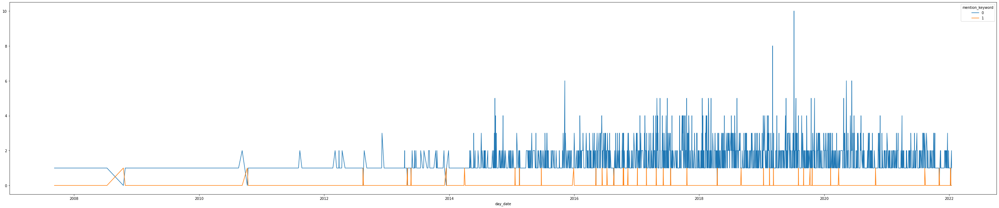

0.013477975016436555


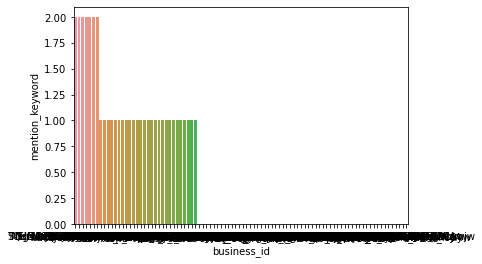

1491
0
41
41
(0.7581010829163106, 0.44839047147268996)
mention_keyword     0   1
stars                    
1                 661  20
2                 354   7
3                 304   5
4                 535   5
5                1147   4
Steak ’n Shake
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.017398149201129285, pvalue=0.16221674679642753)
                   review_id                 user_id             business_id  \
0     2V_v_iC7P6hJDFjbVZy5Tw  mRNk6znErwDpTzDOM5T3ig  R4eAWOt6Kz_rmo8B9FyG8g   
1     o_g_jRoHG-xgyr92-HNdXQ  KNVIA54o4xlzaKiqhJk50Q  4s4KAGJgtpZn9cgtdWcOmw   
2     BNMpYZrom5SQ-g7xUMso4g  cGu3izcZOqsBOsO0D9yZAw  R4eAWOt6Kz_rmo8B9FyG8g   
3     wrflc6maDTa0k35VkkM1Zg  eLW9gqABcAQZjo3Xg6SEAQ  sVWUxesVKseXGq78UwwajA   
4     HN4Ur4gq_1G_bCGrAvIuFg  0V9kMR2AGljsoMQR_JgpZQ  R4eAWOt6Kz_rmo8B9FyG8g   
...                      ...                     ...                     ...   
6450  Xjt057aOCl

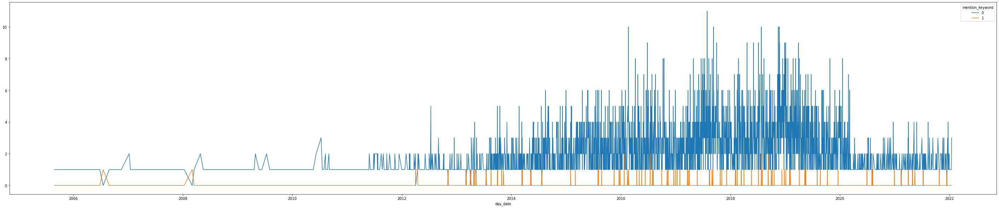

0.015491866769945779


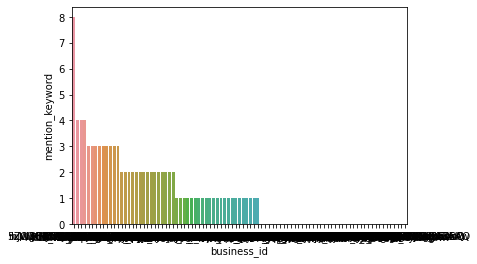

3153
2
98
98
(-0.3688056328808859, 0.7122726057766777)
mention_keyword     0   1
stars                    
1                3512  74
2                 861  11
3                 606   7
4                 712   6
5                 664   2
Denny's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.012602337432976169, pvalue=0.4447085829671779)
                   review_id                 user_id             business_id  \
0     Jg5We7zEV5N1ZlInmLL4fw  5Me93QYZKCP7mp51kxnOmA  Ax5taPtXMnxhUJjFUQHF4A   
1     lYOMJ7lPmB_9wjOjXq1lIA  1izddLfPCE_H5wsUqiEm6g  iD1j5TGvCznNI3YoeTa_4w   
2     QSEMXPGvmxfMcZYHcvdfCQ  bXClhGn35ESt57lAsAjCaQ  IxP1AjJo8yqQM7SeMLeR7g   
3     9fMvQs916OimLpBkBU-w9A  8EaQ8E2ZawuP-Sn4oYyTDg  IxP1AjJo8yqQM7SeMLeR7g   
4     eldXW0rKb1NLA3HiCsKahw  a4S_uNT1IGaJpbspCqv-oQ  IxP1AjJo8yqQM7SeMLeR7g   
...                      ...                     ...                     ...   
3675  A9KZ2EenK6Zu6lCRW3

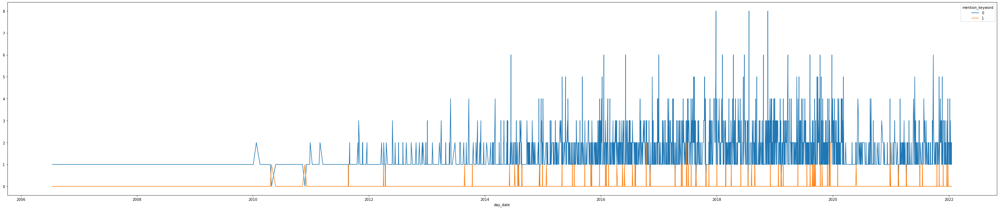

0.023641304347826086


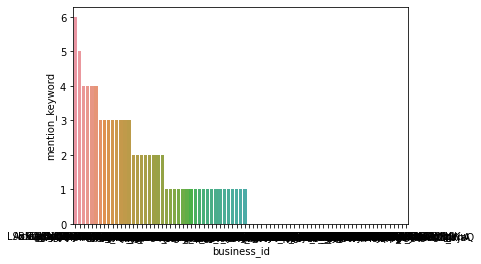

1774
2
85
85
(0.04067398064910868, 0.9675558048586987)
mention_keyword     0   1
stars                    
1                1513  58
2                 459  15
3                 412   2
4                 484   9
5                 725   3
QDOBA Mexican Eats
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0014649501691527383, pvalue=0.932938244493657)
                   review_id                 user_id             business_id  \
0     MSZuaItS46OO_47XmktjcQ  BO1xi6vjg46qcwIfJDGIAg  kGNzqiYKDns-IU80uHF4sw   
1     9SDRSG-MY3z2xtef9YR6pw  T__CyGS2hC3fq51vGXv9YA  Gf1EboxqdJ9SPsVJur93Cw   
2     FNrWnJK7-IiuRawYTMcKlg  SLvhVIW8IunggMhLX_evDg  tBnPLFSvHuyNgurZGN8dYg   
3     PovjR7aLjjunI_63Oz7juw  wxJk4ke4_e6pN5k08LvN0g  jf8AZyiMXd9CFxOg_fTb0g   
4     4ORvxd7JX6dtnlFP2mkfEQ  UVQiONN9JotrRzAZri001A  jf8AZyiMXd9CFxOg_fTb0g   
...                      ...                     ...                     ...   
3297  lw_PnPz

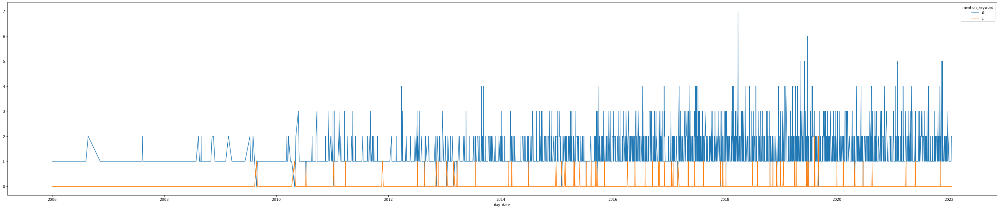

0.022410660205935795


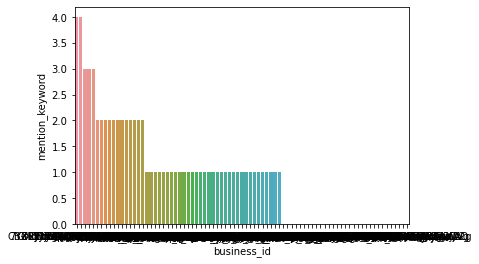

1596
0
74
74
(1.3216821131862282, 0.1862740272926543)
mention_keyword     0   1
stars                    
1                1001  45
2                 525  11
3                 435   3
4                 644   8
5                 623   7
Chili's
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0016723987569837676, pvalue=0.8922324721894348)
                   review_id                 user_id             business_id  \
0     Y30wSqsq-gF0fEiEVDvTtQ  lnohBN_e2qklLESYih9Mvw  a2ITIJRAY4Eo-xTH0vN95A   
1     TsBbR2VuQo2kbOlHVkfu7w  tEtWHKgCezKRmRPfDe1i-A  a2ITIJRAY4Eo-xTH0vN95A   
2     yJwgnIn8XGlUxQjqOJvM6g  h0bLK2d0yRKTOnWYHirmzw  jfIWqMrdWnPNORcDnQ7VNg   
3     _3b2n0mgxe5PLNbN5RZPtQ  4AKl82vqfyZR-SBK1EfsTw  qzCT_X5aTj8SkGpKdBYYdg   
4     fQbAGJDA1NcY0eV5tVvyZA  Aa1cdgFJYWe37RE4dnrh0w  sKQ0KYon7eT6xEnCpb18aw   
...                      ...                     ...                     ...   
6560  TVLuZuqElQo6blVFHwT

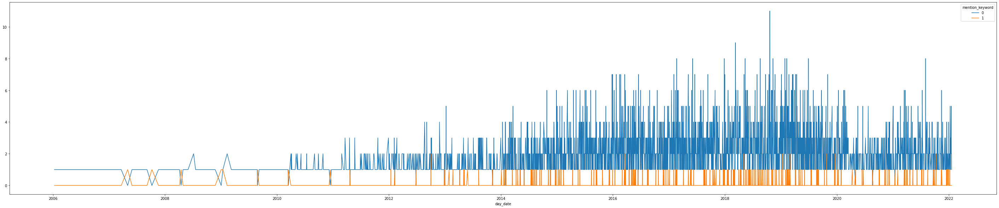

0.03472962680883473


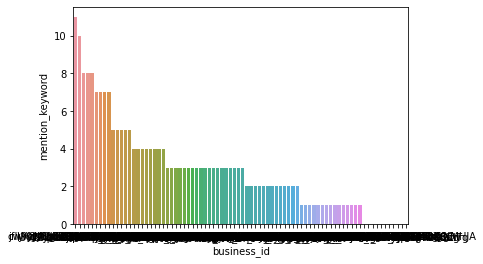

3116
7
221
221
(0.33845809877839916, 0.7350179981090856)
mention_keyword     0    1
stars                     
1                2561  106
2                 960   46
3                 851   34
4                 955   28
5                1010   14
Buffalo Wild Wings
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0020928077991429674, pvalue=0.8576597898842278)
                   review_id                 user_id             business_id  \
0     ilbEXGq_s0Cn8cMMUpxuMA  Jhdk8OjarHCjISYhRvJvTg  ZGErYinCaYR5UjTzovAZbw   
1     DF1juQCUsEjVHLB0WliotA  poOyZqXhbMoWyLN_jyynhA  yNlR9wTzd6Hg7It9fQrhdg   
2     LBzRWwm5OVNHeA8oduWLlQ  lrtGPAmDqCFnbfAKiB4NmA  ZGErYinCaYR5UjTzovAZbw   
3     LF6qW3Zf8cxZIgBK1bqbYg  hk6B1ZdzI62jMGo6e2IuuA  ZGErYinCaYR5UjTzovAZbw   
4     -kJqw8ptJ5ieoTVuHGdCLg  61nr50PqgF4WUWx4r-OcsQ  citzbW-2MVEZRNBqpVO-Jw   
...                      ...                     ...                     ...   
7342

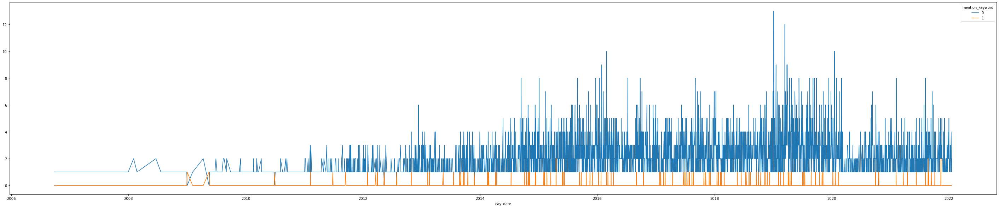

0.017558187015108206


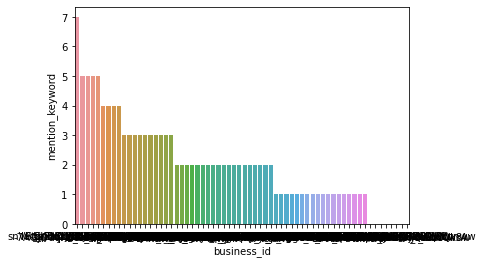

3580
3
126
126
(-0.4980478002141868, 0.6184503513828175)
mention_keyword     0   1
stars                    
1                3076  91
2                1285  20
3                1007   9
4                 940   5
5                 910   4
First Watch
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.015930230582250543, pvalue=0.12415855571020147)
                   review_id                 user_id             business_id  \
0     WM2KflQ6b-ySVeMXQsTKhA  17fHDTdkKk-tcfvUp1LzlA  2brttsiFBlW8070dsPzQDA   
1     vi1XPASJucai9lvyTJeObA  WF-sXnGO0W1gG_iSMXYX2w  2brttsiFBlW8070dsPzQDA   
2     dOMaIw4HlWtmryjOmJNsFg  JUQriibXaA8Wi6UDcAnUuw  2brttsiFBlW8070dsPzQDA   
3     SwsT4cISmKKUgiNe9qh53w  njJjEOLRTo03Fwp4jg_Jpg  2brttsiFBlW8070dsPzQDA   
4     1B2eKekPyJ4NwMXifbo9Xg  lyBWYViVlQGGXT0TjcwE_w  2brttsiFBlW8070dsPzQDA   
...                      ...                     ...                     ...   
9312  LvYz8DDvtpKj

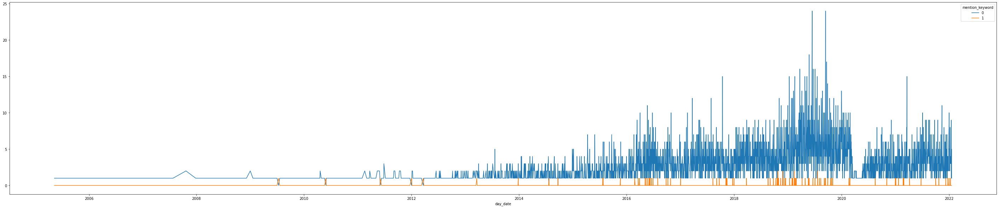

0.010411076526779006


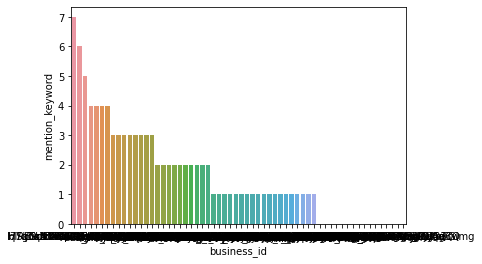

4583
2
95
95
(-0.9981883736181417, 0.3181880231043659)
mention_keyword     0   1
stars                    
1                 782  24
2                 759  17
3                 939  12
4                2216  18
5                4524  26
Outback Steakhouse
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.017941601282957756, pvalue=0.15755300366298522)
                   review_id                 user_id             business_id  \
0     jpThMSnG2zJrhmSnn_PADQ  x5DJdEvWFh1cKBkPO9jNsw  U0ICWpbd1C0GD9SpIv3bSA   
1     QYFIqpXRgpWom4NU0BCLDQ  tOQPJUFMu3kLWZooSsZULQ  z22hSRptt_DS0nWjsIka2A   
2     B556O6ZFS59huvp4Jra0iQ  1A0zd56jS9AFuXFPS5JmUg  m7uGAvkjyI9iQaLJAmvCNQ   
3     Iz36hSAvtdPdnPQQFJtAkQ  JVM3YG_8Ns6dGHalHgP-Dw  U0ICWpbd1C0GD9SpIv3bSA   
4     LFjBP5cFaeVo1bBMlpYaeA  ocSmiCHL5R9bBZTBmk_ryQ  U0ICWpbd1C0GD9SpIv3bSA   
...                      ...                     ...                     ...   
6202  Csg9wo

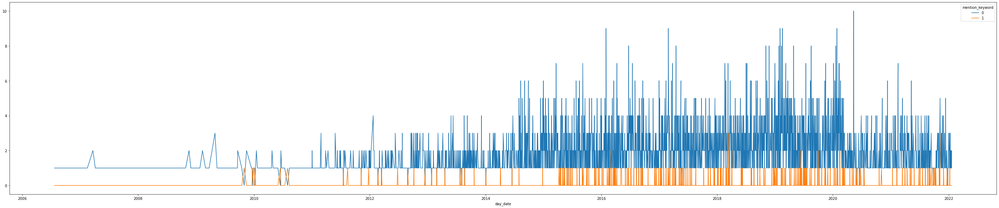

0.03898823908490414


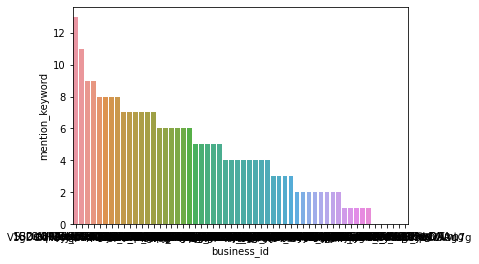

2920
12
230
230
(-0.8697420960791136, 0.3844413616391644)
mention_keyword     0   1
stars                    
1                1585  90
2                 949  36
3                 788  40
4                1131  43
5                1512  33
Olive Garden Italian Restaurant
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.03759212118026896, pvalue=0.006083200587880542)
                   review_id                 user_id             business_id  \
0     WTTZtAEG0NgxswzwS-5Skw  HcGQr1GiPnKavo57waY6jw  4fUok5d5vgdQEb1Bzzg0rA   
1     HhsCn0Zv1my4yC7ooNNmOQ  EVyq9IBVgdJqCJdEpKJt4w  4fUok5d5vgdQEb1Bzzg0rA   
2     8bZmzYSB_nRPepV5xZtOfg  FR6IAJg1Dx7RE1BbEHB69Q  DszOO6k_s2wuGhTw2AsUdA   
3     4pJrpU-V1BiR2gXPiC1Jvw  jQLap57r591aW8xZ8yapmg  4fUok5d5vgdQEb1Bzzg0rA   
4     Q4xtLAUuuL1t-tacaftZQA  lAMh24SC6G9ayTfOwSn5yg  DszOO6k_s2wuGhTw2AsUdA   
...                      ...                     ...                     ... 

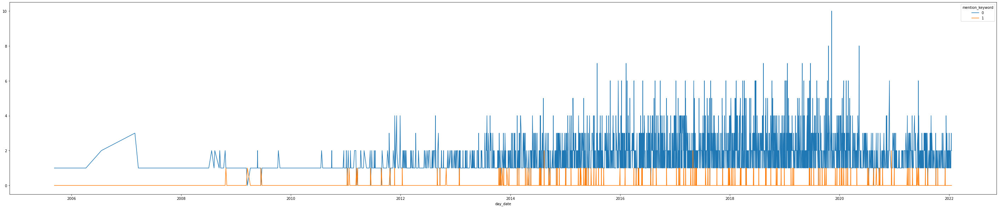

0.030240420736288506


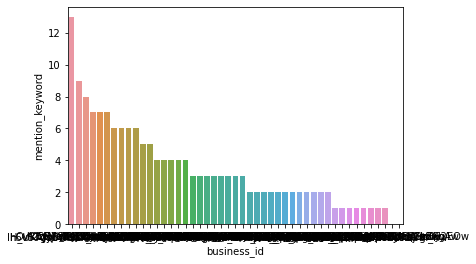

2541
4
157
157
(0.4065916771170985, 0.684307911098766)
mention_keyword     0   1
stars                    
1                1195  81
2                 786  35
3                 835  16
4                1028  16
5                1319  13
Cracker Barrel Old Country Store
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0034409587967914445, pvalue=0.8172200436681968)
                   review_id                 user_id             business_id  \
0     PPgbLBvi34A6m7bKJfTwhw  3TL6HZ1JrKcNTvGDWKlrow  GyC36Pn0Q1-qHnqXys6yFg   
1     Is_4BTKGJTHxLGKRxLD_DQ  V8P2-U2IINNHzALqjaN3gQ  GyC36Pn0Q1-qHnqXys6yFg   
2     r7mKyEcShrHjgPfGNZ52Bg  s_C3YVr2PQ0G9VJjP4cdqQ  -cE9GrThz6HHn2zdpoqY_w   
3     mkgHTEAqcbDht-SGmx00qA  Ex_YPuZengm0H8oteLtjqA  -cE9GrThz6HHn2zdpoqY_w   
4     l8ZgxAuV6bb3Cis7PX2Dxg  -cZBjaI5ShjZfLM9cQQOMA  GyC36Pn0Q1-qHnqXys6yFg   
...                      ...                     ...                     ...  

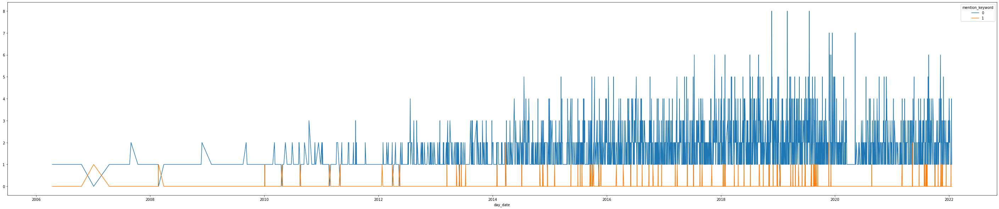

0.023704031900753212


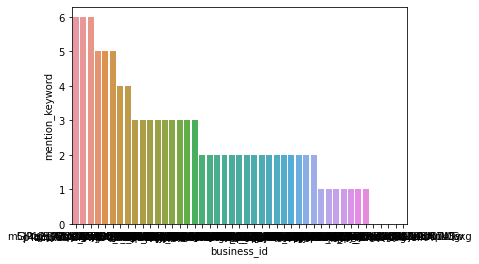

2174
2
105
105
(0.34573429920967724, 0.7295424049901764)
mention_keyword     0   1
stars                    
1                 977  43
2                 610  18
3                 637   9
4                1062  21
5                1121  16
Red Lobster
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.022172001105184802, pvalue=0.17859483215637617)
                   review_id                 user_id             business_id  \
0     f-IU2WuzMRkYGp01webwyw  R-W0T3bemRPqWcm2V9oY-w  OyHbS1sJ4CguExlWa-XWDg   
1     n1o-LQ8Truw3Ld2jSocSbQ  PvsM5t79m6qI-hQuyFAvkQ  i7LerGjkoxNPrlJ1oJpbXw   
2     sBW2sQV9IJh24wPKWxR65Q  g2Q22rvdjTJk5OdlDPq6iQ  OyHbS1sJ4CguExlWa-XWDg   
3     _ZpPcnQbwVwP6F1kHuRHvA  7QmlFgJAHoLfFa0sFCqemA  BDYL4lMlT6fpKgiNlJRclA   
4     5x3DEEWAFGTwOfDoX7xGWA  K7xZwcyw8l3swKOe7KVa9A  G6qbByoO3QE-rft_1J94eQ   
...                      ...                     ...                     ...   
3677  TmULV0aLxEaW

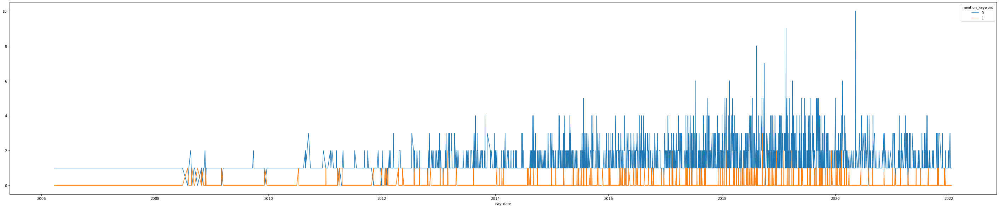

0.057034220532319393


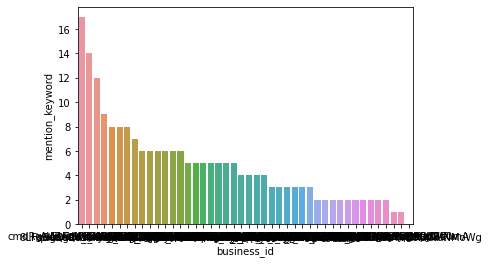

1687
8
202
202
(1.2200920561711583, 0.2224299796204674)
mention_keyword     0   1
stars                    
1                1014  88
2                 551  45
3                 509  27
4                 656  31
5                 742  19
LongHorn Steakhouse
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0042183886391450875, pvalue=0.7935309204730492)
                   review_id                 user_id             business_id  \
0     A3fdb3XAaSB1EKobAjLfWw  W_VNrooLU3h_r-Iw5HLo_w  CS_GzUYlEPa6QHTRY224wQ   
1     6ka6yLrIDvIP5NWeli89Yg  HumkUpRp8WWzrZ57wLcDVA  CS_GzUYlEPa6QHTRY224wQ   
2     b63fKVpSmWoJDRpRQb8hcA  r6GXrPswAqNuPf6u4hkWwg  WKF4p8kLDng4EECYC3RoeQ   
3     n-Oi_9zwM7f6GACmA5g78g  i8-EUsEUdN6vqTPbxv_FCw  CS_GzUYlEPa6QHTRY224wQ   
4     S07QJGQdqcpQ1ZF2QwSCww  vOeDq0HEnIu0c7HQzJsVig  CS_GzUYlEPa6QHTRY224wQ   
...                      ...                     ...                     ...   
3847  hKCGl

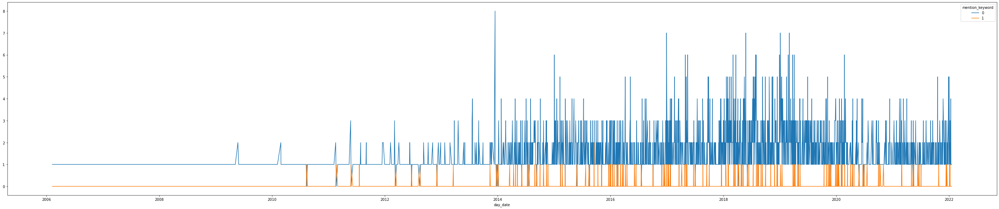

0.04023883696780893


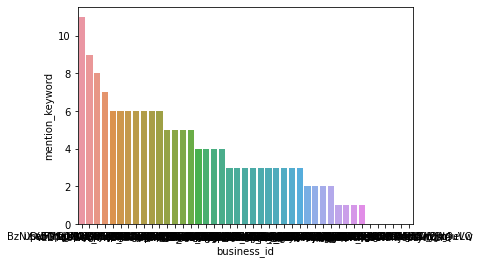

1807
3
152
152
(1.352596650996681, 0.17618452294044895)
mention_keyword     0   1
stars                    
1                 738  39
2                 514  23
3                 551  28
4                 786  41
5                1108  24
Hooters
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.03380851009869215, pvalue=0.055608539648883425)
                   review_id                 user_id             business_id  \
0     UShAuTCPziEpnOqaXNQQLQ  oO63NIB8sLJyC7gjeTvj7A  aq26RY75PlTNsviW6wUC9A   
1     PHHPkcoNVehIR3116FteoA  4P8qDuDy3C8s6Rkm5wEI4Q  dv4tx5H0-aPiIXSM2hJNhA   
2     hfBxst0hK8aeGI3d41N9Gg  -gjIjEvEA2rlypikYsEA5A  aq26RY75PlTNsviW6wUC9A   
3     kQ5EKGY7lH-8HHpHXeOADg  sB3u-7MEaEz8zAI54vVjpA  aq26RY75PlTNsviW6wUC9A   
4     pzCtl9S2oyZMcEaWs6bBkw  _1XBAPI7ayFFVDm06WLWqw  aq26RY75PlTNsviW6wUC9A   
...                      ...                     ...                     ...   
3201  S2hrwJmbYS7s4i4c9

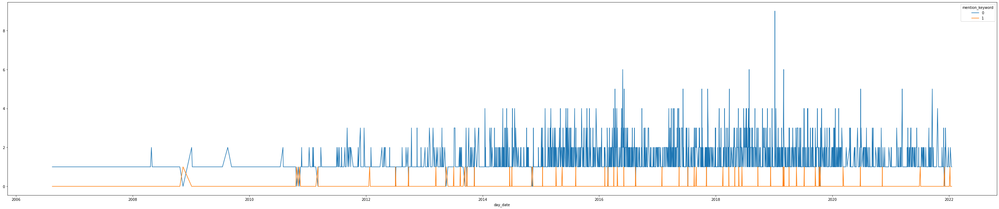

0.017467248908296942


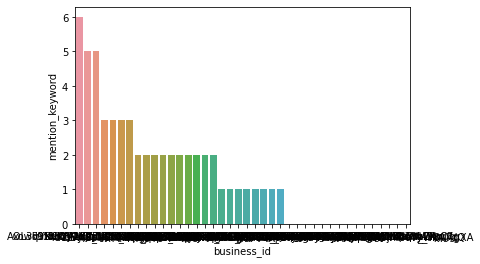

1559
1
55
55
(-0.02256814062027804, 0.9819947574539609)
mention_keyword     0   1
stars                    
1                1151  39
2                 506  11
3                 485   3
4                 510   3
5                 498   0
Red Robin Gourmet Burgers and Brews
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.008095430789918954, pvalue=0.5739467943128838)
                   review_id                 user_id             business_id  \
0     50_IPMsBuclmeMme2r69Rw  NMOxipsnXc6olWdHYzXiYA  MZW_eTFYFBvHYg5OFqDRCA   
1     mtZ0LqbTdkKyjNwPgybtXw  mjDsDnoSghhIiht5cSjF4g  radib3GHt_Up9-zhUjM1ew   
2     2vh3m4lABtYB_krPxweAlg  0qb8xlUlMyvjNjxD6B8NDg  radib3GHt_Up9-zhUjM1ew   
3     QZr0dkTX0k0X6YpQCOgaPQ  B4cnr5d2S_7McR3XBfrscA  MZW_eTFYFBvHYg5OFqDRCA   
4     P26SYtGQXEs1a4xru_PH6g  g2hQWa0anF0R9PIJa524bg  radib3GHt_Up9-zhUjM1ew   
...                      ...                     ...                     ..

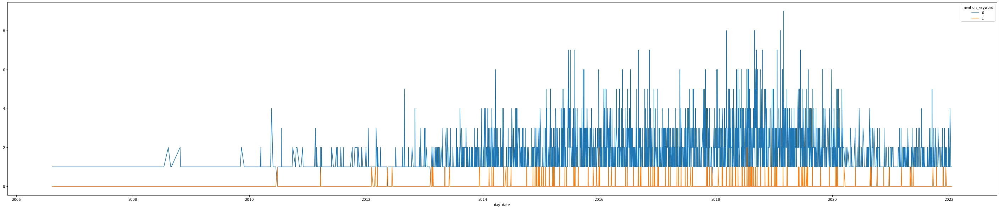

0.031496062992125984


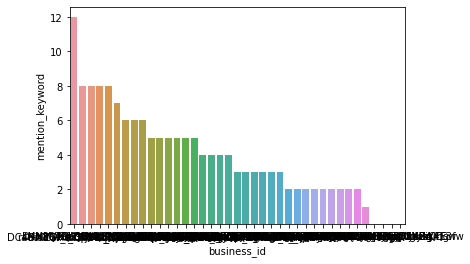

2297
4
148
148
(0.37216775628196913, 0.7097679513175448)
mention_keyword     0   1
stars                    
1                1201  56
2                 792  28
3                 779  23
4                 968  25
5                 934  20
Panda Express
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.0025695898344005944, pvalue=0.8711802461238898)
                   review_id                 user_id             business_id  \
0     T_cL6Nk_W-H5bH0BwL57wQ  XOrq3ZorrmuakaWKQAKJ8w  q2cgYLHKRaujrQgSnqJPTA   
1     BzSmRmQTQhLkZrOStalnqw  XAlgPQYihaK-r3ZsKNYVcg  UKA2eeAZmO4ACB2J0kFISw   
2     rpeY-YMv4yfcAfM71f1N5w  4A1DHbi0g7agi53yzGUoYw  UKA2eeAZmO4ACB2J0kFISw   
3     WhB-_yrPorZl_wtYa5xY5w  yXynaFrGECLMJ9eOtBvojQ  q2cgYLHKRaujrQgSnqJPTA   
4     Koqp4Z9lNfcgrrHoKFjv0A  V2__oIIoNuhoPQZcbeoO9Q  UKA2eeAZmO4ACB2J0kFISw   
...                      ...                     ...                     ...   
3980  YPk_JudKP

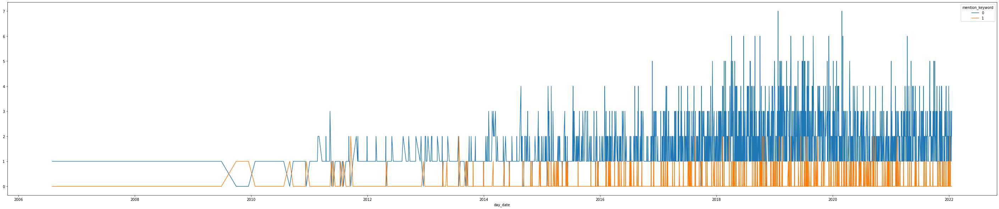

0.07352572145545797


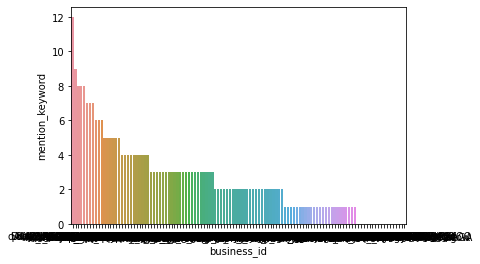

1779
21
271
271
(-0.10635076862362318, 0.9153040524149062)
mention_keyword     0    1
stars                     
1                1524  159
2                 597   43
3                 455   32
4                 525   40
5                 591   19
Boston Market
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.014014789430391224, pvalue=0.6307063089956991)
                   review_id                 user_id             business_id  \
0     xMCBJ_Z8dhmh14WI7ALHaQ  RJ8SKcctWjfQ36ZVs9QsPg  rW69-eTXD8zAC-DeI9qAcA   
1     k4SBEvpXNSv4YM7_vmqvNQ  flfHwNuaNHtGsD-eqF5I0w  rW69-eTXD8zAC-DeI9qAcA   
2     7JDQEUjYIPWX6sRMrcfpPw  XznTWp7IHLfeXGJ5aFNX4A  vm-t-lpS9rez56oVJqARRw   
3     17hNVIzyu3RfgDHXgjCYBQ  k87j8UOzbWxorBiMVoPM2w  vm-t-lpS9rez56oVJqARRw   
4     vEaS77WIWYoyl8rEMQGLKw  EfG0nInFMbiO9Hy7A6B2cQ  VravcZnsQskdqMp9dWS3pg   
...                      ...                     ...                     ...   
1174  Uv

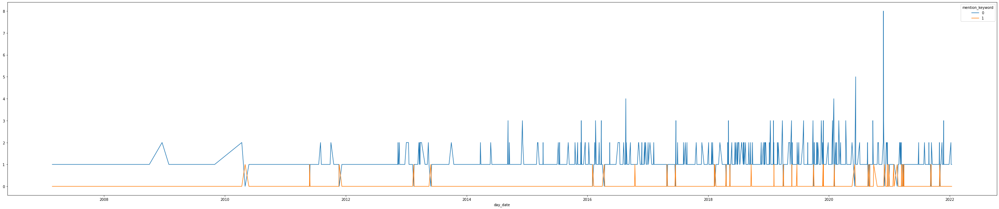

0.032230703986429174


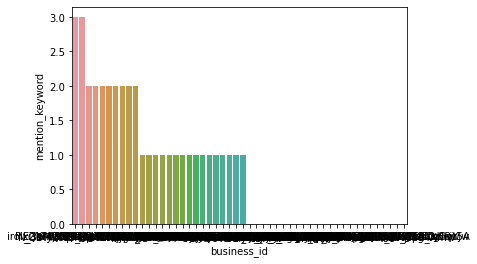

562
2
35
36
(-1.1983383215117651, 0.23078533357253073)
mention_keyword    0   1
stars                   
1                359  28
2                151   4
3                173   2
4                222   3
5                236   1
TGI Fridays
The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=-0.009703971102060187, pvalue=0.5529492589012758)
                   review_id                 user_id             business_id  \
0     5X50uni7TraQBetwrP36cA  w3SeGBY2fos2_7sLjSlAgQ  -kVGt2QRNtBoZMvKeIjVug   
1     hsutOHG9vAIqqNHZulQeDA  78ZImmzW07qqlelRfdvOkw  kB0jhYe17R7zobBUXfsP3g   
2     S89t2ExwlSGHnIIBXiuldg  vUiebV27kFKne70hRP-L4A  kB0jhYe17R7zobBUXfsP3g   
3     4mh0fW0TPnYuYQmhn1n55A  zKpzlDuCHawN2lMJkj8iyA  kB0jhYe17R7zobBUXfsP3g   
4     KZ8V7PcfhczsXIjd-IWmWQ  HDzZYxw0FxaINVVWEcQ1TA  _ci2Bsw_5go_-2cavIlbOQ   
...                      ...                     ...                     ...   
3736  h3-cVkcwliDnukN5YmGuL

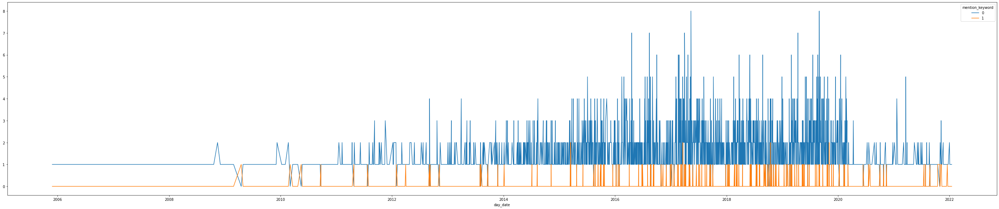

0.043036621224271585


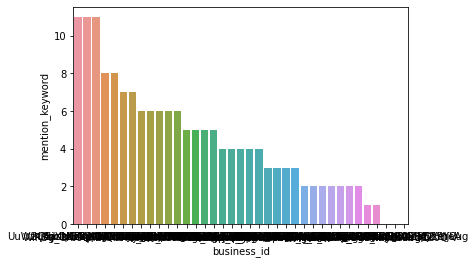

1751
6
155
154
(0.1705188770482296, 0.8646020900219722)
mention_keyword     0   1
stars                    
1                1710  89
2                 563  35
3                 435  22
4                 460  10
5                 412   5


In [46]:
for name in chain_name_list:
    print(name)
    name_reviews = chain_EDA(name)
    plt.show(plot_illness_series(name_reviews))
    percent_ill(name_reviews)
    illness_grouped(name_reviews)
    illness_random(name_reviews)
    
    print( pd.crosstab(name_reviews['stars'], name_reviews['mention_keyword']) )

The proportion with selected string:
1.0

The correlation between stars and illness is:
PointbiserialrResult(correlation=0.0020928077991429674, pvalue=0.8576597898842278)
                   review_id                 user_id             business_id  \
0     ilbEXGq_s0Cn8cMMUpxuMA  Jhdk8OjarHCjISYhRvJvTg  ZGErYinCaYR5UjTzovAZbw   
1     DF1juQCUsEjVHLB0WliotA  poOyZqXhbMoWyLN_jyynhA  yNlR9wTzd6Hg7It9fQrhdg   
2     LBzRWwm5OVNHeA8oduWLlQ  lrtGPAmDqCFnbfAKiB4NmA  ZGErYinCaYR5UjTzovAZbw   
3     LF6qW3Zf8cxZIgBK1bqbYg  hk6B1ZdzI62jMGo6e2IuuA  ZGErYinCaYR5UjTzovAZbw   
4     -kJqw8ptJ5ieoTVuHGdCLg  61nr50PqgF4WUWx4r-OcsQ  citzbW-2MVEZRNBqpVO-Jw   
...                      ...                     ...                     ...   
7342  7Kq7ldCL9i3_e4UzGKBF0g  ojR14O1TMa1EYYw5bkGDsQ  J-DcG4thLy_jbmQggUTrQQ   
7343  oP2P48c3ppu7cn0L3xj-uA  Do4aKR6upCBRUl0CUV0Xnw  4RH0A9i8L_Ak5JzxLRzykg   
7344  VlRqhj8_li7jpMjJarlKJg  U9yv_6C8aJmt0lFfBxfNHA  C-EtdzJSFHqlSSDcupZT9w   
7345  Z0gevXCe76F5roCzpxGnsg 

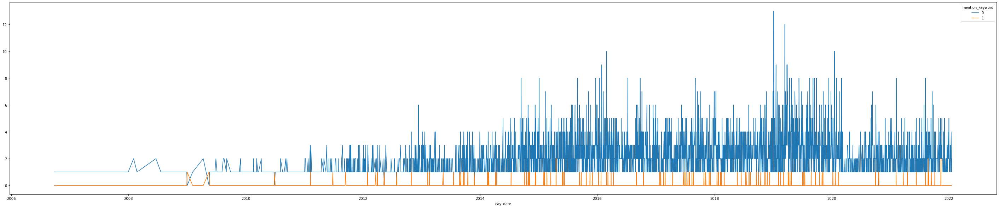

0.017558187015108206


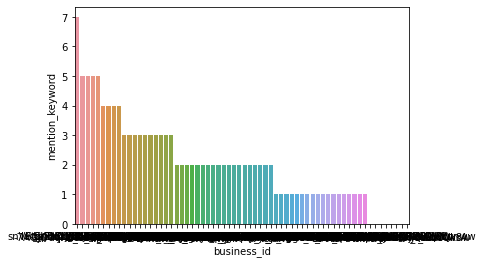

3580
3
126
126
(-0.4980478002141868, 0.6184503513828175)


In [47]:
buffalo_reviews = chain_EDA("Buffalo Wild Wings")
plt.show(plot_illness_series(buffalo_reviews))
percent_ill(buffalo_reviews)
illness_grouped(buffalo_reviews)
illness_random(buffalo_reviews)